In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils import data
import torchvision
from torchvision import transforms

import numpy as np
import matplotlib.pyplot as plt
import os
import glob
from PIL import Image
import itertools

In [2]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim
from skimage.measure import shannon_entropy         

In [3]:
torch.__version__

'1.13.1+cu117'

In [4]:
#获取测试数据路径
# train_irimgs_path = glob.glob('data/MSRS-main/train/ir/*.png')
# train_viimgs_path = glob.glob('data/MSRS-main/train/vi/*.png')
train_irimgs_path = glob.glob('data/TNO/ir/*.png')
train_viimgs_path = glob.glob('data/TNO/vi/*.png')
#获取测试数据路径
# test_irimgs_path = glob.glob('data/MSRS-main/test/ir/*.png')
# test_viimgs_path = glob.glob('data/MSRS-main/test/vi/*.png')

In [5]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((256,256)),
    transforms.Normalize(mean=0.5,std=0.5)
])

In [6]:
class FusionDataset(data.Dataset):
    def __init__(self,ir_path,vi_path):
        self.ir_path = train_irimgs_path
        self.vi_path = train_viimgs_path
    def __getitem__(self,idx):
        # 得到路径
        vi_path = self.vi_path[idx]
        ir_path = self.ir_path[idx]
        # 根据路径得到图片
        vi_img = Image.open(vi_path)
        ir_img = Image.open(ir_path) #ir红外读取为灰度秃了

        vi_img = transform(vi_img)
        ir_img = ir_img.convert('RGB')# 将灰度图转换为三通道再变化
        ir_img = transform(ir_img)
        return vi_img,ir_img
    def __len__(self):
        return len(self.ir_path)

In [7]:

train_ds = FusionDataset(train_irimgs_path,train_viimgs_path)
# test_ds = FusionDataset(test_irimgs_path,test_viimgs_path)             # 打印数据集大小

In [8]:
BATCHSIZE = 128
train_dl = data.DataLoader(dataset=train_ds,
                          batch_size=BATCHSIZE,
                          shuffle=True)

# test_dl = data.DataLoader(dataset=test_ds,
#                           batch_size=BATCHSIZE,
#                           shuffle=False)

In [9]:
ir_batch,vi_batch = next(iter(train_dl))

In [10]:
ir_batch.shape,vi_batch.shape

(torch.Size([42, 3, 256, 256]), torch.Size([42, 3, 256, 256]))

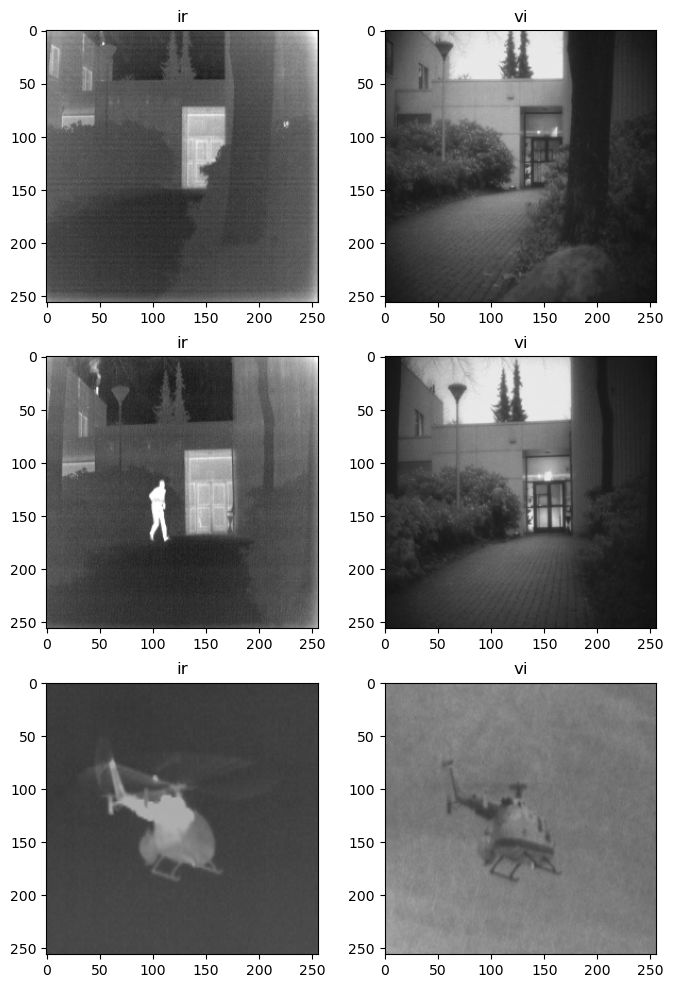

In [11]:
plt.figure(figsize = (8,12))
for i,(vi,ir) in enumerate(zip(ir_batch[:3],vi_batch[:3])):
    ir = (ir.permute(1,2,0).numpy()+1)/2
    vi = (vi.permute(1,2,0).numpy()+1)/2
    plt.subplot(3,2,2*i+1)
    plt.title('ir')
    plt.imshow(ir)

    plt.subplot(3,2,2*i+2)
    plt.title('vi')
    plt.imshow(vi)

创建模型

In [12]:
class Downsample(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Downsample, self).__init__()
        self.conv_relu = nn.Sequential(
                            nn.Conv2d(in_channels, out_channels, 
                                      kernel_size=3, stride=2, padding=1),
                            nn.LeakyReLU(inplace=True),
            )
        self.bn = nn.InstanceNorm2d(out_channels)
    def forward(self, x, is_bn=True):
        x = self.conv_relu(x)
        if is_bn:
            x = self.bn(x)
        return x

In [13]:
class Upsample(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Upsample, self).__init__()
        self.upconv_relu = nn.Sequential(
                               nn.ConvTranspose2d(in_channels, out_channels, 
                                                  kernel_size=3,
                                                  stride=2,
                                                  padding=1,
                                                  output_padding=1),
                               nn.LeakyReLU(inplace=True)
            )
        self.bn = nn.InstanceNorm2d(out_channels)
        
    def forward(self, x, is_drop=False):
        x = self.upconv_relu(x)
        x = self.bn(x)
        if is_drop:
            x = F.dropout2d(x)
        return x

In [14]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.down1 = Downsample(6, 64)
        self.down2 = Downsample(64, 128)
        self.down3 = Downsample(128, 256)
        self.down4 = Downsample(256, 512)
        self.down5 = Downsample(512, 512)
        self.down6 = Downsample(512, 512)
        
        self.up1 = Upsample(512, 512)
        self.up2 = Upsample(1024, 512)
        self.up3 = Upsample(1024, 256)
        self.up4 = Upsample(512, 128)
        self.up5 = Upsample(256, 64)

        self.last = nn.ConvTranspose2d(128, 3, 
                                       kernel_size=3,
                                       stride=2,
                                       padding=1,
                                       output_padding=1)
        

    def forward(self, x1,x2):
        x = torch.cat([x1,x2],axis = 1)
        x1 = self.down1(x, is_bn=False)   # torch.Size([8, 64, 128, 128])
        x2 = self.down2(x1)               # torch.Size([8, 128, 64, 64])
        x3 = self.down3(x2)               # torch.Size([8, 256, 32, 32])
        x4 = self.down4(x3)               # torch.Size([8, 512, 16, 16])
        x5 = self.down5(x4)               # torch.Size([8, 512, 8, 8])
        x6 = self.down6(x5)               # torch.Size([8, 512, 4, 4])
        
        x6 = self.up1(x6, is_drop=True)   # torch.Size([8, 512, 8, 8])
        x6 = torch.cat([x5, x6], dim=1)   # torch.Size([8, 1024, 8, 8])
        
        x6 = self.up2(x6, is_drop=True)   # torch.Size([8, 512, 16, 16])
        x6 = torch.cat([x4, x6], dim=1)   # torch.Size([8, 1024, 16, 16])
        
        x6 = self.up3(x6, is_drop=True)                         
        x6 = torch.cat([x3, x6], dim=1)          
        
        x6 = self.up4(x6)                       
        x6 = torch.cat([x2, x6], dim=1)         
        
        x6 = self.up5(x6)                        
        x6 = torch.cat([x1, x6], dim=1)         
        
        x6 = torch.tanh(self.last(x6))           
        return x6

In [15]:
# # 定义判别器
# class Discriminator(nn.Module):
#     def __init__(self):
#         super(Discriminator, self).__init__()
#         self.down1 = Downsample(3, 64)             # 128
#         self.down2 = Downsample(64, 128)           # 64
#         self.last = nn.Conv2d(128, 1, 3)

#     def forward(self, img):
#         x = self.down1(img)
#         x = self.down2(x)
#         x = torch.sigmoid(self.last(x))
#         return x
class Discriminator(nn.Module):
    # ir + vi concat
    def __init__(self):
        super(Discriminator,self).__init__()
        self.down1 = Downsample(3,64)
        self.down2 = Downsample(64,128)
        self.conv1 = nn.Conv2d(128,256,3)
        self.bn = nn.BatchNorm2d(256)
        self.last = nn.Conv2d(256,1,3)
    def forward(self,vi,ir):
        # x = torch.cat([ir,vi],axis = 1)
        x = vi
        x = self.down1(x,is_bn=False)
        x = self.down2(x,is_bn=False)
        x = F.dropout2d(self.bn(F.leaky_relu(self.conv1(x))))
        x = torch.sigmoid(self.last(x))
        return x

In [16]:
device = "cuda" if torch.cuda.is_available() else "cpu"
gen_AB = Generator().to(device)
gen_BA = Generator().to(device)
dis_A = Discriminator().to(device)
dis_B = Discriminator().to(device)

gen_AB = nn.DataParallel(gen_AB)
gen_BA = nn.DataParallel(gen_BA)  
dis_A = nn.DataParallel(dis_A)  
dis_B = nn.DataParallel(dis_B)  

bceloss_fn = torch.nn.BCELoss()                   # 定义损失函数
l1loss_fn = torch.nn.L1Loss()

gen_optimizer = torch.optim.Adam(itertools.chain(gen_AB.parameters(), gen_BA.parameters()), 
                                 lr=2e-4, betas=(0.5, 0.999))
dis_A_optimizer = torch.optim.Adam(dis_A.parameters(), 
                                   lr=2e-4, betas=(0.5, 0.999))
dis_B_optimizer = torch.optim.Adam(dis_B.parameters(),
                                   lr=2e-4, betas=(0.5, 0.999))

In [17]:
def calculate_metrics(vi, ir,fusion):
    # Information Entropy (EN)
    def calculate_entropy(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        entropy_value = shannon_entropy(img_gray)
        return entropy_value

    # Standard Deviation (SD)
    def calculate_sd(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        sd_value = np.std(img_gray)
        return sd_value

    # Structural Similarity Index (SSIM)
    def calculate_ssim(vi, ir ,fusion):
        img1_gray = cv2.cvtColor(vi, cv2.COLOR_BGR2GRAY)
        img2_gray = cv2.cvtColor(ir, cv2.COLOR_BGR2GRAY)
        fusion_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        ssim_index_A, _ = ssim(img1_gray, fusion_gray, full=True)
        ssim_index_B, _ = ssim(img2_gray, fusion_gray, full=True)
        return (ssim_index_A + ssim_index_B)/2 

    

    # Correlation Coefficient (CC)
    def calculate_cc(vi, ir ,fusion):
        img1_flat = vi.flatten()
        img2_flat = ir.flatten()
        fusion_flat = fusion.flatten()
        
        correlation_coefficient_A = np.corrcoef(img1_flat, fusion_flat)[0, 1]
        correlation_coefficient_B = np.corrcoef(img2_flat, fusion_flat)[0, 1]
        
        return (correlation_coefficient_A + correlation_coefficient_B)/2

    # Spatial Frequency (SF)
    def calculate_sf(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        f = np.fft.fft2(img_gray)
        fshift = np.fft.fftshift(f)
        magnitude_spectrum = 20 * np.log(np.abs(fshift))
        spatial_frequency = np.sum(magnitude_spectrum) / img_gray.size
        return spatial_frequency

    # Variable Luminance Fusion Index (VLF)
    def calculate_vlf(vi, ir ,fusion):
        img1_gray = cv2.cvtColor(vi, cv2.COLOR_BGR2GRAY)
        img2_gray = cv2.cvtColor(ir, cv2.COLOR_BGR2GRAY)
        fusion_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        
        vlf_value_A = np.sum(np.abs(img1_gray - fusion_gray)) / img1_gray.size
        vlf_value_B = np.sum(np.abs(img2_gray - fusion_gray)) / img2_gray.size
        
        return (vlf_value_A + vlf_value_B)/2

    # Calculate metrics
    entropy_value = calculate_entropy(fusion)
    sd_value = calculate_sd(fusion)
    ssim_value = calculate_ssim(vi, ir,fusion)
    cc_value = calculate_cc(vi, ir,fusion)
    sf_value = calculate_sf(fusion)
    vlf_value = calculate_vlf(vi, ir,fusion)
    return {
        'Entropy': entropy_value,
        'Standard Deviation': sd_value,
        'SSIM': ssim_value,
        'Correlation Coefficient': cc_value,
        'Spatial Frequency': sf_value,
        'Variable Luminance Fusion Index': vlf_value
    }

In [18]:
def genarate_images(model,ir,vi):

    prediction = model(vi,ir).permute(0,2,3,1).detach().cpu().numpy()
    ir = ir.permute(0,2,3,1).cpu().numpy()
    vi = vi.permute(0,2,3,1).cpu().numpy()
    plt.figure(figsize=(10,10))
    display_list = [ir[0],vi[0],prediction[0]]
    fusion_result = calculate_metrics(vi[0], ir[0],prediction[0])
    print(fusion_result)
    title = ['ir','vi','fusion']
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(title[i])
        plt.imshow(display_list[i]*0.5+0.5)
        plt.axis('off')
    plt.show()
    return fusion_result

Epoch: 0 D_epoch_loss: 1.5664758682250977 G_epoch_loss: 4.242734909057617
{'Entropy': 15.998809814453127, 'Standard Deviation': 0.4147775, 'SSIM': -0.005248803638552119, 'Correlation Coefficient': 0.020642406219245908, 'Spatial Frequency': 83.72879317472498, 'Variable Luminance Fusion Index': 0.4845340698957443}


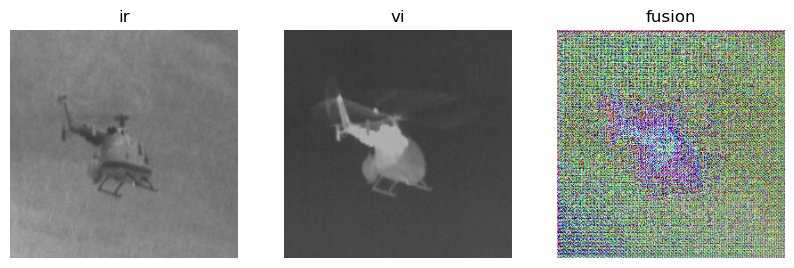

Epoch: 1 D_epoch_loss: 1.4502294063568115 G_epoch_loss: 4.04838228225708
Epoch: 2 D_epoch_loss: 1.4723724126815796 G_epoch_loss: 3.9109578132629395
Epoch: 3 D_epoch_loss: 1.4722838401794434 G_epoch_loss: 3.8020877838134766
Epoch: 4 D_epoch_loss: 1.4727617502212524 G_epoch_loss: 3.683349609375
Epoch: 5 D_epoch_loss: 1.483130931854248 G_epoch_loss: 3.529099941253662
Epoch: 6 D_epoch_loss: 1.4377021789550781 G_epoch_loss: 3.4249327182769775
Epoch: 7 D_epoch_loss: 1.4429082870483398 G_epoch_loss: 3.3057024478912354
Epoch: 8 D_epoch_loss: 1.4567989110946655 G_epoch_loss: 3.2258846759796143
Epoch: 9 D_epoch_loss: 1.4343096017837524 G_epoch_loss: 3.113508462905884
Epoch: 10 D_epoch_loss: 1.4042835235595703 G_epoch_loss: 3.021604537963867
Epoch: 11 D_epoch_loss: 1.4088966846466064 G_epoch_loss: 2.9972023963928223
Epoch: 12 D_epoch_loss: 1.4065676927566528 G_epoch_loss: 2.918222427368164
Epoch: 13 D_epoch_loss: 1.4178295135498047 G_epoch_loss: 2.8477368354797363
Epoch: 14 D_epoch_loss: 1.407301

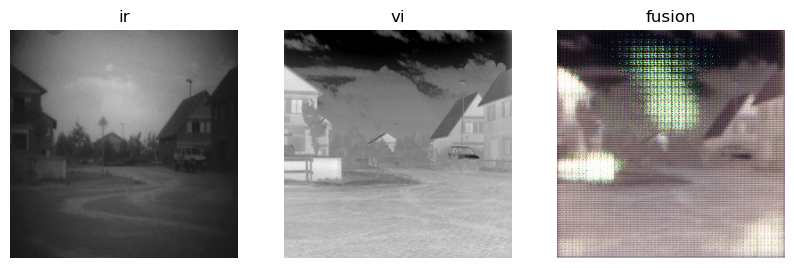

Epoch: 48 D_epoch_loss: 1.3681195974349976 G_epoch_loss: 2.105851411819458
Epoch: 49 D_epoch_loss: 1.3562915325164795 G_epoch_loss: 2.1144073009490967
Epoch: 50 D_epoch_loss: 1.3667080402374268 G_epoch_loss: 2.11141037940979
Epoch: 51 D_epoch_loss: 1.341386318206787 G_epoch_loss: 2.093829393386841
Epoch: 52 D_epoch_loss: 1.3575838804244995 G_epoch_loss: 2.058988332748413
Epoch: 53 D_epoch_loss: 1.3387508392333984 G_epoch_loss: 2.0761866569519043
Epoch: 54 D_epoch_loss: 1.351151704788208 G_epoch_loss: 2.0649962425231934
Epoch: 55 D_epoch_loss: 1.3581318855285645 G_epoch_loss: 2.0399253368377686
Epoch: 56 D_epoch_loss: 1.3374437093734741 G_epoch_loss: 2.0368285179138184
Epoch: 57 D_epoch_loss: 1.3614550828933716 G_epoch_loss: 2.0141985416412354
Epoch: 58 D_epoch_loss: 1.3532512187957764 G_epoch_loss: 2.023306369781494
Epoch: 59 D_epoch_loss: 1.340383529663086 G_epoch_loss: 2.0093212127685547
Epoch: 60 D_epoch_loss: 1.3439314365386963 G_epoch_loss: 2.009464979171753
Epoch: 61 D_epoch_loss

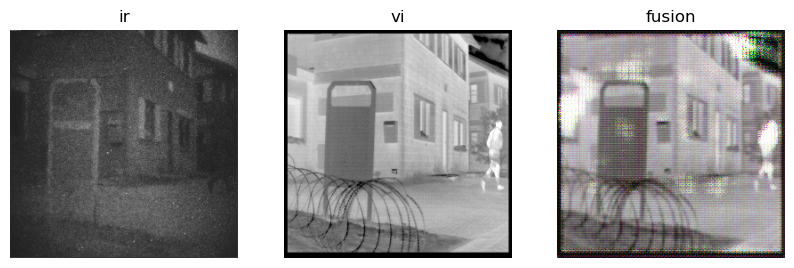

Epoch: 95 D_epoch_loss: 1.3174763917922974 G_epoch_loss: 1.8242875337600708
Epoch: 96 D_epoch_loss: 1.3099403381347656 G_epoch_loss: 1.721557378768921
Epoch: 97 D_epoch_loss: 1.3006547689437866 G_epoch_loss: 1.7632783651351929
Epoch: 98 D_epoch_loss: 1.3138868808746338 G_epoch_loss: 1.7502509355545044
Epoch: 99 D_epoch_loss: 1.301598072052002 G_epoch_loss: 1.7390034198760986
Epoch: 100 D_epoch_loss: 1.3021079301834106 G_epoch_loss: 1.7308474779129028
Epoch: 101 D_epoch_loss: 1.3000733852386475 G_epoch_loss: 1.731286883354187
Epoch: 102 D_epoch_loss: 1.2942053079605103 G_epoch_loss: 1.7134168148040771
Epoch: 103 D_epoch_loss: 1.2970964908599854 G_epoch_loss: 1.7460875511169434
Epoch: 104 D_epoch_loss: 1.3229153156280518 G_epoch_loss: 1.7541273832321167
Epoch: 105 D_epoch_loss: 1.2979769706726074 G_epoch_loss: 1.6975563764572144
Epoch: 106 D_epoch_loss: 1.2993419170379639 G_epoch_loss: 1.6955541372299194
Epoch: 107 D_epoch_loss: 1.281095266342163 G_epoch_loss: 1.7031137943267822
Epoch: 1

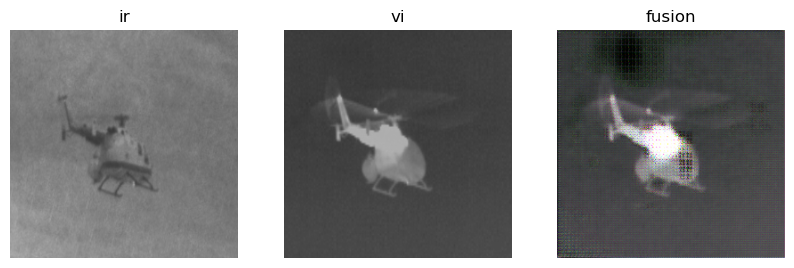

Epoch: 142 D_epoch_loss: 1.263157606124878 G_epoch_loss: 1.61087965965271
Epoch: 143 D_epoch_loss: 1.2640514373779297 G_epoch_loss: 1.5654047727584839
Epoch: 144 D_epoch_loss: 1.2962102890014648 G_epoch_loss: 1.6692838668823242
Epoch: 145 D_epoch_loss: 1.295333743095398 G_epoch_loss: 1.5661745071411133
Epoch: 146 D_epoch_loss: 1.283125400543213 G_epoch_loss: 1.6164586544036865
Epoch: 147 D_epoch_loss: 1.268660545349121 G_epoch_loss: 1.5794588327407837
Epoch: 148 D_epoch_loss: 1.2817574739456177 G_epoch_loss: 1.591265082359314
Epoch: 149 D_epoch_loss: 1.2881578207015991 G_epoch_loss: 1.631908655166626
Epoch: 150 D_epoch_loss: 1.3159894943237305 G_epoch_loss: 1.5434916019439697
Epoch: 151 D_epoch_loss: 1.318471908569336 G_epoch_loss: 1.6095266342163086
Epoch: 152 D_epoch_loss: 1.3028807640075684 G_epoch_loss: 1.6553540229797363
Epoch: 153 D_epoch_loss: 1.3079543113708496 G_epoch_loss: 1.5592175722122192
Epoch: 154 D_epoch_loss: 1.2801222801208496 G_epoch_loss: 1.6207538843154907
Epoch: 1

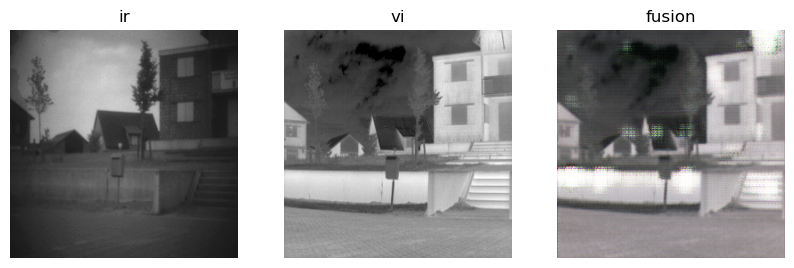

Epoch: 189 D_epoch_loss: 1.2738406658172607 G_epoch_loss: 1.4879502058029175
Epoch: 190 D_epoch_loss: 1.2980858087539673 G_epoch_loss: 1.5883976221084595
Epoch: 191 D_epoch_loss: 1.2825899124145508 G_epoch_loss: 1.4943395853042603
Epoch: 192 D_epoch_loss: 1.2589505910873413 G_epoch_loss: 1.632712960243225
Epoch: 193 D_epoch_loss: 1.2903248071670532 G_epoch_loss: 1.4609731435775757
Epoch: 194 D_epoch_loss: 1.2664008140563965 G_epoch_loss: 1.6121186017990112
Epoch: 195 D_epoch_loss: 1.2579938173294067 G_epoch_loss: 1.5896915197372437
Epoch: 196 D_epoch_loss: 1.277146577835083 G_epoch_loss: 1.4751522541046143
Epoch: 197 D_epoch_loss: 1.286860466003418 G_epoch_loss: 1.624380350112915
Epoch: 198 D_epoch_loss: 1.2535336017608643 G_epoch_loss: 1.4280052185058594
Epoch: 199 D_epoch_loss: 1.2547101974487305 G_epoch_loss: 1.6087539196014404
Epoch: 200 D_epoch_loss: 1.2620488405227661 G_epoch_loss: 1.4558442831039429
Epoch: 201 D_epoch_loss: 1.2821203470230103 G_epoch_loss: 1.5683705806732178
Epo

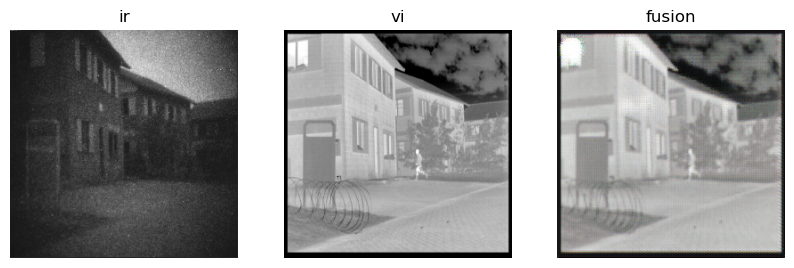

Epoch: 236 D_epoch_loss: 1.2214622497558594 G_epoch_loss: 1.4636216163635254
Epoch: 237 D_epoch_loss: 1.2336158752441406 G_epoch_loss: 1.5625759363174438
Epoch: 238 D_epoch_loss: 1.302882194519043 G_epoch_loss: 1.3838824033737183
Epoch: 239 D_epoch_loss: 1.2499935626983643 G_epoch_loss: 1.602634310722351
Epoch: 240 D_epoch_loss: 1.2182064056396484 G_epoch_loss: 1.4132307767868042
Epoch: 241 D_epoch_loss: 1.214972972869873 G_epoch_loss: 1.4685111045837402
Epoch: 242 D_epoch_loss: 1.206418752670288 G_epoch_loss: 1.4435410499572754
Epoch: 243 D_epoch_loss: 1.2251968383789062 G_epoch_loss: 1.5169579982757568
Epoch: 244 D_epoch_loss: 1.183680534362793 G_epoch_loss: 1.3890066146850586
Epoch: 245 D_epoch_loss: 1.2077622413635254 G_epoch_loss: 1.5189059972763062
Epoch: 246 D_epoch_loss: 1.2111413478851318 G_epoch_loss: 1.394365668296814
Epoch: 247 D_epoch_loss: 1.204289197921753 G_epoch_loss: 1.5574963092803955
Epoch: 248 D_epoch_loss: 1.2401080131530762 G_epoch_loss: 1.3432008028030396
Epoch:

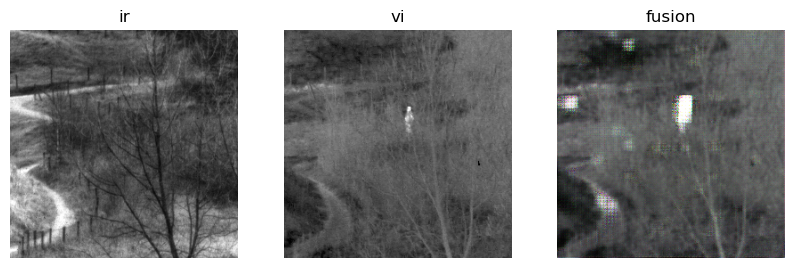

Epoch: 283 D_epoch_loss: 1.1583504676818848 G_epoch_loss: 1.4346741437911987
Epoch: 284 D_epoch_loss: 1.1369950771331787 G_epoch_loss: 1.328322172164917
Epoch: 285 D_epoch_loss: 1.1808958053588867 G_epoch_loss: 1.4747140407562256
Epoch: 286 D_epoch_loss: 1.172468900680542 G_epoch_loss: 1.278039813041687
Epoch: 287 D_epoch_loss: 1.1251174211502075 G_epoch_loss: 1.4596660137176514
Epoch: 288 D_epoch_loss: 1.169799566268921 G_epoch_loss: 1.2893688678741455
Epoch: 289 D_epoch_loss: 1.1112209558486938 G_epoch_loss: 1.3684967756271362
Epoch: 290 D_epoch_loss: 1.096372127532959 G_epoch_loss: 1.3342070579528809
Epoch: 291 D_epoch_loss: 1.0944468975067139 G_epoch_loss: 1.325085997581482
Epoch: 292 D_epoch_loss: 1.1045126914978027 G_epoch_loss: 1.3063467741012573
Epoch: 293 D_epoch_loss: 1.155470609664917 G_epoch_loss: 1.564020037651062
Epoch: 294 D_epoch_loss: 1.332507610321045 G_epoch_loss: 1.2273107767105103
Epoch: 295 D_epoch_loss: 1.2153418064117432 G_epoch_loss: 1.331583857536316
Epoch: 29

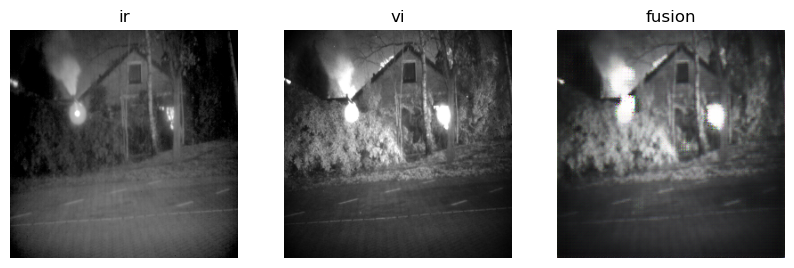

Epoch: 330 D_epoch_loss: 1.1110244989395142 G_epoch_loss: 1.281974196434021
Epoch: 331 D_epoch_loss: 1.1286718845367432 G_epoch_loss: 1.470746397972107
Epoch: 332 D_epoch_loss: 1.1805020570755005 G_epoch_loss: 1.2283319234848022
Epoch: 333 D_epoch_loss: 1.1286680698394775 G_epoch_loss: 1.401056170463562
Epoch: 334 D_epoch_loss: 1.0844346284866333 G_epoch_loss: 1.3046637773513794
Epoch: 335 D_epoch_loss: 1.1292312145233154 G_epoch_loss: 1.3252997398376465
Epoch: 336 D_epoch_loss: 1.0866667032241821 G_epoch_loss: 1.258417010307312
Epoch: 337 D_epoch_loss: 1.1302406787872314 G_epoch_loss: 1.4777182340621948
Epoch: 338 D_epoch_loss: 1.3157745599746704 G_epoch_loss: 1.222128987312317
Epoch: 339 D_epoch_loss: 1.120193600654602 G_epoch_loss: 1.3532344102859497
Epoch: 340 D_epoch_loss: 1.1001579761505127 G_epoch_loss: 1.3933238983154297
Epoch: 341 D_epoch_loss: 1.1032367944717407 G_epoch_loss: 1.249455451965332
Epoch: 342 D_epoch_loss: 1.1344462633132935 G_epoch_loss: 1.506902813911438
Epoch: 

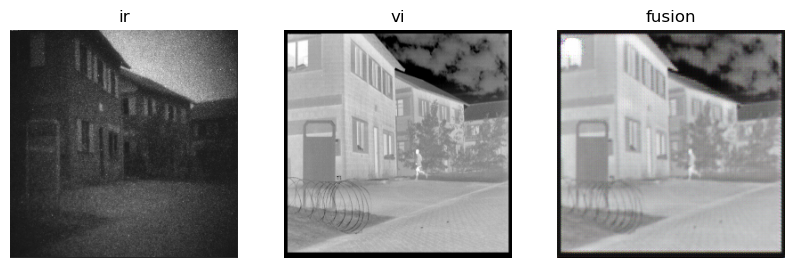

Epoch: 377 D_epoch_loss: 1.0618221759796143 G_epoch_loss: 1.204485535621643
Epoch: 378 D_epoch_loss: 1.1462247371673584 G_epoch_loss: 1.560502529144287
Epoch: 379 D_epoch_loss: 1.3652708530426025 G_epoch_loss: 1.1187238693237305
Epoch: 380 D_epoch_loss: 1.1487058401107788 G_epoch_loss: 1.2259191274642944
Epoch: 381 D_epoch_loss: 1.0966569185256958 G_epoch_loss: 1.4736278057098389
Epoch: 382 D_epoch_loss: 1.0374609231948853 G_epoch_loss: 1.2155110836029053
Epoch: 383 D_epoch_loss: 1.0535392761230469 G_epoch_loss: 1.2584158182144165
Epoch: 384 D_epoch_loss: 1.050262212753296 G_epoch_loss: 1.2845003604888916
Epoch: 385 D_epoch_loss: 1.0639781951904297 G_epoch_loss: 1.1711982488632202
Epoch: 386 D_epoch_loss: 1.1429203748703003 G_epoch_loss: 1.5353717803955078
Epoch: 387 D_epoch_loss: 1.22659432888031 G_epoch_loss: 1.0986144542694092
Epoch: 388 D_epoch_loss: 1.0818203687667847 G_epoch_loss: 1.3695348501205444
Epoch: 389 D_epoch_loss: 1.017615556716919 G_epoch_loss: 1.2656691074371338
Epoch

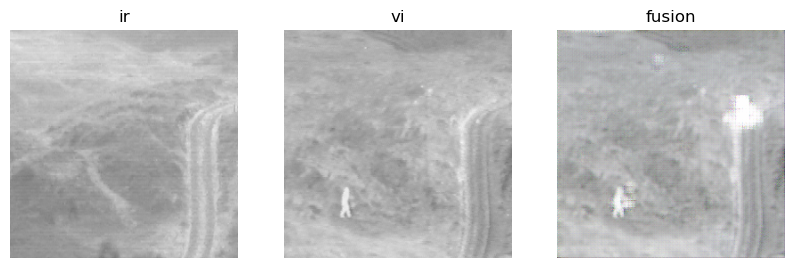

Epoch: 424 D_epoch_loss: 1.0106406211853027 G_epoch_loss: 1.358317494392395
Epoch: 425 D_epoch_loss: 1.0568238496780396 G_epoch_loss: 1.1352109909057617
Epoch: 426 D_epoch_loss: 1.0317339897155762 G_epoch_loss: 1.376715898513794
Epoch: 427 D_epoch_loss: 1.0112552642822266 G_epoch_loss: 1.0969849824905396
Epoch: 428 D_epoch_loss: 0.9934728145599365 G_epoch_loss: 1.4621179103851318
Epoch: 429 D_epoch_loss: 1.0546011924743652 G_epoch_loss: 1.0787971019744873
Epoch: 430 D_epoch_loss: 0.9861294031143188 G_epoch_loss: 1.2891898155212402
Epoch: 431 D_epoch_loss: 0.8972660303115845 G_epoch_loss: 1.1167829036712646
Epoch: 432 D_epoch_loss: 0.9282051920890808 G_epoch_loss: 1.124578833580017
Epoch: 433 D_epoch_loss: 0.8999390006065369 G_epoch_loss: 1.1614800691604614
Epoch: 434 D_epoch_loss: 0.9290675520896912 G_epoch_loss: 1.1487150192260742
Epoch: 435 D_epoch_loss: 0.9445106983184814 G_epoch_loss: 1.1799952983856201
Epoch: 436 D_epoch_loss: 0.9544873237609863 G_epoch_loss: 1.1419907808303833
Ep

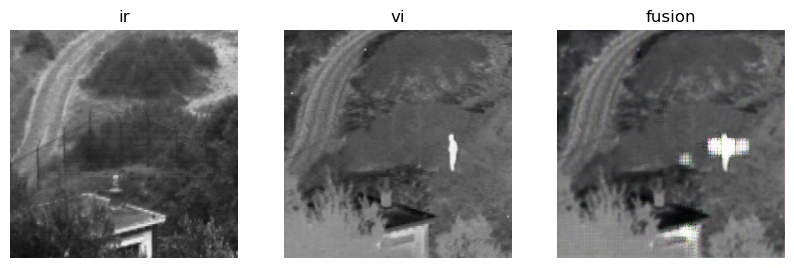

Epoch: 471 D_epoch_loss: 0.9296730160713196 G_epoch_loss: 1.1375635862350464
Epoch: 472 D_epoch_loss: 0.9529424905776978 G_epoch_loss: 1.2022089958190918
Epoch: 473 D_epoch_loss: 0.9418507814407349 G_epoch_loss: 1.049472451210022
Epoch: 474 D_epoch_loss: 0.8942170739173889 G_epoch_loss: 1.0996922254562378
Epoch: 475 D_epoch_loss: 0.9252210855484009 G_epoch_loss: 1.2320804595947266
Epoch: 476 D_epoch_loss: 0.9790159463882446 G_epoch_loss: 1.0381594896316528
Epoch: 477 D_epoch_loss: 0.9385021328926086 G_epoch_loss: 1.1717897653579712
Epoch: 478 D_epoch_loss: 1.0027854442596436 G_epoch_loss: 1.347233772277832
Epoch: 479 D_epoch_loss: 1.152605414390564 G_epoch_loss: 1.112141489982605
Epoch: 480 D_epoch_loss: 1.2122600078582764 G_epoch_loss: 1.7406041622161865
Epoch: 481 D_epoch_loss: 1.0104525089263916 G_epoch_loss: 1.112868309020996
Epoch: 482 D_epoch_loss: 0.9485692977905273 G_epoch_loss: 1.0703535079956055
Epoch: 483 D_epoch_loss: 0.9641232490539551 G_epoch_loss: 1.2832335233688354
Epoc

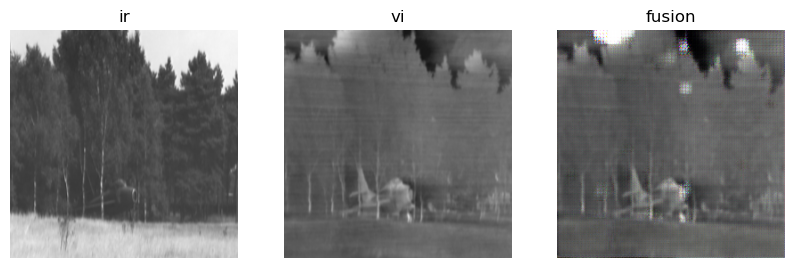

Epoch: 518 D_epoch_loss: 0.8798865079879761 G_epoch_loss: 1.108898401260376
Epoch: 519 D_epoch_loss: 0.9004455804824829 G_epoch_loss: 1.1094101667404175
Epoch: 520 D_epoch_loss: 0.9474185109138489 G_epoch_loss: 1.033967137336731
Epoch: 521 D_epoch_loss: 0.927186131477356 G_epoch_loss: 1.1790649890899658
Epoch: 522 D_epoch_loss: 0.9230244755744934 G_epoch_loss: 1.0387749671936035
Epoch: 523 D_epoch_loss: 0.873100757598877 G_epoch_loss: 1.110018253326416
Epoch: 524 D_epoch_loss: 0.8511067628860474 G_epoch_loss: 1.0558103322982788
Epoch: 525 D_epoch_loss: 0.8412922024726868 G_epoch_loss: 1.0847830772399902
Epoch: 526 D_epoch_loss: 0.8549199104309082 G_epoch_loss: 1.1314464807510376
Epoch: 527 D_epoch_loss: 0.8818291425704956 G_epoch_loss: 1.1000365018844604
Epoch: 528 D_epoch_loss: 0.9048608541488647 G_epoch_loss: 0.9998261332511902
Epoch: 529 D_epoch_loss: 0.9171751737594604 G_epoch_loss: 1.3300763368606567
Epoch: 530 D_epoch_loss: 1.10087251663208 G_epoch_loss: 0.9841268658638
Epoch: 53

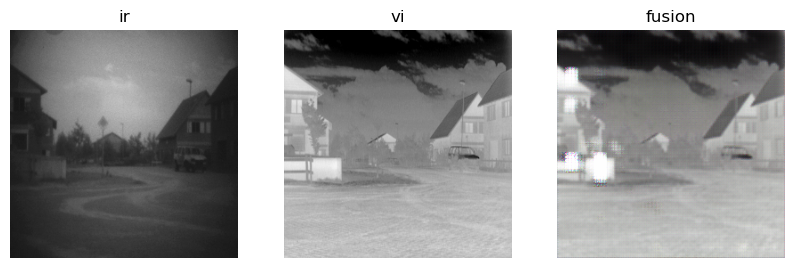

Epoch: 565 D_epoch_loss: 0.8368868827819824 G_epoch_loss: 0.981743335723877
Epoch: 566 D_epoch_loss: 0.8339338898658752 G_epoch_loss: 1.007413387298584
Epoch: 567 D_epoch_loss: 0.8546680808067322 G_epoch_loss: 0.9785052537918091
Epoch: 568 D_epoch_loss: 0.835993766784668 G_epoch_loss: 1.0651301145553589
Epoch: 569 D_epoch_loss: 0.8551900386810303 G_epoch_loss: 0.969546377658844
Epoch: 570 D_epoch_loss: 0.8548262119293213 G_epoch_loss: 1.068743348121643
Epoch: 571 D_epoch_loss: 0.8915646076202393 G_epoch_loss: 0.9593696594238281
Epoch: 572 D_epoch_loss: 0.8384902477264404 G_epoch_loss: 1.0455740690231323
Epoch: 573 D_epoch_loss: 0.8294278383255005 G_epoch_loss: 1.0146950483322144
Epoch: 574 D_epoch_loss: 0.8293401002883911 G_epoch_loss: 0.9959392547607422
Epoch: 575 D_epoch_loss: 0.818797767162323 G_epoch_loss: 1.0255327224731445
Epoch: 576 D_epoch_loss: 0.8287048935890198 G_epoch_loss: 1.0128446817398071
Epoch: 577 D_epoch_loss: 0.8348278403282166 G_epoch_loss: 1.0399105548858643
Epoch

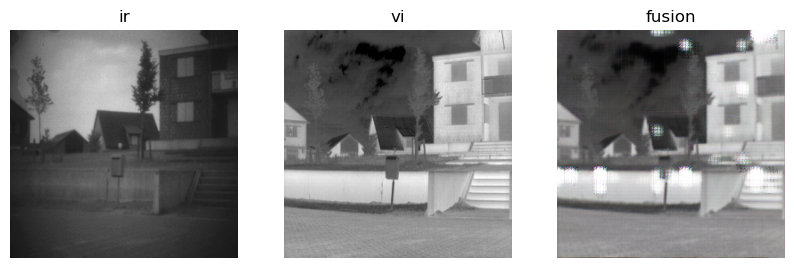

Epoch: 612 D_epoch_loss: 1.4183622598648071 G_epoch_loss: 1.8111109733581543
Epoch: 613 D_epoch_loss: 1.399153232574463 G_epoch_loss: 1.6209862232208252
Epoch: 614 D_epoch_loss: 1.2925828695297241 G_epoch_loss: 1.3237547874450684
Epoch: 615 D_epoch_loss: 1.2271534204483032 G_epoch_loss: 1.2897891998291016
Epoch: 616 D_epoch_loss: 1.1768033504486084 G_epoch_loss: 1.3268455266952515
Epoch: 617 D_epoch_loss: 1.121330976486206 G_epoch_loss: 1.3279893398284912
Epoch: 618 D_epoch_loss: 1.1458133459091187 G_epoch_loss: 1.1728309392929077
Epoch: 619 D_epoch_loss: 1.0485804080963135 G_epoch_loss: 1.3400286436080933
Epoch: 620 D_epoch_loss: 0.9382971525192261 G_epoch_loss: 1.128429651260376
Epoch: 621 D_epoch_loss: 0.9090245962142944 G_epoch_loss: 1.068993330001831
Epoch: 622 D_epoch_loss: 0.925754964351654 G_epoch_loss: 1.075251817703247
Epoch: 623 D_epoch_loss: 0.9386870861053467 G_epoch_loss: 1.159475564956665
Epoch: 624 D_epoch_loss: 0.9086872339248657 G_epoch_loss: 1.0636104345321655
Epoch:

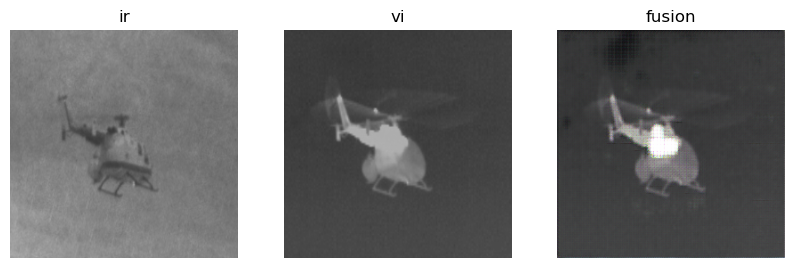

Epoch: 659 D_epoch_loss: 0.8033173084259033 G_epoch_loss: 1.2532092332839966
Epoch: 660 D_epoch_loss: 0.8761877417564392 G_epoch_loss: 0.9905358552932739
Epoch: 661 D_epoch_loss: 0.7974869608879089 G_epoch_loss: 1.0182533264160156
Epoch: 662 D_epoch_loss: 0.8077660799026489 G_epoch_loss: 1.2370717525482178
Epoch: 663 D_epoch_loss: 0.7770098447799683 G_epoch_loss: 1.0134975910186768
Epoch: 664 D_epoch_loss: 0.8023272156715393 G_epoch_loss: 0.9333111047744751
Epoch: 665 D_epoch_loss: 0.7405611872673035 G_epoch_loss: 1.0813003778457642
Epoch: 666 D_epoch_loss: 0.787284791469574 G_epoch_loss: 1.087098240852356
Epoch: 667 D_epoch_loss: 0.7822175025939941 G_epoch_loss: 0.9995408654212952
Epoch: 668 D_epoch_loss: 0.8358513116836548 G_epoch_loss: 1.2866976261138916
Epoch: 669 D_epoch_loss: 0.9981470108032227 G_epoch_loss: 0.9549925327301025
Epoch: 670 D_epoch_loss: 1.0620936155319214 G_epoch_loss: 1.3574057817459106
Epoch: 671 D_epoch_loss: 0.847949743270874 G_epoch_loss: 1.1108306646347046
Ep

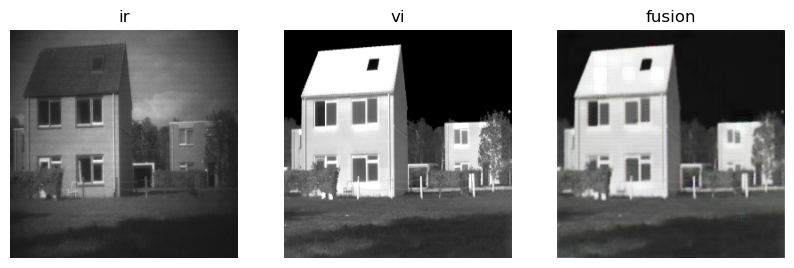

Epoch: 706 D_epoch_loss: 0.732284426689148 G_epoch_loss: 1.026026725769043
Epoch: 707 D_epoch_loss: 0.7220504879951477 G_epoch_loss: 1.0950162410736084
Epoch: 708 D_epoch_loss: 0.6831581592559814 G_epoch_loss: 1.1687110662460327
Epoch: 709 D_epoch_loss: 0.7237535715103149 G_epoch_loss: 0.9778381586074829
Epoch: 710 D_epoch_loss: 0.7186023592948914 G_epoch_loss: 1.2202262878417969
Epoch: 711 D_epoch_loss: 0.7530237436294556 G_epoch_loss: 0.9875190854072571
Epoch: 712 D_epoch_loss: 0.7270402908325195 G_epoch_loss: 1.1216423511505127
Epoch: 713 D_epoch_loss: 0.8198565244674683 G_epoch_loss: 1.0448739528656006
Epoch: 714 D_epoch_loss: 0.7333711385726929 G_epoch_loss: 1.1703487634658813
Epoch: 715 D_epoch_loss: 0.701460599899292 G_epoch_loss: 1.030964970588684
Epoch: 716 D_epoch_loss: 0.7329978346824646 G_epoch_loss: 0.9831819534301758
Epoch: 717 D_epoch_loss: 0.7508558630943298 G_epoch_loss: 1.0456966161727905
Epoch: 718 D_epoch_loss: 0.7081825733184814 G_epoch_loss: 0.9924999475479126
Epo

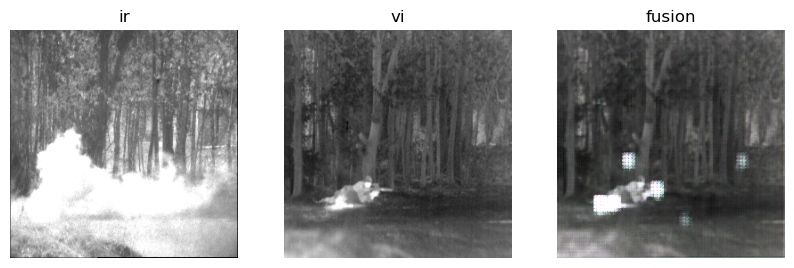

Epoch: 753 D_epoch_loss: 0.7325047850608826 G_epoch_loss: 1.1483204364776611
Epoch: 754 D_epoch_loss: 0.7065811157226562 G_epoch_loss: 0.9459251761436462
Epoch: 755 D_epoch_loss: 0.7452811002731323 G_epoch_loss: 1.0384631156921387
Epoch: 756 D_epoch_loss: 0.6702255606651306 G_epoch_loss: 1.1923359632492065
Epoch: 757 D_epoch_loss: 0.6596724390983582 G_epoch_loss: 1.0517300367355347
Epoch: 758 D_epoch_loss: 0.7476688623428345 G_epoch_loss: 0.9286006093025208
Epoch: 759 D_epoch_loss: 0.6519606113433838 G_epoch_loss: 1.0913012027740479
Epoch: 760 D_epoch_loss: 0.7226104736328125 G_epoch_loss: 1.193630576133728
Epoch: 761 D_epoch_loss: 0.6154572367668152 G_epoch_loss: 1.063431739807129
Epoch: 762 D_epoch_loss: 0.748809814453125 G_epoch_loss: 0.8541748523712158
Epoch: 763 D_epoch_loss: 0.7419111132621765 G_epoch_loss: 1.1248486042022705
Epoch: 764 D_epoch_loss: 0.6650745272636414 G_epoch_loss: 1.006970763206482
Epoch: 765 D_epoch_loss: 0.7594212889671326 G_epoch_loss: 0.9722367525100708
Epo

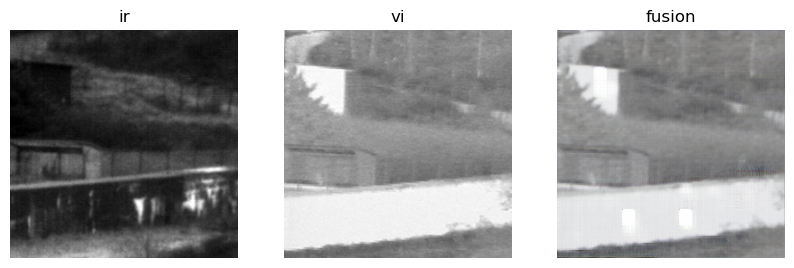

Epoch: 800 D_epoch_loss: 1.1863734722137451 G_epoch_loss: 0.9590727090835571
Epoch: 801 D_epoch_loss: 0.8781076669692993 G_epoch_loss: 1.2153770923614502
Epoch: 802 D_epoch_loss: 0.8879088163375854 G_epoch_loss: 1.476495623588562
Epoch: 803 D_epoch_loss: 0.7151090502738953 G_epoch_loss: 1.2718313932418823
Epoch: 804 D_epoch_loss: 0.8260195255279541 G_epoch_loss: 0.8590125441551208
Epoch: 805 D_epoch_loss: 0.6978400349617004 G_epoch_loss: 1.3077350854873657
Epoch: 806 D_epoch_loss: 0.6807574033737183 G_epoch_loss: 1.100098729133606
Epoch: 807 D_epoch_loss: 0.7427768111228943 G_epoch_loss: 1.0264935493469238
Epoch: 808 D_epoch_loss: 0.6965121030807495 G_epoch_loss: 1.3461253643035889
Epoch: 809 D_epoch_loss: 0.7163488268852234 G_epoch_loss: 0.9381784200668335
Epoch: 810 D_epoch_loss: 0.7313385605812073 G_epoch_loss: 1.0667513608932495
Epoch: 811 D_epoch_loss: 0.7377654910087585 G_epoch_loss: 1.0212440490722656
Epoch: 812 D_epoch_loss: 0.735937237739563 G_epoch_loss: 1.113601565361023
Epo

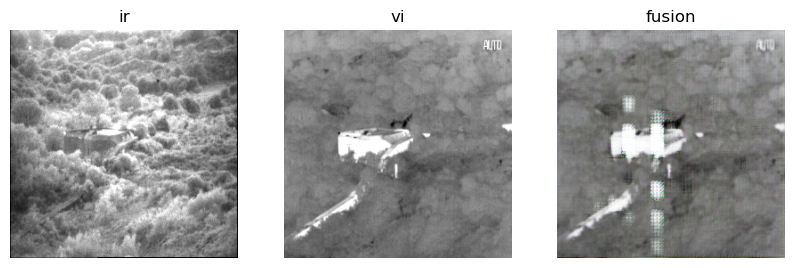

Epoch: 847 D_epoch_loss: 0.7045261263847351 G_epoch_loss: 1.1001336574554443
Epoch: 848 D_epoch_loss: 0.6515588760375977 G_epoch_loss: 1.0992529392242432
Epoch: 849 D_epoch_loss: 0.6613074541091919 G_epoch_loss: 1.0958646535873413
Epoch: 850 D_epoch_loss: 0.6599974036216736 G_epoch_loss: 1.0197709798812866
Epoch: 851 D_epoch_loss: 0.6325645446777344 G_epoch_loss: 1.204044222831726
Epoch: 852 D_epoch_loss: 0.5765296220779419 G_epoch_loss: 1.3019185066223145
Epoch: 853 D_epoch_loss: 0.6422971487045288 G_epoch_loss: 0.9772095084190369
Epoch: 854 D_epoch_loss: 0.5789898633956909 G_epoch_loss: 1.3081185817718506
Epoch: 855 D_epoch_loss: 0.6784000992774963 G_epoch_loss: 0.9120056629180908
Epoch: 856 D_epoch_loss: 0.9253988265991211 G_epoch_loss: 1.8653903007507324
Epoch: 857 D_epoch_loss: 0.6669309139251709 G_epoch_loss: 0.8908095359802246
Epoch: 858 D_epoch_loss: 0.6766897439956665 G_epoch_loss: 0.9491153955459595
Epoch: 859 D_epoch_loss: 0.7113853096961975 G_epoch_loss: 0.9867581129074097


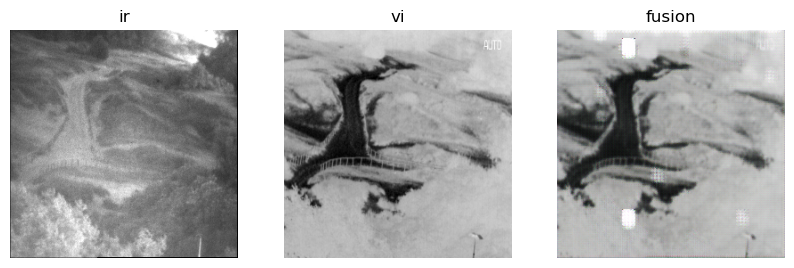

Epoch: 894 D_epoch_loss: 1.2115917205810547 G_epoch_loss: 1.0843430757522583
Epoch: 895 D_epoch_loss: 0.7781922817230225 G_epoch_loss: 1.3504014015197754
Epoch: 896 D_epoch_loss: 1.050025224685669 G_epoch_loss: 2.5409936904907227
Epoch: 897 D_epoch_loss: 0.6972198486328125 G_epoch_loss: 1.1468172073364258
Epoch: 898 D_epoch_loss: 1.0534933805465698 G_epoch_loss: 1.4215750694274902
Epoch: 899 D_epoch_loss: 0.9706096649169922 G_epoch_loss: 2.199472427368164
Epoch: 900 D_epoch_loss: 0.7422116994857788 G_epoch_loss: 1.3067762851715088
Epoch: 901 D_epoch_loss: 0.8649452328681946 G_epoch_loss: 1.5818674564361572
Epoch: 902 D_epoch_loss: 0.7236136794090271 G_epoch_loss: 0.9861857891082764
Epoch: 903 D_epoch_loss: 0.7691045999526978 G_epoch_loss: 1.1795048713684082
Epoch: 904 D_epoch_loss: 0.6669684052467346 G_epoch_loss: 1.0708954334259033
Epoch: 905 D_epoch_loss: 0.7580409049987793 G_epoch_loss: 0.9688643217086792
Epoch: 906 D_epoch_loss: 0.7486603260040283 G_epoch_loss: 0.9649370312690735
E

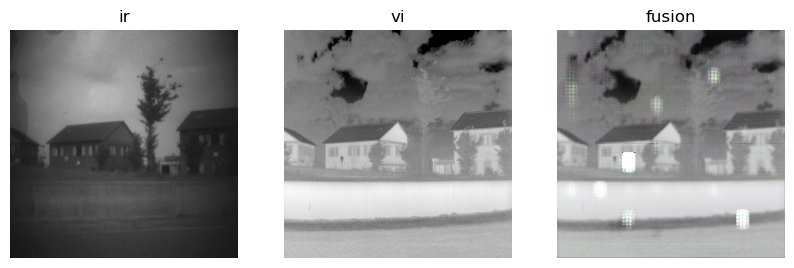

Epoch: 941 D_epoch_loss: 0.7473908066749573 G_epoch_loss: 1.0064589977264404
Epoch: 942 D_epoch_loss: 0.6934558153152466 G_epoch_loss: 1.0137147903442383
Epoch: 943 D_epoch_loss: 0.6624285578727722 G_epoch_loss: 1.472245216369629
Epoch: 944 D_epoch_loss: 0.651438295841217 G_epoch_loss: 0.9532415866851807
Epoch: 945 D_epoch_loss: 0.5167238712310791 G_epoch_loss: 1.7259007692337036
Epoch: 946 D_epoch_loss: 0.4443742334842682 G_epoch_loss: 1.4551165103912354
Epoch: 947 D_epoch_loss: 0.6409897804260254 G_epoch_loss: 0.902126669883728
Epoch: 948 D_epoch_loss: 0.5285650491714478 G_epoch_loss: 1.5799810886383057
Epoch: 949 D_epoch_loss: 0.5009915232658386 G_epoch_loss: 1.3060883283615112
Epoch: 950 D_epoch_loss: 0.542178213596344 G_epoch_loss: 1.3379030227661133
Epoch: 951 D_epoch_loss: 0.5555336475372314 G_epoch_loss: 1.0986968278884888
Epoch: 952 D_epoch_loss: 0.5734062194824219 G_epoch_loss: 1.5415692329406738
Epoch: 953 D_epoch_loss: 0.5479605793952942 G_epoch_loss: 1.189530611038208
Epoc

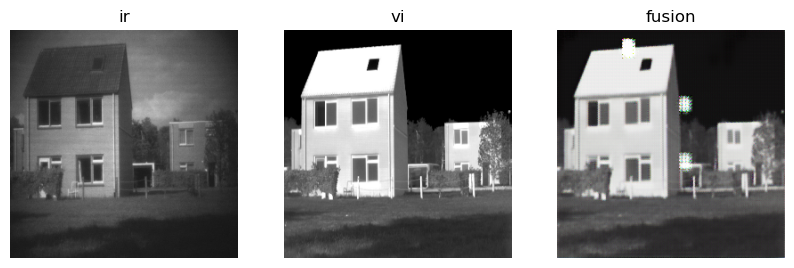

Epoch: 988 D_epoch_loss: 0.6075597405433655 G_epoch_loss: 1.087134599685669
Epoch: 989 D_epoch_loss: 0.5269777774810791 G_epoch_loss: 1.7289141416549683
Epoch: 990 D_epoch_loss: 0.451144278049469 G_epoch_loss: 1.4273182153701782
Epoch: 991 D_epoch_loss: 0.49401968717575073 G_epoch_loss: 1.2388917207717896
Epoch: 992 D_epoch_loss: 0.6256388425827026 G_epoch_loss: 0.9171236753463745
Epoch: 993 D_epoch_loss: 0.6168052554130554 G_epoch_loss: 1.1831083297729492
Epoch: 994 D_epoch_loss: 0.7011004686355591 G_epoch_loss: 1.1747987270355225
Epoch: 995 D_epoch_loss: 0.6522209644317627 G_epoch_loss: 1.3114384412765503
Epoch: 996 D_epoch_loss: 0.479056715965271 G_epoch_loss: 1.244322419166565
Epoch: 997 D_epoch_loss: 0.6453073620796204 G_epoch_loss: 1.0965931415557861
Epoch: 998 D_epoch_loss: 0.5347102880477905 G_epoch_loss: 1.4112603664398193
Epoch: 999 D_epoch_loss: 0.525255024433136 G_epoch_loss: 1.5983290672302246
Epoch: 1000 D_epoch_loss: 0.5404751300811768 G_epoch_loss: 1.1521471738815308
Ep

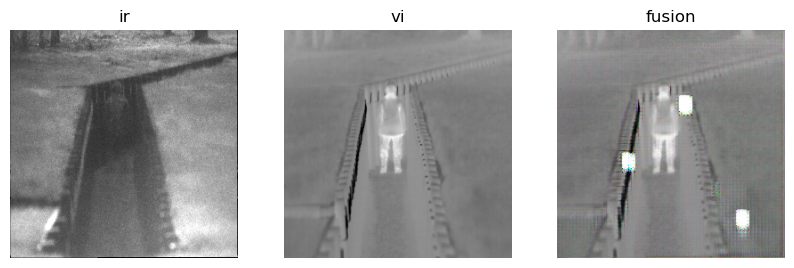

Epoch: 1035 D_epoch_loss: 0.7694289684295654 G_epoch_loss: 1.5021905899047852
Epoch: 1036 D_epoch_loss: 0.919563889503479 G_epoch_loss: 0.9913086295127869
Epoch: 1037 D_epoch_loss: 1.0117435455322266 G_epoch_loss: 2.232445240020752
Epoch: 1038 D_epoch_loss: 0.7878636121749878 G_epoch_loss: 1.5399349927902222
Epoch: 1039 D_epoch_loss: 0.8187228441238403 G_epoch_loss: 1.3626863956451416
Epoch: 1040 D_epoch_loss: 0.7881832718849182 G_epoch_loss: 2.2650928497314453
Epoch: 1041 D_epoch_loss: 0.8156283497810364 G_epoch_loss: 1.1464039087295532
Epoch: 1042 D_epoch_loss: 0.6401361227035522 G_epoch_loss: 2.016054630279541
Epoch: 1043 D_epoch_loss: 0.6082348823547363 G_epoch_loss: 1.6137959957122803
Epoch: 1044 D_epoch_loss: 0.773242712020874 G_epoch_loss: 1.0653831958770752
Epoch: 1045 D_epoch_loss: 0.7012169361114502 G_epoch_loss: 2.2597153186798096
Epoch: 1046 D_epoch_loss: 0.6659634709358215 G_epoch_loss: 1.3487250804901123
Epoch: 1047 D_epoch_loss: 0.6290488243103027 G_epoch_loss: 1.1655080

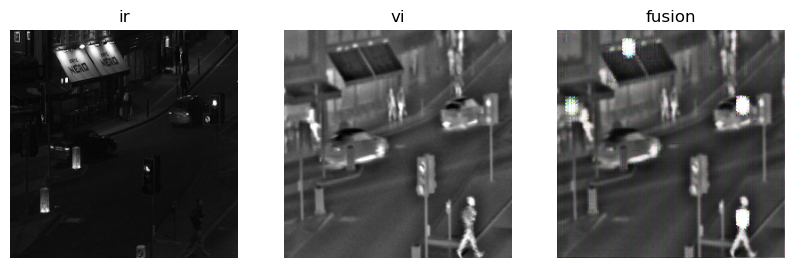

Epoch: 1082 D_epoch_loss: 0.5821161270141602 G_epoch_loss: 1.6383026838302612
Epoch: 1083 D_epoch_loss: 0.49159151315689087 G_epoch_loss: 1.4816471338272095
Epoch: 1084 D_epoch_loss: 0.4948575794696808 G_epoch_loss: 1.494384527206421
Epoch: 1085 D_epoch_loss: 0.5603989362716675 G_epoch_loss: 1.4243613481521606
Epoch: 1086 D_epoch_loss: 0.5215164422988892 G_epoch_loss: 1.9618438482284546
Epoch: 1087 D_epoch_loss: 0.49601539969444275 G_epoch_loss: 1.3510726690292358
Epoch: 1088 D_epoch_loss: 0.40904170274734497 G_epoch_loss: 2.064579725265503
Epoch: 1089 D_epoch_loss: 0.48622649908065796 G_epoch_loss: 1.268391489982605
Epoch: 1090 D_epoch_loss: 0.40396198630332947 G_epoch_loss: 2.1588029861450195
Epoch: 1091 D_epoch_loss: 0.36408665776252747 G_epoch_loss: 1.689324975013733
Epoch: 1092 D_epoch_loss: 0.40681689977645874 G_epoch_loss: 1.4967917203903198
Epoch: 1093 D_epoch_loss: 0.43177130818367004 G_epoch_loss: 1.3831226825714111
Epoch: 1094 D_epoch_loss: 0.4290500581264496 G_epoch_loss: 2

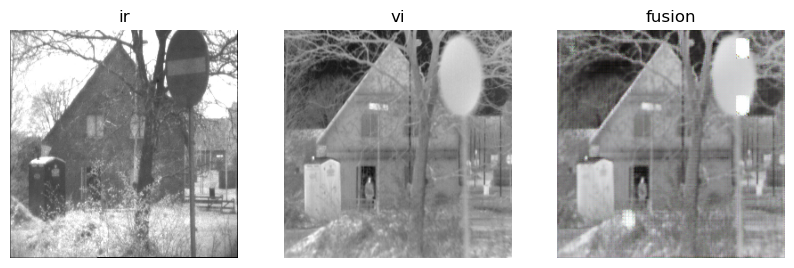

Epoch: 1129 D_epoch_loss: 0.49730852246284485 G_epoch_loss: 1.2716388702392578
Epoch: 1130 D_epoch_loss: 0.4283609390258789 G_epoch_loss: 1.5191826820373535
Epoch: 1131 D_epoch_loss: 0.6235941052436829 G_epoch_loss: 0.8854976892471313
Epoch: 1132 D_epoch_loss: 0.6189021468162537 G_epoch_loss: 1.5391374826431274
Epoch: 1133 D_epoch_loss: 0.5821263194084167 G_epoch_loss: 1.0502641201019287
Epoch: 1134 D_epoch_loss: 0.5728801488876343 G_epoch_loss: 2.2787952423095703
Epoch: 1135 D_epoch_loss: 0.694084644317627 G_epoch_loss: 0.7375208139419556
Epoch: 1136 D_epoch_loss: 0.4935813844203949 G_epoch_loss: 1.635127067565918
Epoch: 1137 D_epoch_loss: 0.5857428312301636 G_epoch_loss: 0.9933083653450012
Epoch: 1138 D_epoch_loss: 0.529564380645752 G_epoch_loss: 1.5558445453643799
Epoch: 1139 D_epoch_loss: 0.5700393915176392 G_epoch_loss: 1.100201964378357
Epoch: 1140 D_epoch_loss: 0.46265485882759094 G_epoch_loss: 1.7968188524246216
Epoch: 1141 D_epoch_loss: 0.42613685131073 G_epoch_loss: 1.6371139

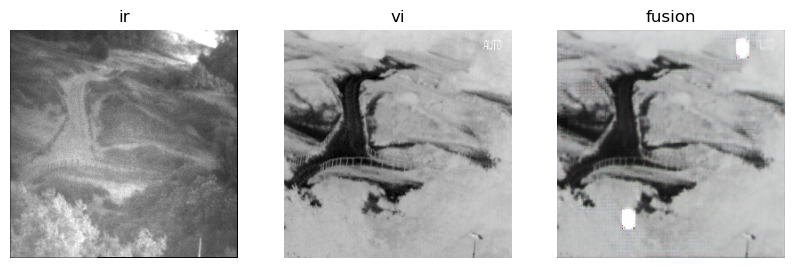

Epoch: 1176 D_epoch_loss: 0.47474199533462524 G_epoch_loss: 1.7438100576400757
Epoch: 1177 D_epoch_loss: 0.5819858312606812 G_epoch_loss: 1.2085413932800293
Epoch: 1178 D_epoch_loss: 0.5404530167579651 G_epoch_loss: 1.7669267654418945
Epoch: 1179 D_epoch_loss: 0.5455608367919922 G_epoch_loss: 1.3785187005996704
Epoch: 1180 D_epoch_loss: 0.5367289185523987 G_epoch_loss: 1.8606401681900024
Epoch: 1181 D_epoch_loss: 0.6854905486106873 G_epoch_loss: 1.0309932231903076
Epoch: 1182 D_epoch_loss: 0.6902140974998474 G_epoch_loss: 1.8811386823654175
Epoch: 1183 D_epoch_loss: 1.0446057319641113 G_epoch_loss: 2.5692741870880127
Epoch: 1184 D_epoch_loss: 1.9924203157424927 G_epoch_loss: 1.4093482494354248
Epoch: 1185 D_epoch_loss: 1.2807508707046509 G_epoch_loss: 1.88198721408844
Epoch: 1186 D_epoch_loss: 0.9384574294090271 G_epoch_loss: 2.0988903045654297
Epoch: 1187 D_epoch_loss: 0.8681716918945312 G_epoch_loss: 2.485092878341675
Epoch: 1188 D_epoch_loss: 0.8671959042549133 G_epoch_loss: 2.49548

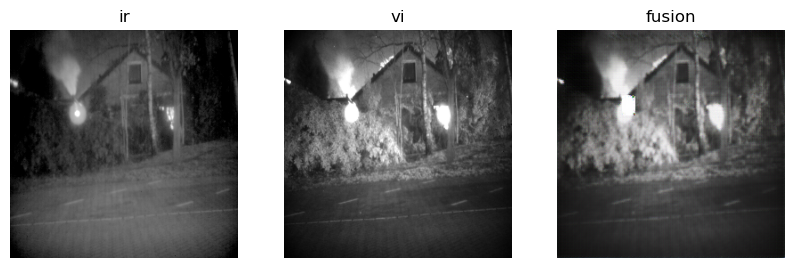

Epoch: 1223 D_epoch_loss: 1.619666337966919 G_epoch_loss: 1.942551612854004
Epoch: 1224 D_epoch_loss: 1.2463974952697754 G_epoch_loss: 0.9652099013328552
Epoch: 1225 D_epoch_loss: 1.3032855987548828 G_epoch_loss: 3.145292043685913
Epoch: 1226 D_epoch_loss: 1.1102759838104248 G_epoch_loss: 1.6776148080825806
Epoch: 1227 D_epoch_loss: 0.9408876895904541 G_epoch_loss: 2.1636476516723633
Epoch: 1228 D_epoch_loss: 1.0097498893737793 G_epoch_loss: 1.3839424848556519
Epoch: 1229 D_epoch_loss: 0.8955978751182556 G_epoch_loss: 3.1435868740081787
Epoch: 1230 D_epoch_loss: 0.85844886302948 G_epoch_loss: 1.44675874710083
Epoch: 1231 D_epoch_loss: 0.6848719120025635 G_epoch_loss: 2.5435245037078857
Epoch: 1232 D_epoch_loss: 0.6773457527160645 G_epoch_loss: 1.8184025287628174
Epoch: 1233 D_epoch_loss: 0.559309720993042 G_epoch_loss: 1.909456729888916
Epoch: 1234 D_epoch_loss: 0.561003565788269 G_epoch_loss: 1.8728653192520142
Epoch: 1235 D_epoch_loss: 0.45181143283843994 G_epoch_loss: 2.411028623580

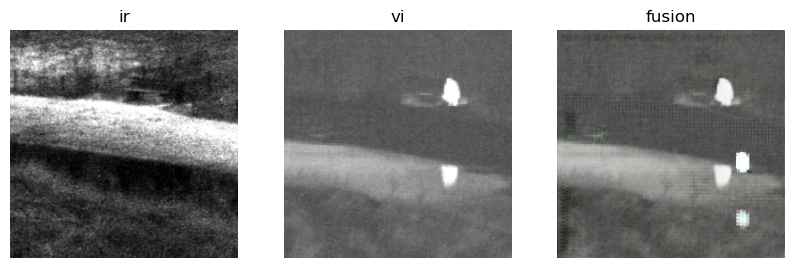

Epoch: 1270 D_epoch_loss: 0.6257085204124451 G_epoch_loss: 0.9145885109901428
Epoch: 1271 D_epoch_loss: 0.7648137211799622 G_epoch_loss: 2.5575435161590576
Epoch: 1272 D_epoch_loss: 0.35198432207107544 G_epoch_loss: 1.957095980644226
Epoch: 1273 D_epoch_loss: 0.7738787531852722 G_epoch_loss: 0.8139761686325073
Epoch: 1274 D_epoch_loss: 0.6167954802513123 G_epoch_loss: 1.0034809112548828
Epoch: 1275 D_epoch_loss: 0.5912071466445923 G_epoch_loss: 1.1350734233856201
Epoch: 1276 D_epoch_loss: 0.7428876161575317 G_epoch_loss: 1.3081079721450806
Epoch: 1277 D_epoch_loss: 0.48090434074401855 G_epoch_loss: 1.7094732522964478
Epoch: 1278 D_epoch_loss: 0.5886549353599548 G_epoch_loss: 1.0479239225387573
Epoch: 1279 D_epoch_loss: 0.509634792804718 G_epoch_loss: 1.8492344617843628
Epoch: 1280 D_epoch_loss: 0.5674979090690613 G_epoch_loss: 1.0639582872390747
Epoch: 1281 D_epoch_loss: 0.6376048922538757 G_epoch_loss: 1.007423996925354
Epoch: 1282 D_epoch_loss: 0.660417914390564 G_epoch_loss: 1.63716

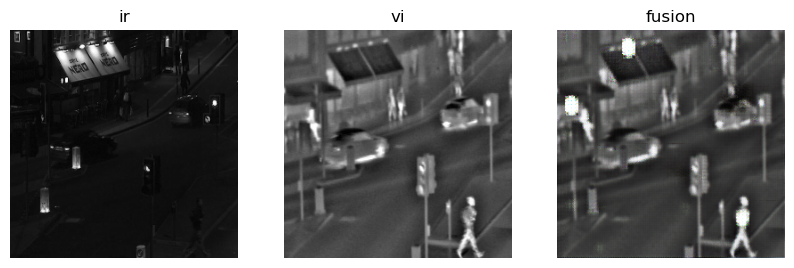

Epoch: 1317 D_epoch_loss: 0.561089813709259 G_epoch_loss: 1.034460425376892
Epoch: 1318 D_epoch_loss: 0.49807247519493103 G_epoch_loss: 1.2568501234054565
Epoch: 1319 D_epoch_loss: 0.5439995527267456 G_epoch_loss: 2.3531665802001953
Epoch: 1320 D_epoch_loss: 0.3586623966693878 G_epoch_loss: 1.4454646110534668
Epoch: 1321 D_epoch_loss: 0.5323691964149475 G_epoch_loss: 0.9754244089126587
Epoch: 1322 D_epoch_loss: 0.6685409545898438 G_epoch_loss: 0.9306762218475342
Epoch: 1323 D_epoch_loss: 0.5624353289604187 G_epoch_loss: 1.2704085111618042
Epoch: 1324 D_epoch_loss: 0.5834759473800659 G_epoch_loss: 1.3446382284164429
Epoch: 1325 D_epoch_loss: 0.4272843599319458 G_epoch_loss: 1.9941089153289795
Epoch: 1326 D_epoch_loss: 0.5626060962677002 G_epoch_loss: 0.9510614275932312
Epoch: 1327 D_epoch_loss: 0.5012798309326172 G_epoch_loss: 1.768631100654602
Epoch: 1328 D_epoch_loss: 1.5125142335891724 G_epoch_loss: 3.3468129634857178
Epoch: 1329 D_epoch_loss: 0.6661057472229004 G_epoch_loss: 1.03024

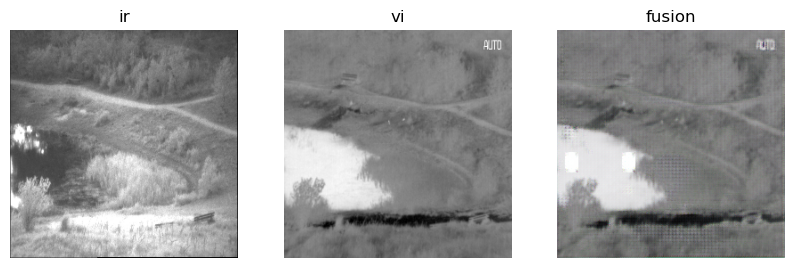

Epoch: 1364 D_epoch_loss: 0.39907047152519226 G_epoch_loss: 1.2938224077224731
Epoch: 1365 D_epoch_loss: 0.25903984904289246 G_epoch_loss: 2.4709458351135254
Epoch: 1366 D_epoch_loss: 0.372974693775177 G_epoch_loss: 1.4456415176391602
Epoch: 1367 D_epoch_loss: 0.36873582005500793 G_epoch_loss: 1.9325261116027832
Epoch: 1368 D_epoch_loss: 0.2106631100177765 G_epoch_loss: 2.7446846961975098
Epoch: 1369 D_epoch_loss: 0.3305016756057739 G_epoch_loss: 1.4687803983688354
Epoch: 1370 D_epoch_loss: 0.46947088837623596 G_epoch_loss: 2.6418960094451904
Epoch: 1371 D_epoch_loss: 0.33274737000465393 G_epoch_loss: 2.743284225463867
Epoch: 1372 D_epoch_loss: 0.4531550407409668 G_epoch_loss: 1.1993556022644043
Epoch: 1373 D_epoch_loss: 0.4988109767436981 G_epoch_loss: 1.4314898252487183
Epoch: 1374 D_epoch_loss: 0.3163553774356842 G_epoch_loss: 1.5867096185684204
Epoch: 1375 D_epoch_loss: 0.5529127717018127 G_epoch_loss: 0.9992753267288208
Epoch: 1376 D_epoch_loss: 0.4967847168445587 G_epoch_loss: 1.

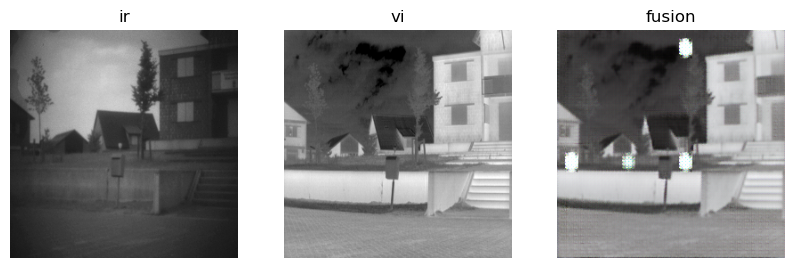

Epoch: 1411 D_epoch_loss: 0.3055543005466461 G_epoch_loss: 2.1729178428649902
Epoch: 1412 D_epoch_loss: 0.4510785639286041 G_epoch_loss: 1.2772849798202515
Epoch: 1413 D_epoch_loss: 0.4515041410923004 G_epoch_loss: 1.2561904191970825
Epoch: 1414 D_epoch_loss: 0.5412415862083435 G_epoch_loss: 1.1057592630386353
Epoch: 1415 D_epoch_loss: 0.5207223892211914 G_epoch_loss: 1.6592212915420532
Epoch: 1416 D_epoch_loss: 0.43160566687583923 G_epoch_loss: 2.5028553009033203
Epoch: 1417 D_epoch_loss: 0.998733639717102 G_epoch_loss: 1.0648388862609863
Epoch: 1418 D_epoch_loss: 1.1531639099121094 G_epoch_loss: 3.006817102432251
Epoch: 1419 D_epoch_loss: 0.5556778907775879 G_epoch_loss: 2.787454843521118
Epoch: 1420 D_epoch_loss: 0.5885590314865112 G_epoch_loss: 1.747542381286621
Epoch: 1421 D_epoch_loss: 0.6062332987785339 G_epoch_loss: 1.350986123085022
Epoch: 1422 D_epoch_loss: 0.823996901512146 G_epoch_loss: 2.057619333267212
Epoch: 1423 D_epoch_loss: 1.4734807014465332 G_epoch_loss: 2.534800529

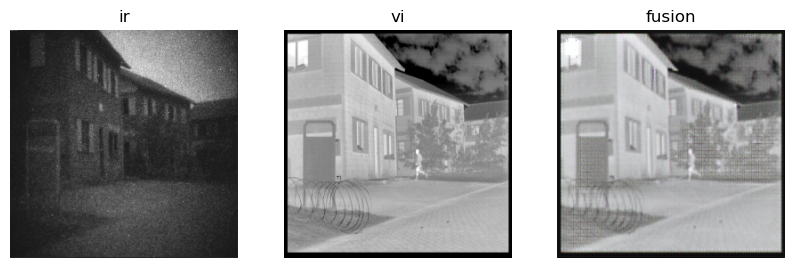

Epoch: 1458 D_epoch_loss: 0.9857116937637329 G_epoch_loss: 0.8069470524787903
Epoch: 1459 D_epoch_loss: 0.5532467365264893 G_epoch_loss: 1.331270456314087
Epoch: 1460 D_epoch_loss: 0.5517979860305786 G_epoch_loss: 1.1964993476867676
Epoch: 1461 D_epoch_loss: 0.6479678750038147 G_epoch_loss: 1.009764552116394
Epoch: 1462 D_epoch_loss: 0.7268033027648926 G_epoch_loss: 1.0929266214370728
Epoch: 1463 D_epoch_loss: 0.6055690050125122 G_epoch_loss: 1.1159886121749878
Epoch: 1464 D_epoch_loss: 0.48292505741119385 G_epoch_loss: 1.6585005521774292
Epoch: 1465 D_epoch_loss: 0.5267696976661682 G_epoch_loss: 1.279892921447754
Epoch: 1466 D_epoch_loss: 0.4460911452770233 G_epoch_loss: 1.9727205038070679
Epoch: 1467 D_epoch_loss: 0.5895622968673706 G_epoch_loss: 0.966891348361969
Epoch: 1468 D_epoch_loss: 0.5974946022033691 G_epoch_loss: 1.8851656913757324
Epoch: 1469 D_epoch_loss: 0.34252557158470154 G_epoch_loss: 2.9432787895202637
Epoch: 1470 D_epoch_loss: 0.34271109104156494 G_epoch_loss: 1.8289

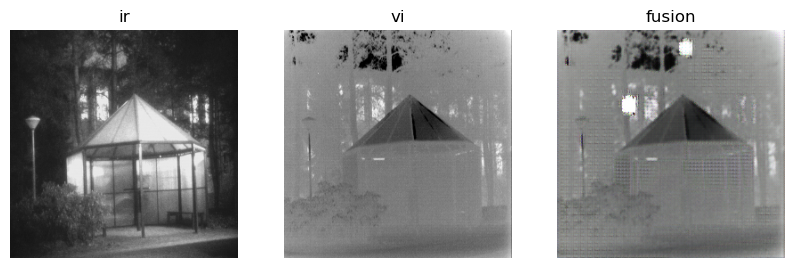

Epoch: 1505 D_epoch_loss: 0.3186239004135132 G_epoch_loss: 3.0494325160980225
Epoch: 1506 D_epoch_loss: 0.37659454345703125 G_epoch_loss: 1.7075906991958618
Epoch: 1507 D_epoch_loss: 0.6126755475997925 G_epoch_loss: 4.008618354797363
Epoch: 1508 D_epoch_loss: 0.5359886288642883 G_epoch_loss: 1.842275619506836
Epoch: 1509 D_epoch_loss: 0.47769930958747864 G_epoch_loss: 1.5340445041656494
Epoch: 1510 D_epoch_loss: 0.5899176597595215 G_epoch_loss: 1.0224504470825195
Epoch: 1511 D_epoch_loss: 0.5090932846069336 G_epoch_loss: 1.7699402570724487
Epoch: 1512 D_epoch_loss: 0.5517629384994507 G_epoch_loss: 2.0314948558807373
Epoch: 1513 D_epoch_loss: 0.581007719039917 G_epoch_loss: 1.2544901371002197
Epoch: 1514 D_epoch_loss: 0.49486488103866577 G_epoch_loss: 1.3741230964660645
Epoch: 1515 D_epoch_loss: 0.41199538111686707 G_epoch_loss: 2.4680397510528564
Epoch: 1516 D_epoch_loss: 0.44160908460617065 G_epoch_loss: 1.4919945001602173
Epoch: 1517 D_epoch_loss: 0.33242255449295044 G_epoch_loss: 1.

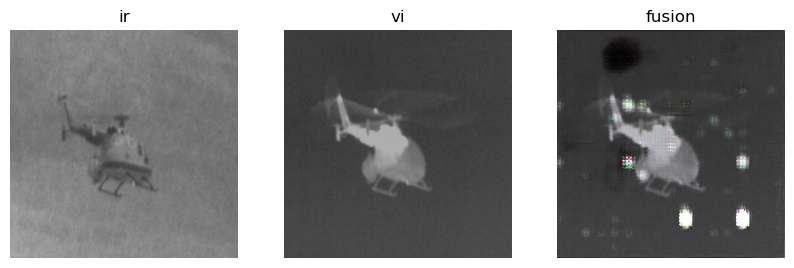

Epoch: 1552 D_epoch_loss: 0.6685525178909302 G_epoch_loss: 1.084615707397461
Epoch: 1553 D_epoch_loss: 0.7181657552719116 G_epoch_loss: 1.1382380723953247
Epoch: 1554 D_epoch_loss: 0.7146677374839783 G_epoch_loss: 2.199833631515503
Epoch: 1555 D_epoch_loss: 0.37206751108169556 G_epoch_loss: 2.205779552459717
Epoch: 1556 D_epoch_loss: 0.693120539188385 G_epoch_loss: 1.0843992233276367
Epoch: 1557 D_epoch_loss: 0.5912026166915894 G_epoch_loss: 1.6336390972137451
Epoch: 1558 D_epoch_loss: 0.5568059086799622 G_epoch_loss: 1.4979040622711182
Epoch: 1559 D_epoch_loss: 0.42566776275634766 G_epoch_loss: 2.4692554473876953
Epoch: 1560 D_epoch_loss: 0.33626788854599 G_epoch_loss: 2.1036899089813232
Epoch: 1561 D_epoch_loss: 0.5866055488586426 G_epoch_loss: 1.049822449684143
Epoch: 1562 D_epoch_loss: 0.701542317867279 G_epoch_loss: 2.6189239025115967
Epoch: 1563 D_epoch_loss: 0.5072391033172607 G_epoch_loss: 1.5950548648834229
Epoch: 1564 D_epoch_loss: 0.9174413084983826 G_epoch_loss: 1.080398082

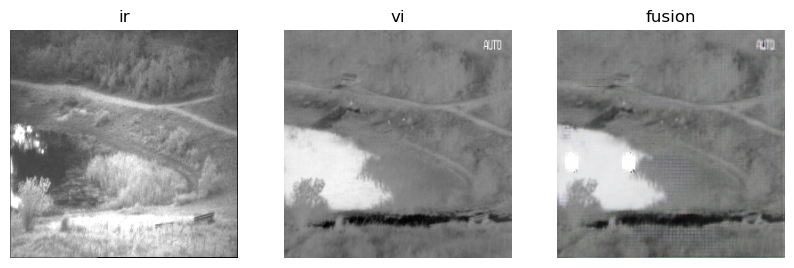

Epoch: 1599 D_epoch_loss: 0.41638389229774475 G_epoch_loss: 1.985932469367981
Epoch: 1600 D_epoch_loss: 0.2694588601589203 G_epoch_loss: 2.5503628253936768
Epoch: 1601 D_epoch_loss: 0.30548354983329773 G_epoch_loss: 1.9635956287384033
Epoch: 1602 D_epoch_loss: 0.3918156027793884 G_epoch_loss: 1.3102796077728271
Epoch: 1603 D_epoch_loss: 0.4950525462627411 G_epoch_loss: 1.1808770895004272
Epoch: 1604 D_epoch_loss: 0.46339699625968933 G_epoch_loss: 2.2957820892333984
Epoch: 1605 D_epoch_loss: 0.2760779857635498 G_epoch_loss: 3.0350685119628906
Epoch: 1606 D_epoch_loss: 0.3328809440135956 G_epoch_loss: 1.8663395643234253
Epoch: 1607 D_epoch_loss: 0.23848097026348114 G_epoch_loss: 2.569411516189575
Epoch: 1608 D_epoch_loss: 0.3713758587837219 G_epoch_loss: 1.4945178031921387
Epoch: 1609 D_epoch_loss: 0.2349300980567932 G_epoch_loss: 2.755389451980591
Epoch: 1610 D_epoch_loss: 0.2758188545703888 G_epoch_loss: 2.2896623611450195
Epoch: 1611 D_epoch_loss: 0.25139951705932617 G_epoch_loss: 2.2

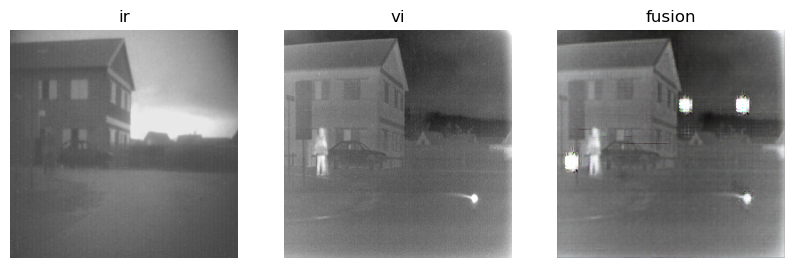

Epoch: 1646 D_epoch_loss: 0.4912520945072174 G_epoch_loss: 1.1792300939559937
Epoch: 1647 D_epoch_loss: 0.5535607933998108 G_epoch_loss: 1.427253246307373
Epoch: 1648 D_epoch_loss: 0.46206745505332947 G_epoch_loss: 2.7682695388793945
Epoch: 1649 D_epoch_loss: 0.3467863202095032 G_epoch_loss: 1.4568653106689453
Epoch: 1650 D_epoch_loss: 0.578924298286438 G_epoch_loss: 0.8915098309516907
Epoch: 1651 D_epoch_loss: 0.9094984531402588 G_epoch_loss: 1.2192713022232056
Epoch: 1652 D_epoch_loss: 0.47752976417541504 G_epoch_loss: 1.7149969339370728
Epoch: 1653 D_epoch_loss: 0.5383056402206421 G_epoch_loss: 1.2657687664031982
Epoch: 1654 D_epoch_loss: 0.5336687564849854 G_epoch_loss: 1.001246452331543
Epoch: 1655 D_epoch_loss: 0.6173689365386963 G_epoch_loss: 1.0165417194366455
Epoch: 1656 D_epoch_loss: 0.796811044216156 G_epoch_loss: 1.756717324256897
Epoch: 1657 D_epoch_loss: 0.3589286506175995 G_epoch_loss: 2.3614468574523926
Epoch: 1658 D_epoch_loss: 0.49628618359565735 G_epoch_loss: 1.16685

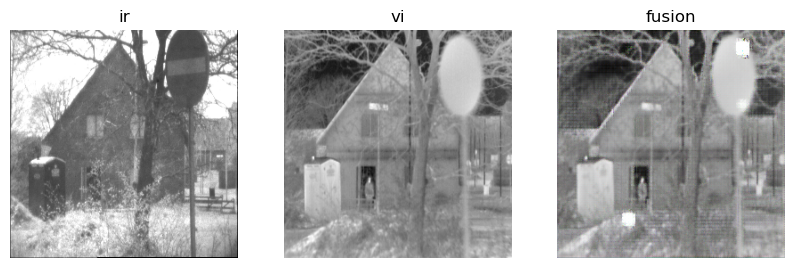

Epoch: 1693 D_epoch_loss: 0.21418672800064087 G_epoch_loss: 2.8103389739990234
Epoch: 1694 D_epoch_loss: 0.17171542346477509 G_epoch_loss: 2.9471797943115234
Epoch: 1695 D_epoch_loss: 0.2521817088127136 G_epoch_loss: 1.8980822563171387
Epoch: 1696 D_epoch_loss: 0.35676366090774536 G_epoch_loss: 1.4933242797851562
Epoch: 1697 D_epoch_loss: 0.47713717818260193 G_epoch_loss: 1.9986144304275513
Epoch: 1698 D_epoch_loss: 0.30706289410591125 G_epoch_loss: 1.9263936281204224
Epoch: 1699 D_epoch_loss: 0.2715887725353241 G_epoch_loss: 2.1768462657928467
Epoch: 1700 D_epoch_loss: 0.2551584243774414 G_epoch_loss: 1.9149384498596191
Epoch: 1701 D_epoch_loss: 0.3266439437866211 G_epoch_loss: 1.7659505605697632
Epoch: 1702 D_epoch_loss: 0.26657217741012573 G_epoch_loss: 2.2429840564727783
Epoch: 1703 D_epoch_loss: 0.36924925446510315 G_epoch_loss: 1.5412224531173706
Epoch: 1704 D_epoch_loss: 0.40603962540626526 G_epoch_loss: 3.7756845951080322
Epoch: 1705 D_epoch_loss: 0.20729264616966248 G_epoch_lo

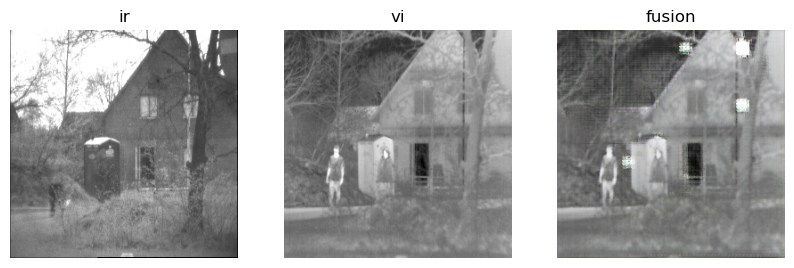

Epoch: 1740 D_epoch_loss: 0.8354990482330322 G_epoch_loss: 1.31174635887146
Epoch: 1741 D_epoch_loss: 0.2058289647102356 G_epoch_loss: 3.263507604598999
Epoch: 1742 D_epoch_loss: 0.20694516599178314 G_epoch_loss: 2.46291446685791
Epoch: 1743 D_epoch_loss: 0.6327216625213623 G_epoch_loss: 0.7907092571258545
Epoch: 1744 D_epoch_loss: 0.4336029291152954 G_epoch_loss: 1.5570993423461914
Epoch: 1745 D_epoch_loss: 0.5877558588981628 G_epoch_loss: 2.7247722148895264
Epoch: 1746 D_epoch_loss: 0.2973162829875946 G_epoch_loss: 2.27762508392334
Epoch: 1747 D_epoch_loss: 0.4760167598724365 G_epoch_loss: 1.253109335899353
Epoch: 1748 D_epoch_loss: 0.5347597599029541 G_epoch_loss: 0.9770353436470032
Epoch: 1749 D_epoch_loss: 0.5140619277954102 G_epoch_loss: 1.1880759000778198
Epoch: 1750 D_epoch_loss: 0.6502151489257812 G_epoch_loss: 1.6430470943450928
Epoch: 1751 D_epoch_loss: 0.4049445390701294 G_epoch_loss: 2.06551456451416
Epoch: 1752 D_epoch_loss: 0.3055828809738159 G_epoch_loss: 3.098792791366

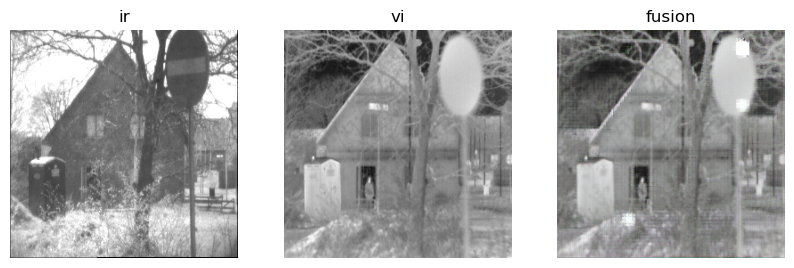

Epoch: 1787 D_epoch_loss: 0.261499285697937 G_epoch_loss: 2.8631057739257812
Epoch: 1788 D_epoch_loss: 0.2688814401626587 G_epoch_loss: 2.2326748371124268
Epoch: 1789 D_epoch_loss: 0.3051645755767822 G_epoch_loss: 1.7918606996536255
Epoch: 1790 D_epoch_loss: 0.32074883580207825 G_epoch_loss: 1.9262069463729858
Epoch: 1791 D_epoch_loss: 0.2962718904018402 G_epoch_loss: 2.066089153289795
Epoch: 1792 D_epoch_loss: 0.21735398471355438 G_epoch_loss: 3.727609395980835
Epoch: 1793 D_epoch_loss: 0.138792484998703 G_epoch_loss: 3.4897360801696777
Epoch: 1794 D_epoch_loss: 0.1622694432735443 G_epoch_loss: 2.869568109512329
Epoch: 1795 D_epoch_loss: 0.33357247710227966 G_epoch_loss: 1.4751570224761963
Epoch: 1796 D_epoch_loss: 0.30019068717956543 G_epoch_loss: 1.8483878374099731
Epoch: 1797 D_epoch_loss: 0.39870738983154297 G_epoch_loss: 1.5076520442962646
Epoch: 1798 D_epoch_loss: 0.44221872091293335 G_epoch_loss: 3.5621962547302246
Epoch: 1799 D_epoch_loss: 0.32016539573669434 G_epoch_loss: 1.6

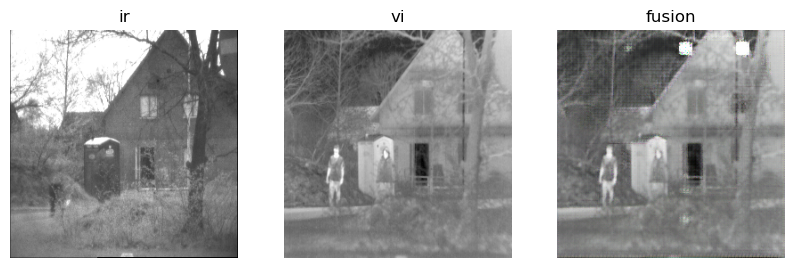

Epoch: 1834 D_epoch_loss: 0.385020911693573 G_epoch_loss: 3.344750165939331
Epoch: 1835 D_epoch_loss: 0.25188323855400085 G_epoch_loss: 3.144068956375122
Epoch: 1836 D_epoch_loss: 0.5800784826278687 G_epoch_loss: 0.8968394994735718
Epoch: 1837 D_epoch_loss: 0.20721903443336487 G_epoch_loss: 2.474346160888672
Epoch: 1838 D_epoch_loss: 0.20197536051273346 G_epoch_loss: 2.9857337474823
Epoch: 1839 D_epoch_loss: 0.3685894012451172 G_epoch_loss: 1.4590246677398682
Epoch: 1840 D_epoch_loss: 0.23743116855621338 G_epoch_loss: 3.3141446113586426
Epoch: 1841 D_epoch_loss: 0.27471181750297546 G_epoch_loss: 2.091872453689575
Epoch: 1842 D_epoch_loss: 0.2730979025363922 G_epoch_loss: 1.8344995975494385
Epoch: 1843 D_epoch_loss: 0.26083898544311523 G_epoch_loss: 2.214726686477661
Epoch: 1844 D_epoch_loss: 0.2096939980983734 G_epoch_loss: 3.237955093383789
Epoch: 1845 D_epoch_loss: 0.196883425116539 G_epoch_loss: 3.4462015628814697
Epoch: 1846 D_epoch_loss: 0.24339637160301208 G_epoch_loss: 1.8554593

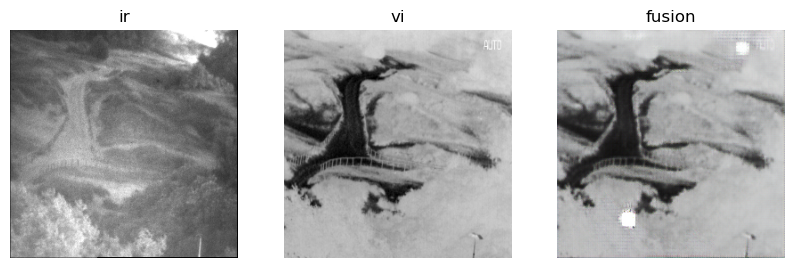

Epoch: 1881 D_epoch_loss: 0.8344072699546814 G_epoch_loss: 1.71382737159729
Epoch: 1882 D_epoch_loss: 0.5797823667526245 G_epoch_loss: 2.759538412094116
Epoch: 1883 D_epoch_loss: 0.537725031375885 G_epoch_loss: 2.3134918212890625
Epoch: 1884 D_epoch_loss: 0.7229362726211548 G_epoch_loss: 1.4671539068222046
Epoch: 1885 D_epoch_loss: 0.6830394864082336 G_epoch_loss: 2.336505889892578
Epoch: 1886 D_epoch_loss: 0.6241298913955688 G_epoch_loss: 1.35930597782135
Epoch: 1887 D_epoch_loss: 0.5442102551460266 G_epoch_loss: 2.6422815322875977
Epoch: 1888 D_epoch_loss: 0.7488679885864258 G_epoch_loss: 2.4569523334503174
Epoch: 1889 D_epoch_loss: 1.350926399230957 G_epoch_loss: 5.558599948883057
Epoch: 1890 D_epoch_loss: 0.8307947516441345 G_epoch_loss: 2.6185414791107178
Epoch: 1891 D_epoch_loss: 0.5841566324234009 G_epoch_loss: 3.0833539962768555
Epoch: 1892 D_epoch_loss: 0.6460696458816528 G_epoch_loss: 1.283642053604126
Epoch: 1893 D_epoch_loss: 0.8615682125091553 G_epoch_loss: 2.9827318191528

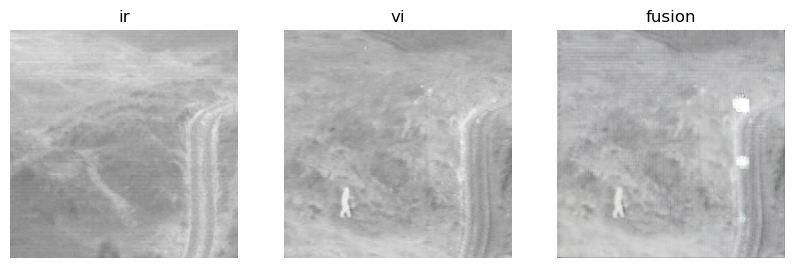

Epoch: 1928 D_epoch_loss: 0.6626715660095215 G_epoch_loss: 1.1410136222839355
Epoch: 1929 D_epoch_loss: 0.6251001954078674 G_epoch_loss: 1.2275688648223877
Epoch: 1930 D_epoch_loss: 0.6222212910652161 G_epoch_loss: 1.2108345031738281
Epoch: 1931 D_epoch_loss: 0.7071942687034607 G_epoch_loss: 1.240123987197876
Epoch: 1932 D_epoch_loss: 0.5594175457954407 G_epoch_loss: 1.478703260421753
Epoch: 1933 D_epoch_loss: 0.3590167760848999 G_epoch_loss: 2.6766233444213867
Epoch: 1934 D_epoch_loss: 0.46660634875297546 G_epoch_loss: 1.3064486980438232
Epoch: 1935 D_epoch_loss: 0.2985989451408386 G_epoch_loss: 2.711630344390869
Epoch: 1936 D_epoch_loss: 0.2665126323699951 G_epoch_loss: 3.2389156818389893
Epoch: 1937 D_epoch_loss: 0.5529975295066833 G_epoch_loss: 0.9634397029876709
Epoch: 1938 D_epoch_loss: 0.32179027795791626 G_epoch_loss: 3.3825340270996094
Epoch: 1939 D_epoch_loss: 0.31314462423324585 G_epoch_loss: 1.7925971746444702
Epoch: 1940 D_epoch_loss: 0.2606878876686096 G_epoch_loss: 2.074

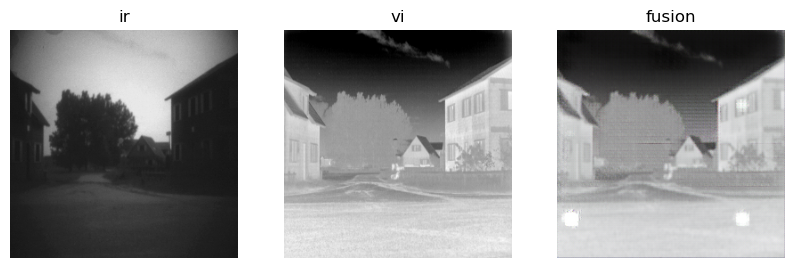

Epoch: 1975 D_epoch_loss: 0.3904230296611786 G_epoch_loss: 1.3813105821609497
Epoch: 1976 D_epoch_loss: 0.4404769241809845 G_epoch_loss: 1.1035592555999756
Epoch: 1977 D_epoch_loss: 0.41610151529312134 G_epoch_loss: 2.079007625579834
Epoch: 1978 D_epoch_loss: 0.3467431962490082 G_epoch_loss: 3.9576618671417236
Epoch: 1979 D_epoch_loss: 0.1988065540790558 G_epoch_loss: 2.985417127609253
Epoch: 1980 D_epoch_loss: 0.24650198221206665 G_epoch_loss: 2.2647604942321777
Epoch: 1981 D_epoch_loss: 0.3980273902416229 G_epoch_loss: 1.299897313117981
Epoch: 1982 D_epoch_loss: 0.4333861172199249 G_epoch_loss: 1.3237398862838745
Epoch: 1983 D_epoch_loss: 0.5290255546569824 G_epoch_loss: 1.709362506866455
Epoch: 1984 D_epoch_loss: 0.33541813492774963 G_epoch_loss: 3.0662992000579834
Epoch: 1985 D_epoch_loss: 0.439482182264328 G_epoch_loss: 1.2114219665527344
Epoch: 1986 D_epoch_loss: 0.42853713035583496 G_epoch_loss: 1.9207239151000977
Epoch: 1987 D_epoch_loss: 0.2536778450012207 G_epoch_loss: 2.4474

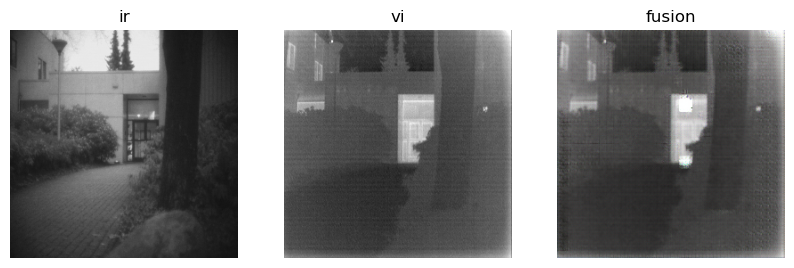

Epoch: 2022 D_epoch_loss: 0.20171554386615753 G_epoch_loss: 4.59426212310791
Epoch: 2023 D_epoch_loss: 0.12273114174604416 G_epoch_loss: 3.636230707168579
Epoch: 2024 D_epoch_loss: 0.24076606333255768 G_epoch_loss: 2.0275144577026367
Epoch: 2025 D_epoch_loss: 0.2648552656173706 G_epoch_loss: 1.5544825792312622
Epoch: 2026 D_epoch_loss: 0.3657265603542328 G_epoch_loss: 3.5049924850463867
Epoch: 2027 D_epoch_loss: 1.5928813219070435 G_epoch_loss: 4.89046573638916
Epoch: 2028 D_epoch_loss: 0.2804010510444641 G_epoch_loss: 1.871532678604126
Epoch: 2029 D_epoch_loss: 0.5435562133789062 G_epoch_loss: 3.9034972190856934
Epoch: 2030 D_epoch_loss: 0.2516934275627136 G_epoch_loss: 2.574279546737671
Epoch: 2031 D_epoch_loss: 0.2792697846889496 G_epoch_loss: 1.8747204542160034
Epoch: 2032 D_epoch_loss: 0.42358484864234924 G_epoch_loss: 4.975885391235352
Epoch: 2033 D_epoch_loss: 0.37941545248031616 G_epoch_loss: 4.714267730712891
Epoch: 2034 D_epoch_loss: 0.4682362973690033 G_epoch_loss: 3.9403522

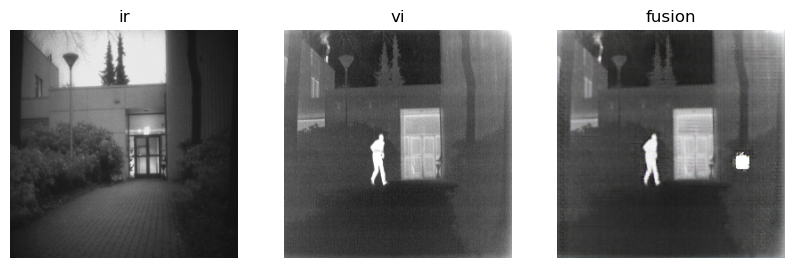

Epoch: 2069 D_epoch_loss: 0.5805965662002563 G_epoch_loss: 2.5485150814056396
Epoch: 2070 D_epoch_loss: 0.41321462392807007 G_epoch_loss: 5.05525541305542
Epoch: 2071 D_epoch_loss: 0.5610572099685669 G_epoch_loss: 4.736922740936279
Epoch: 2072 D_epoch_loss: 0.27452370524406433 G_epoch_loss: 3.93815279006958
Epoch: 2073 D_epoch_loss: 0.3451077342033386 G_epoch_loss: 2.2512495517730713
Epoch: 2074 D_epoch_loss: 0.45655936002731323 G_epoch_loss: 1.5996233224868774
Epoch: 2075 D_epoch_loss: 0.4364855885505676 G_epoch_loss: 2.020231008529663
Epoch: 2076 D_epoch_loss: 0.36868971586227417 G_epoch_loss: 4.075120449066162
Epoch: 2077 D_epoch_loss: 0.3480089008808136 G_epoch_loss: 1.8434956073760986
Epoch: 2078 D_epoch_loss: 0.18342489004135132 G_epoch_loss: 3.74509334564209
Epoch: 2079 D_epoch_loss: 0.200600728392601 G_epoch_loss: 2.8196942806243896
Epoch: 2080 D_epoch_loss: 0.4962024390697479 G_epoch_loss: 1.0369720458984375
Epoch: 2081 D_epoch_loss: 0.8440826535224915 G_epoch_loss: 3.91191458

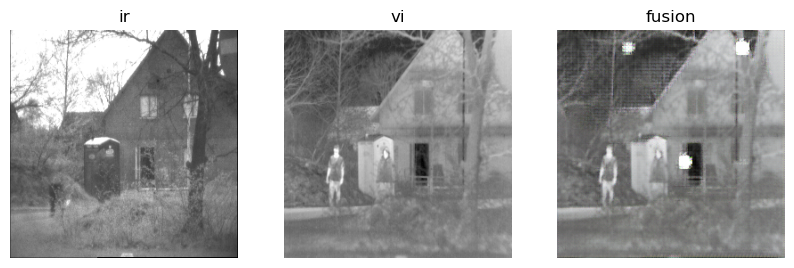

Epoch: 2116 D_epoch_loss: 0.5107064247131348 G_epoch_loss: 2.3092219829559326
Epoch: 2117 D_epoch_loss: 0.9253767132759094 G_epoch_loss: 1.9173961877822876
Epoch: 2118 D_epoch_loss: 1.911230206489563 G_epoch_loss: 1.6865748167037964
Epoch: 2119 D_epoch_loss: 1.0017136335372925 G_epoch_loss: 2.9951012134552
Epoch: 2120 D_epoch_loss: 1.7873289585113525 G_epoch_loss: 1.0439687967300415
Epoch: 2121 D_epoch_loss: 0.9139871001243591 G_epoch_loss: 1.8462414741516113
Epoch: 2122 D_epoch_loss: 0.8151576519012451 G_epoch_loss: 2.600590705871582
Epoch: 2123 D_epoch_loss: 0.39236804842948914 G_epoch_loss: 2.6653451919555664
Epoch: 2124 D_epoch_loss: 0.5243078470230103 G_epoch_loss: 1.4595617055892944
Epoch: 2125 D_epoch_loss: 0.39962249994277954 G_epoch_loss: 2.6355254650115967
Epoch: 2126 D_epoch_loss: 0.2807464003562927 G_epoch_loss: 4.155627250671387
Epoch: 2127 D_epoch_loss: 0.21499383449554443 G_epoch_loss: 3.7743031978607178
Epoch: 2128 D_epoch_loss: 0.23916423320770264 G_epoch_loss: 2.38133

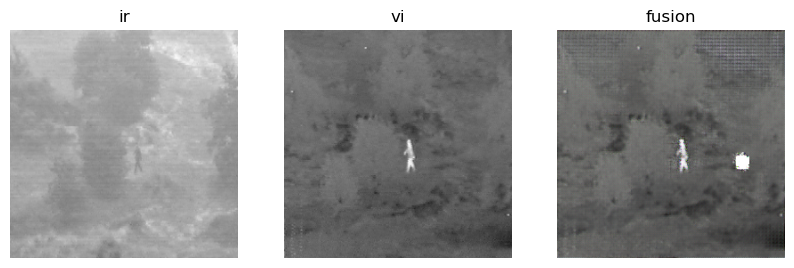

Epoch: 2163 D_epoch_loss: 0.34714609384536743 G_epoch_loss: 1.8991631269454956
Epoch: 2164 D_epoch_loss: 0.22104573249816895 G_epoch_loss: 3.4582560062408447
Epoch: 2165 D_epoch_loss: 0.18477076292037964 G_epoch_loss: 3.066992998123169
Epoch: 2166 D_epoch_loss: 0.3354792594909668 G_epoch_loss: 1.5446254014968872
Epoch: 2167 D_epoch_loss: 0.2962035536766052 G_epoch_loss: 4.098751544952393
Epoch: 2168 D_epoch_loss: 0.1646273285150528 G_epoch_loss: 2.93585467338562
Epoch: 2169 D_epoch_loss: 0.6663785576820374 G_epoch_loss: 0.7999781370162964
Epoch: 2170 D_epoch_loss: 0.42231133580207825 G_epoch_loss: 2.630807876586914
Epoch: 2171 D_epoch_loss: 0.5464061498641968 G_epoch_loss: 1.357351303100586
Epoch: 2172 D_epoch_loss: 0.3344036936759949 G_epoch_loss: 2.7065486907958984
Epoch: 2173 D_epoch_loss: 0.2859324514865875 G_epoch_loss: 2.2056736946105957
Epoch: 2174 D_epoch_loss: 0.5520797967910767 G_epoch_loss: 0.9680145382881165
Epoch: 2175 D_epoch_loss: 0.5249750018119812 G_epoch_loss: 2.47762

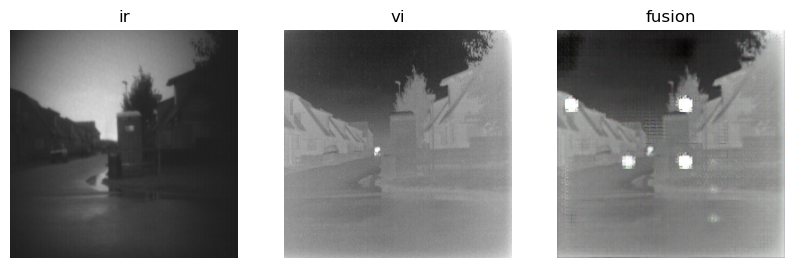

Epoch: 2210 D_epoch_loss: 0.46576565504074097 G_epoch_loss: 1.568503975868225
Epoch: 2211 D_epoch_loss: 0.2726319134235382 G_epoch_loss: 3.0670785903930664
Epoch: 2212 D_epoch_loss: 0.18961970508098602 G_epoch_loss: 3.7744181156158447
Epoch: 2213 D_epoch_loss: 0.16593681275844574 G_epoch_loss: 2.766324043273926
Epoch: 2214 D_epoch_loss: 0.19547957181930542 G_epoch_loss: 2.626847267150879
Epoch: 2215 D_epoch_loss: 0.1705559641122818 G_epoch_loss: 3.3925883769989014
Epoch: 2216 D_epoch_loss: 0.42419126629829407 G_epoch_loss: 2.471757650375366
Epoch: 2217 D_epoch_loss: 0.8103768229484558 G_epoch_loss: 2.8814454078674316
Epoch: 2218 D_epoch_loss: 0.7590699195861816 G_epoch_loss: 2.63394832611084
Epoch: 2219 D_epoch_loss: 0.4707721173763275 G_epoch_loss: 2.538273334503174
Epoch: 2220 D_epoch_loss: 0.4930238723754883 G_epoch_loss: 5.273901462554932
Epoch: 2221 D_epoch_loss: 0.3233660161495209 G_epoch_loss: 4.9247822761535645
Epoch: 2222 D_epoch_loss: 0.20517206192016602 G_epoch_loss: 3.45779

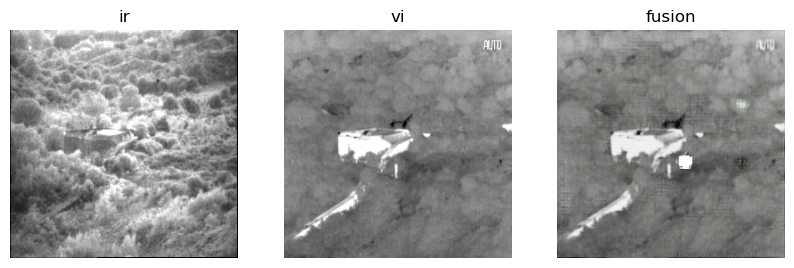

Epoch: 2257 D_epoch_loss: 0.333090215921402 G_epoch_loss: 2.799009084701538
Epoch: 2258 D_epoch_loss: 0.2812095284461975 G_epoch_loss: 3.1449344158172607
Epoch: 2259 D_epoch_loss: 0.2795577049255371 G_epoch_loss: 1.8430500030517578
Epoch: 2260 D_epoch_loss: 0.2594936490058899 G_epoch_loss: 1.971821665763855
Epoch: 2261 D_epoch_loss: 0.3785790801048279 G_epoch_loss: 1.4533827304840088
Epoch: 2262 D_epoch_loss: 0.5109581351280212 G_epoch_loss: 1.9384887218475342
Epoch: 2263 D_epoch_loss: 0.3043577969074249 G_epoch_loss: 2.371288537979126
Epoch: 2264 D_epoch_loss: 0.13840539753437042 G_epoch_loss: 4.017219543457031
Epoch: 2265 D_epoch_loss: 0.1540212780237198 G_epoch_loss: 2.731964588165283
Epoch: 2266 D_epoch_loss: 0.2407686561346054 G_epoch_loss: 2.0579020977020264
Epoch: 2267 D_epoch_loss: 0.3547530770301819 G_epoch_loss: 1.3683162927627563
Epoch: 2268 D_epoch_loss: 0.4653896689414978 G_epoch_loss: 1.9101617336273193
Epoch: 2269 D_epoch_loss: 0.40537458658218384 G_epoch_loss: 2.7424924

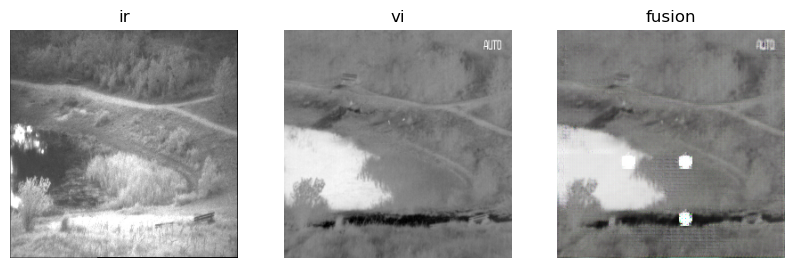

Epoch: 2304 D_epoch_loss: 0.34236592054367065 G_epoch_loss: 4.123589992523193
Epoch: 2305 D_epoch_loss: 0.15016067028045654 G_epoch_loss: 3.2598841190338135
Epoch: 2306 D_epoch_loss: 0.27813053131103516 G_epoch_loss: 1.6663451194763184
Epoch: 2307 D_epoch_loss: 0.38823598623275757 G_epoch_loss: 1.5113420486450195
Epoch: 2308 D_epoch_loss: 0.35908710956573486 G_epoch_loss: 1.4483389854431152
Epoch: 2309 D_epoch_loss: 0.6787986755371094 G_epoch_loss: 2.9402177333831787
Epoch: 2310 D_epoch_loss: 0.24349091947078705 G_epoch_loss: 1.946943998336792
Epoch: 2311 D_epoch_loss: 1.1849950551986694 G_epoch_loss: 0.46746429800987244
Epoch: 2312 D_epoch_loss: 0.2759658396244049 G_epoch_loss: 1.8055877685546875
Epoch: 2313 D_epoch_loss: 0.38912492990493774 G_epoch_loss: 1.1895678043365479
Epoch: 2314 D_epoch_loss: 0.7631550431251526 G_epoch_loss: 0.833039402961731
Epoch: 2315 D_epoch_loss: 0.6422159075737 G_epoch_loss: 1.3813189268112183
Epoch: 2316 D_epoch_loss: 0.5120724439620972 G_epoch_loss: 1.2

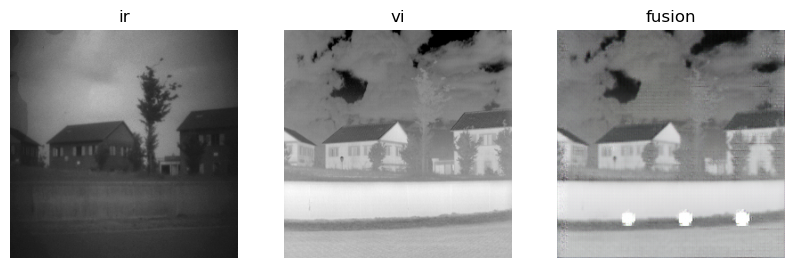

Epoch: 2351 D_epoch_loss: 0.1694774031639099 G_epoch_loss: 3.2305829524993896
Epoch: 2352 D_epoch_loss: 0.31199002265930176 G_epoch_loss: 1.5289503335952759
Epoch: 2353 D_epoch_loss: 0.2235127091407776 G_epoch_loss: 2.223301410675049
Epoch: 2354 D_epoch_loss: 0.19359450042247772 G_epoch_loss: 4.277541637420654
Epoch: 2355 D_epoch_loss: 0.12689758837223053 G_epoch_loss: 3.8906919956207275
Epoch: 2356 D_epoch_loss: 0.20870766043663025 G_epoch_loss: 2.161865472793579
Epoch: 2357 D_epoch_loss: 0.31412726640701294 G_epoch_loss: 1.3894727230072021
Epoch: 2358 D_epoch_loss: 0.352638304233551 G_epoch_loss: 2.7153260707855225
Epoch: 2359 D_epoch_loss: 0.35006025433540344 G_epoch_loss: 1.5394703149795532
Epoch: 2360 D_epoch_loss: 0.45311209559440613 G_epoch_loss: 1.6961275339126587
Epoch: 2361 D_epoch_loss: 0.251140832901001 G_epoch_loss: 3.6146187782287598
Epoch: 2362 D_epoch_loss: 0.19728770852088928 G_epoch_loss: 2.216120481491089
Epoch: 2363 D_epoch_loss: 0.37384361028671265 G_epoch_loss: 1.

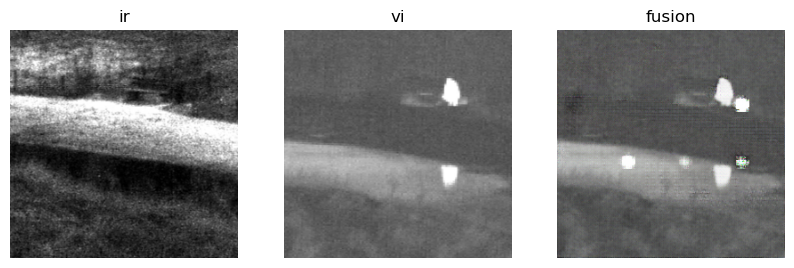

Epoch: 2398 D_epoch_loss: 0.6476002335548401 G_epoch_loss: 1.1179614067077637
Epoch: 2399 D_epoch_loss: 0.7462515830993652 G_epoch_loss: 1.2194501161575317
Epoch: 2400 D_epoch_loss: 2.0891952514648438 G_epoch_loss: 1.2199455499649048
Epoch: 2401 D_epoch_loss: 1.9109283685684204 G_epoch_loss: 2.490236759185791
Epoch: 2402 D_epoch_loss: 1.2522633075714111 G_epoch_loss: 2.432394504547119
Epoch: 2403 D_epoch_loss: 0.9161418676376343 G_epoch_loss: 3.01694655418396
Epoch: 2404 D_epoch_loss: 0.9795589447021484 G_epoch_loss: 1.4111499786376953
Epoch: 2405 D_epoch_loss: 1.0100773572921753 G_epoch_loss: 1.625266432762146
Epoch: 2406 D_epoch_loss: 0.7443032264709473 G_epoch_loss: 2.3307483196258545
Epoch: 2407 D_epoch_loss: 0.6054420471191406 G_epoch_loss: 3.5257081985473633
Epoch: 2408 D_epoch_loss: 0.6757475733757019 G_epoch_loss: 1.728991985321045
Epoch: 2409 D_epoch_loss: 0.5349241495132446 G_epoch_loss: 2.6303555965423584
Epoch: 2410 D_epoch_loss: 0.4244388937950134 G_epoch_loss: 3.134507417

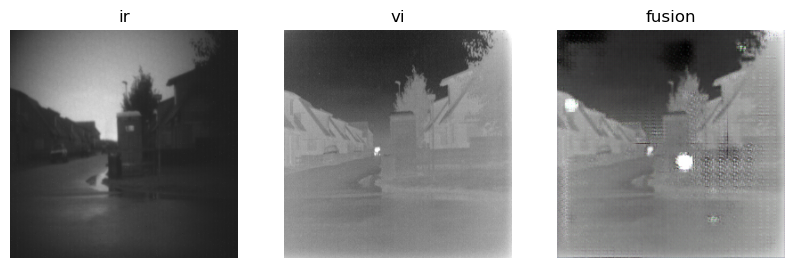

Epoch: 2445 D_epoch_loss: 0.25060081481933594 G_epoch_loss: 2.1086833477020264
Epoch: 2446 D_epoch_loss: 0.34142524003982544 G_epoch_loss: 1.4665913581848145
Epoch: 2447 D_epoch_loss: 0.25284990668296814 G_epoch_loss: 2.3755085468292236
Epoch: 2448 D_epoch_loss: 0.2273183912038803 G_epoch_loss: 4.7360687255859375
Epoch: 2449 D_epoch_loss: 0.34551167488098145 G_epoch_loss: 3.5311667919158936
Epoch: 2450 D_epoch_loss: 1.7718844413757324 G_epoch_loss: 5.656893730163574
Epoch: 2451 D_epoch_loss: 2.4009528160095215 G_epoch_loss: 2.280154228210449
Epoch: 2452 D_epoch_loss: 1.6452662944793701 G_epoch_loss: 1.7812741994857788
Epoch: 2453 D_epoch_loss: 1.2565089464187622 G_epoch_loss: 4.767815113067627
Epoch: 2454 D_epoch_loss: 0.8387653231620789 G_epoch_loss: 4.694402694702148
Epoch: 2455 D_epoch_loss: 1.2899513244628906 G_epoch_loss: 1.8633387088775635
Epoch: 2456 D_epoch_loss: 1.432138204574585 G_epoch_loss: 1.5001492500305176
Epoch: 2457 D_epoch_loss: 0.7931426763534546 G_epoch_loss: 3.1909

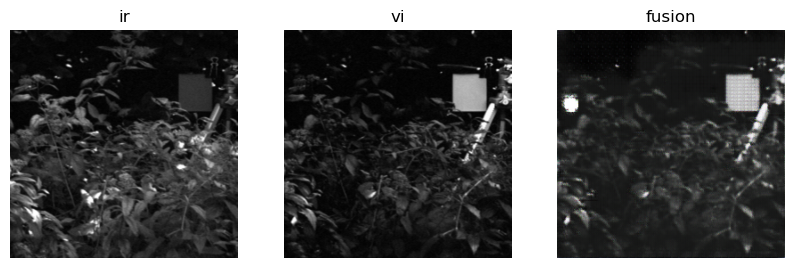

Epoch: 2492 D_epoch_loss: 0.478899747133255 G_epoch_loss: 1.553918480873108
Epoch: 2493 D_epoch_loss: 0.4249166250228882 G_epoch_loss: 1.7510175704956055
Epoch: 2494 D_epoch_loss: 0.5234777927398682 G_epoch_loss: 1.9554017782211304
Epoch: 2495 D_epoch_loss: 0.42722946405410767 G_epoch_loss: 3.5482466220855713
Epoch: 2496 D_epoch_loss: 0.4589272737503052 G_epoch_loss: 1.5250954627990723
Epoch: 2497 D_epoch_loss: 0.5352091193199158 G_epoch_loss: 1.247611165046692
Epoch: 2498 D_epoch_loss: 0.6582410335540771 G_epoch_loss: 1.4629827737808228
Epoch: 2499 D_epoch_loss: 0.3653201758861542 G_epoch_loss: 3.8091602325439453
Epoch: 2500 D_epoch_loss: 0.3662794828414917 G_epoch_loss: 2.114647388458252
Epoch: 2501 D_epoch_loss: 0.23389378190040588 G_epoch_loss: 4.218587875366211
Epoch: 2502 D_epoch_loss: 0.2393876016139984 G_epoch_loss: 2.945678949356079
Epoch: 2503 D_epoch_loss: 0.4336649179458618 G_epoch_loss: 1.2814301252365112
Epoch: 2504 D_epoch_loss: 0.45787936449050903 G_epoch_loss: 2.092123

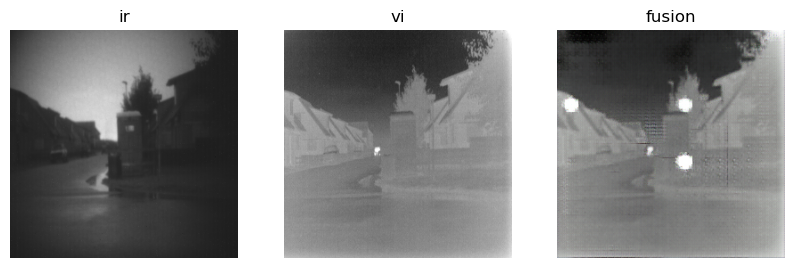

Epoch: 2539 D_epoch_loss: 0.7063286304473877 G_epoch_loss: 0.9970549941062927
Epoch: 2540 D_epoch_loss: 0.7722914814949036 G_epoch_loss: 1.0262928009033203
Epoch: 2541 D_epoch_loss: 0.6713458299636841 G_epoch_loss: 0.9945818781852722
Epoch: 2542 D_epoch_loss: 0.6562185883522034 G_epoch_loss: 1.0531518459320068
Epoch: 2543 D_epoch_loss: 0.6609663963317871 G_epoch_loss: 1.13848078250885
Epoch: 2544 D_epoch_loss: 0.6731918454170227 G_epoch_loss: 1.124817967414856
Epoch: 2545 D_epoch_loss: 0.6786810159683228 G_epoch_loss: 1.0527317523956299
Epoch: 2546 D_epoch_loss: 0.7010603547096252 G_epoch_loss: 0.9468637704849243
Epoch: 2547 D_epoch_loss: 0.7124757170677185 G_epoch_loss: 0.9877306818962097
Epoch: 2548 D_epoch_loss: 0.7078758478164673 G_epoch_loss: 1.093016266822815
Epoch: 2549 D_epoch_loss: 0.6995455622673035 G_epoch_loss: 0.9575362205505371
Epoch: 2550 D_epoch_loss: 0.6961311101913452 G_epoch_loss: 1.019012689590454
Epoch: 2551 D_epoch_loss: 0.6670504808425903 G_epoch_loss: 1.10671627

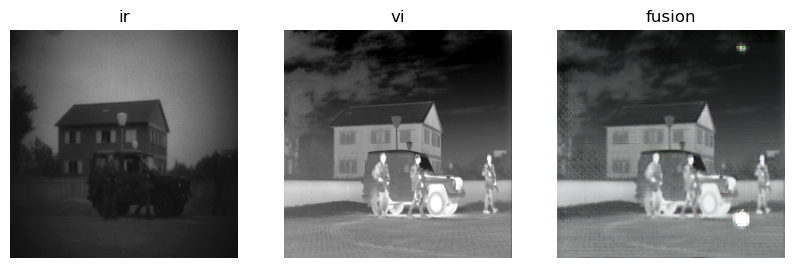

Epoch: 2586 D_epoch_loss: 0.15887582302093506 G_epoch_loss: 4.156256675720215
Epoch: 2587 D_epoch_loss: 0.2007666975259781 G_epoch_loss: 2.7651307582855225
Epoch: 2588 D_epoch_loss: 0.24421678483486176 G_epoch_loss: 2.1352784633636475
Epoch: 2589 D_epoch_loss: 0.263894259929657 G_epoch_loss: 1.912062406539917
Epoch: 2590 D_epoch_loss: 0.33679819107055664 G_epoch_loss: 1.5358525514602661
Epoch: 2591 D_epoch_loss: 0.37286946177482605 G_epoch_loss: 1.874062418937683
Epoch: 2592 D_epoch_loss: 0.47799116373062134 G_epoch_loss: 1.4966235160827637
Epoch: 2593 D_epoch_loss: 0.4875994324684143 G_epoch_loss: 1.6252094507217407
Epoch: 2594 D_epoch_loss: 0.36586442589759827 G_epoch_loss: 2.399970054626465
Epoch: 2595 D_epoch_loss: 0.2708175778388977 G_epoch_loss: 2.261403799057007
Epoch: 2596 D_epoch_loss: 0.19163119792938232 G_epoch_loss: 3.904540538787842
Epoch: 2597 D_epoch_loss: 0.2664693295955658 G_epoch_loss: 1.7831777334213257
Epoch: 2598 D_epoch_loss: 0.45850613713264465 G_epoch_loss: 1.25

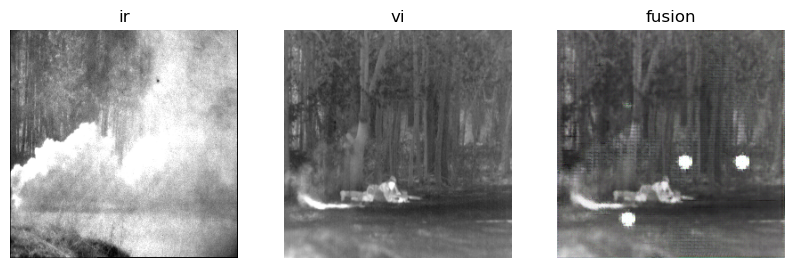

Epoch: 2633 D_epoch_loss: 0.5147240161895752 G_epoch_loss: 1.3241204023361206
Epoch: 2634 D_epoch_loss: 0.41914212703704834 G_epoch_loss: 1.5931204557418823
Epoch: 2635 D_epoch_loss: 0.28319087624549866 G_epoch_loss: 2.743147611618042
Epoch: 2636 D_epoch_loss: 0.4832444190979004 G_epoch_loss: 1.0219721794128418
Epoch: 2637 D_epoch_loss: 0.6080968976020813 G_epoch_loss: 1.2325246334075928
Epoch: 2638 D_epoch_loss: 0.38085630536079407 G_epoch_loss: 4.870245933532715
Epoch: 2639 D_epoch_loss: 0.13696356117725372 G_epoch_loss: 3.4782485961914062
Epoch: 2640 D_epoch_loss: 0.5692596435546875 G_epoch_loss: 0.8963141441345215
Epoch: 2641 D_epoch_loss: 0.24556410312652588 G_epoch_loss: 2.124943256378174
Epoch: 2642 D_epoch_loss: 0.1818632185459137 G_epoch_loss: 3.7501330375671387
Epoch: 2643 D_epoch_loss: 0.20966041088104248 G_epoch_loss: 2.6719532012939453
Epoch: 2644 D_epoch_loss: 0.23294241726398468 G_epoch_loss: 2.161564350128174
Epoch: 2645 D_epoch_loss: 0.16943684220314026 G_epoch_loss: 3

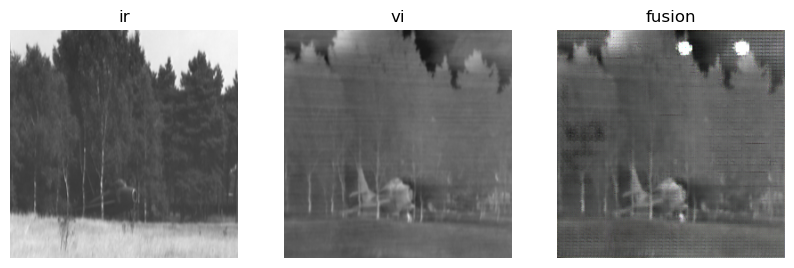

Epoch: 2680 D_epoch_loss: 0.8266072273254395 G_epoch_loss: 0.5593895316123962
Epoch: 2681 D_epoch_loss: 1.5668811798095703 G_epoch_loss: 1.0744707584381104
Epoch: 2682 D_epoch_loss: 0.28464680910110474 G_epoch_loss: 2.776939868927002
Epoch: 2683 D_epoch_loss: 0.3774952292442322 G_epoch_loss: 1.5358589887619019
Epoch: 2684 D_epoch_loss: 0.7616732716560364 G_epoch_loss: 0.8519916534423828
Epoch: 2685 D_epoch_loss: 0.8514439463615417 G_epoch_loss: 1.021116018295288
Epoch: 2686 D_epoch_loss: 0.6212533116340637 G_epoch_loss: 1.408778429031372
Epoch: 2687 D_epoch_loss: 0.7415199279785156 G_epoch_loss: 1.6919875144958496
Epoch: 2688 D_epoch_loss: 1.1791467666625977 G_epoch_loss: 0.972719132900238
Epoch: 2689 D_epoch_loss: 3.989835500717163 G_epoch_loss: 7.535970211029053
Epoch: 2690 D_epoch_loss: 2.31866455078125 G_epoch_loss: 3.941556692123413
Epoch: 2691 D_epoch_loss: 3.0187511444091797 G_epoch_loss: 1.3516184091567993
Epoch: 2692 D_epoch_loss: 2.2930402755737305 G_epoch_loss: 1.23385703563

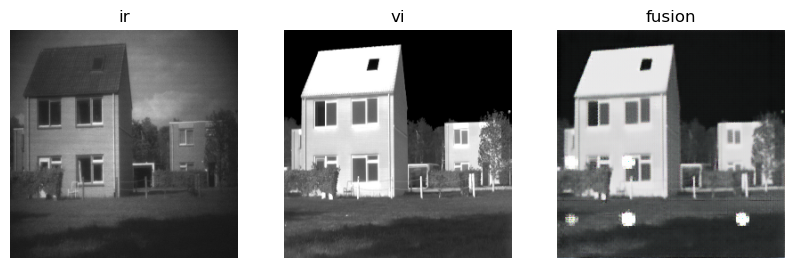

Epoch: 2727 D_epoch_loss: 0.5649360418319702 G_epoch_loss: 5.706404209136963
Epoch: 2728 D_epoch_loss: 0.2705753445625305 G_epoch_loss: 4.499607563018799
Epoch: 2729 D_epoch_loss: 0.5584465265274048 G_epoch_loss: 1.9712436199188232
Epoch: 2730 D_epoch_loss: 0.9057976007461548 G_epoch_loss: 3.7161688804626465
Epoch: 2731 D_epoch_loss: 0.7330461740493774 G_epoch_loss: 1.2718148231506348
Epoch: 2732 D_epoch_loss: 0.6779100894927979 G_epoch_loss: 2.7545034885406494
Epoch: 2733 D_epoch_loss: 0.37208881974220276 G_epoch_loss: 4.795990467071533
Epoch: 2734 D_epoch_loss: 0.40340614318847656 G_epoch_loss: 2.191333055496216
Epoch: 2735 D_epoch_loss: 0.2532767653465271 G_epoch_loss: 3.762171506881714
Epoch: 2736 D_epoch_loss: 0.24530579149723053 G_epoch_loss: 2.8008949756622314
Epoch: 2737 D_epoch_loss: 0.32644614577293396 G_epoch_loss: 2.055694103240967
Epoch: 2738 D_epoch_loss: 0.3793874979019165 G_epoch_loss: 1.6555275917053223
Epoch: 2739 D_epoch_loss: 0.47216498851776123 G_epoch_loss: 3.9705

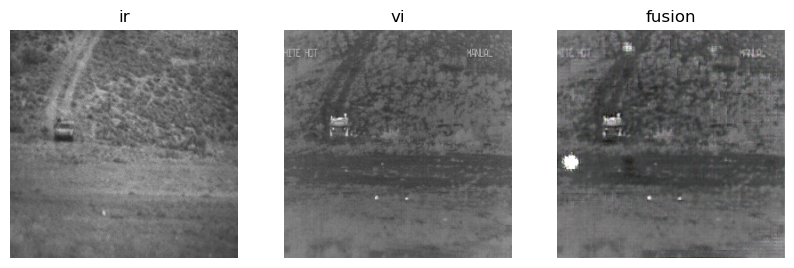

Epoch: 2774 D_epoch_loss: 0.5191736817359924 G_epoch_loss: 1.304700493812561
Epoch: 2775 D_epoch_loss: 0.7985647320747375 G_epoch_loss: 0.695715069770813
Epoch: 2776 D_epoch_loss: 0.7157652974128723 G_epoch_loss: 1.150753378868103
Epoch: 2777 D_epoch_loss: 0.7455123662948608 G_epoch_loss: 1.3429750204086304
Epoch: 2778 D_epoch_loss: 0.6728458404541016 G_epoch_loss: 0.9956762790679932
Epoch: 2779 D_epoch_loss: 0.7061861157417297 G_epoch_loss: 1.0094636678695679
Epoch: 2780 D_epoch_loss: 0.6808408498764038 G_epoch_loss: 1.077510952949524
Epoch: 2781 D_epoch_loss: 0.73799729347229 G_epoch_loss: 0.9830363392829895
Epoch: 2782 D_epoch_loss: 0.7309278249740601 G_epoch_loss: 0.9146785140037537
Epoch: 2783 D_epoch_loss: 0.6714590191841125 G_epoch_loss: 0.9034472107887268
Epoch: 2784 D_epoch_loss: 0.7340099811553955 G_epoch_loss: 1.0197592973709106
Epoch: 2785 D_epoch_loss: 0.7256477475166321 G_epoch_loss: 0.9192259907722473
Epoch: 2786 D_epoch_loss: 0.7032687067985535 G_epoch_loss: 0.999076128

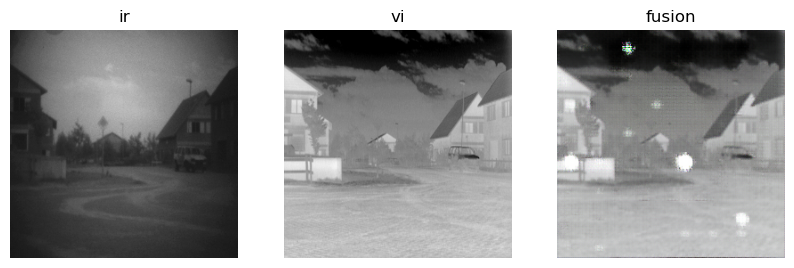

Epoch: 2821 D_epoch_loss: 0.9785425662994385 G_epoch_loss: 1.4630485773086548
Epoch: 2822 D_epoch_loss: 0.9344455003738403 G_epoch_loss: 1.1777856349945068
Epoch: 2823 D_epoch_loss: 0.9474775195121765 G_epoch_loss: 1.4972220659255981
Epoch: 2824 D_epoch_loss: 0.9042344689369202 G_epoch_loss: 0.9524727463722229
Epoch: 2825 D_epoch_loss: 0.8864171504974365 G_epoch_loss: 1.433226466178894
Epoch: 2826 D_epoch_loss: 0.7717815637588501 G_epoch_loss: 1.261915922164917
Epoch: 2827 D_epoch_loss: 0.7671810388565063 G_epoch_loss: 1.2016546726226807
Epoch: 2828 D_epoch_loss: 0.7555006742477417 G_epoch_loss: 1.413138508796692
Epoch: 2829 D_epoch_loss: 0.7922407984733582 G_epoch_loss: 0.7359321713447571
Epoch: 2830 D_epoch_loss: 0.9017736911773682 G_epoch_loss: 2.2877614498138428
Epoch: 2831 D_epoch_loss: 0.7167767882347107 G_epoch_loss: 1.0709264278411865
Epoch: 2832 D_epoch_loss: 0.6405442953109741 G_epoch_loss: 1.1000323295593262
Epoch: 2833 D_epoch_loss: 0.7417731881141663 G_epoch_loss: 1.653223

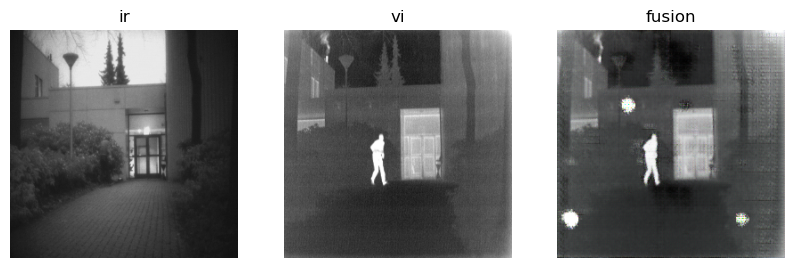

Epoch: 2868 D_epoch_loss: 0.14453403651714325 G_epoch_loss: 5.346057415008545
Epoch: 2869 D_epoch_loss: 0.11261498928070068 G_epoch_loss: 4.232968330383301
Epoch: 2870 D_epoch_loss: 0.13593563437461853 G_epoch_loss: 3.0575802326202393
Epoch: 2871 D_epoch_loss: 0.34976926445961 G_epoch_loss: 1.7438167333602905
Epoch: 2872 D_epoch_loss: 0.3208100199699402 G_epoch_loss: 1.363197922706604
Epoch: 2873 D_epoch_loss: 0.38734108209609985 G_epoch_loss: 2.7820281982421875
Epoch: 2874 D_epoch_loss: 0.200594961643219 G_epoch_loss: 4.054689407348633
Epoch: 2875 D_epoch_loss: 0.20737190544605255 G_epoch_loss: 2.1495718955993652
Epoch: 2876 D_epoch_loss: 0.21092472970485687 G_epoch_loss: 2.3457531929016113
Epoch: 2877 D_epoch_loss: 0.26699966192245483 G_epoch_loss: 1.9376519918441772
Epoch: 2878 D_epoch_loss: 0.4164679944515228 G_epoch_loss: 1.283294439315796
Epoch: 2879 D_epoch_loss: 0.7234513163566589 G_epoch_loss: 4.969637870788574
Epoch: 2880 D_epoch_loss: 0.14747263491153717 G_epoch_loss: 3.1237

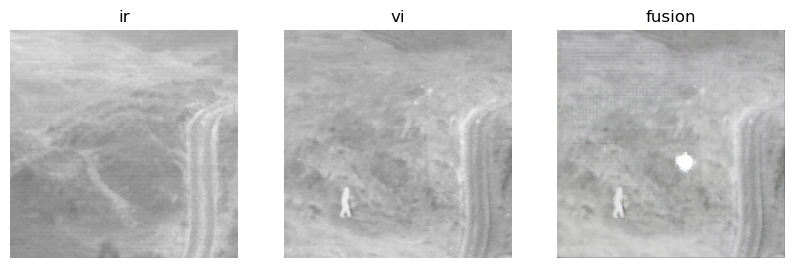

Epoch: 2915 D_epoch_loss: 1.3704278469085693 G_epoch_loss: 1.2676336765289307
Epoch: 2916 D_epoch_loss: 3.1777007579803467 G_epoch_loss: 6.616167068481445
Epoch: 2917 D_epoch_loss: 1.8856439590454102 G_epoch_loss: 4.049602508544922
Epoch: 2918 D_epoch_loss: 1.1819872856140137 G_epoch_loss: 2.2715282440185547
Epoch: 2919 D_epoch_loss: 0.607801079750061 G_epoch_loss: 3.0377824306488037
Epoch: 2920 D_epoch_loss: 1.2904479503631592 G_epoch_loss: 0.7403859496116638
Epoch: 2921 D_epoch_loss: 1.0935285091400146 G_epoch_loss: 2.1892311573028564
Epoch: 2922 D_epoch_loss: 0.5913693904876709 G_epoch_loss: 5.129988670349121
Epoch: 2923 D_epoch_loss: 0.7819308042526245 G_epoch_loss: 5.501986980438232
Epoch: 2924 D_epoch_loss: 0.5070463418960571 G_epoch_loss: 2.617975950241089
Epoch: 2925 D_epoch_loss: 0.8096888065338135 G_epoch_loss: 1.0564757585525513
Epoch: 2926 D_epoch_loss: 0.4692661464214325 G_epoch_loss: 3.210022449493408
Epoch: 2927 D_epoch_loss: 0.4478718042373657 G_epoch_loss: 3.1688563823

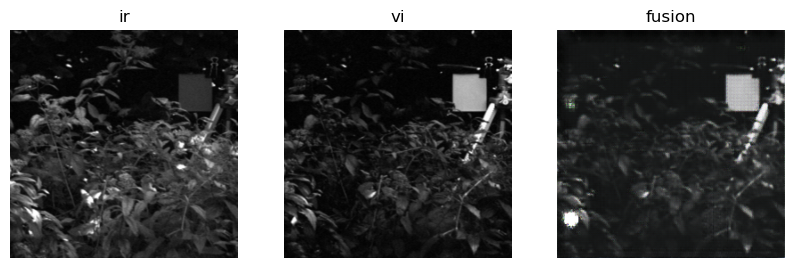

Epoch: 2962 D_epoch_loss: 0.13871394097805023 G_epoch_loss: 2.593296527862549
Epoch: 2963 D_epoch_loss: 0.4444597363471985 G_epoch_loss: 1.1877564191818237
Epoch: 2964 D_epoch_loss: 0.3865887522697449 G_epoch_loss: 1.4300014972686768
Epoch: 2965 D_epoch_loss: 0.8332170844078064 G_epoch_loss: 0.6520617008209229
Epoch: 2966 D_epoch_loss: 1.3281347751617432 G_epoch_loss: 1.0999165773391724
Epoch: 2967 D_epoch_loss: 0.35984286665916443 G_epoch_loss: 1.7965056896209717
Epoch: 2968 D_epoch_loss: 0.47258642315864563 G_epoch_loss: 1.3140642642974854
Epoch: 2969 D_epoch_loss: 0.6530522108078003 G_epoch_loss: 0.9532122611999512
Epoch: 2970 D_epoch_loss: 0.7591935992240906 G_epoch_loss: 1.0919256210327148
Epoch: 2971 D_epoch_loss: 0.5045319199562073 G_epoch_loss: 1.356353998184204
Epoch: 2972 D_epoch_loss: 0.6096879243850708 G_epoch_loss: 1.0248998403549194
Epoch: 2973 D_epoch_loss: 0.7647583484649658 G_epoch_loss: 1.0232840776443481
Epoch: 2974 D_epoch_loss: 0.7168760299682617 G_epoch_loss: 0.91

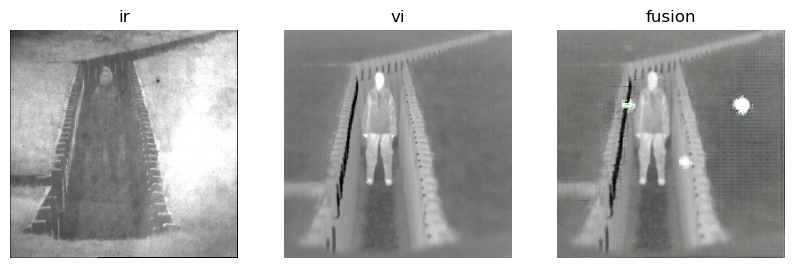

Epoch: 3009 D_epoch_loss: 0.4136626422405243 G_epoch_loss: 1.4050688743591309
Epoch: 3010 D_epoch_loss: 0.3417491614818573 G_epoch_loss: 4.365190505981445
Epoch: 3011 D_epoch_loss: 0.31513330340385437 G_epoch_loss: 1.419611930847168
Epoch: 3012 D_epoch_loss: 0.48913732171058655 G_epoch_loss: 1.0252726078033447
Epoch: 3013 D_epoch_loss: 0.5304687023162842 G_epoch_loss: 1.811160683631897
Epoch: 3014 D_epoch_loss: 0.274886816740036 G_epoch_loss: 3.022494316101074
Epoch: 3015 D_epoch_loss: 0.1792445331811905 G_epoch_loss: 2.8918232917785645
Epoch: 3016 D_epoch_loss: 0.27220430970191956 G_epoch_loss: 1.5528732538223267
Epoch: 3017 D_epoch_loss: 0.36307916045188904 G_epoch_loss: 1.4285542964935303
Epoch: 3018 D_epoch_loss: 0.24428237974643707 G_epoch_loss: 3.4717652797698975
Epoch: 3019 D_epoch_loss: 0.14094381034374237 G_epoch_loss: 4.723140716552734
Epoch: 3020 D_epoch_loss: 0.1491134911775589 G_epoch_loss: 3.3006956577301025
Epoch: 3021 D_epoch_loss: 0.24619647860527039 G_epoch_loss: 1.78

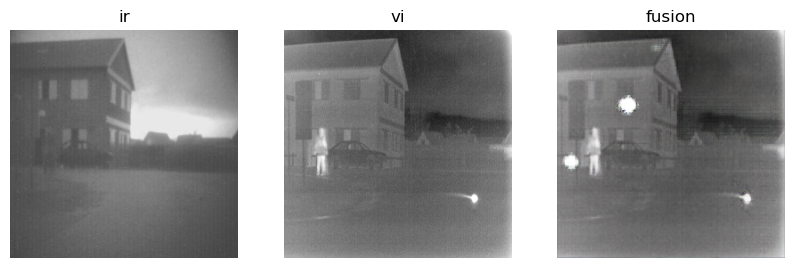

Epoch: 3056 D_epoch_loss: 0.1613999456167221 G_epoch_loss: 4.095062255859375
Epoch: 3057 D_epoch_loss: 0.1436721682548523 G_epoch_loss: 3.560640335083008
Epoch: 3058 D_epoch_loss: 0.20256640017032623 G_epoch_loss: 2.48677134513855
Epoch: 3059 D_epoch_loss: 0.2634143829345703 G_epoch_loss: 2.1165642738342285
Epoch: 3060 D_epoch_loss: 0.2407015711069107 G_epoch_loss: 2.0307915210723877
Epoch: 3061 D_epoch_loss: 0.292806476354599 G_epoch_loss: 1.9214155673980713
Epoch: 3062 D_epoch_loss: 0.3341720700263977 G_epoch_loss: 1.855797529220581
Epoch: 3063 D_epoch_loss: 0.2729635536670685 G_epoch_loss: 3.3274447917938232
Epoch: 3064 D_epoch_loss: 0.1490863859653473 G_epoch_loss: 4.235804557800293
Epoch: 3065 D_epoch_loss: 0.25118348002433777 G_epoch_loss: 1.9379161596298218
Epoch: 3066 D_epoch_loss: 0.1768718659877777 G_epoch_loss: 2.5786144733428955
Epoch: 3067 D_epoch_loss: 0.1233542189002037 G_epoch_loss: 5.279839515686035
Epoch: 3068 D_epoch_loss: 0.11246638000011444 G_epoch_loss: 4.69390630

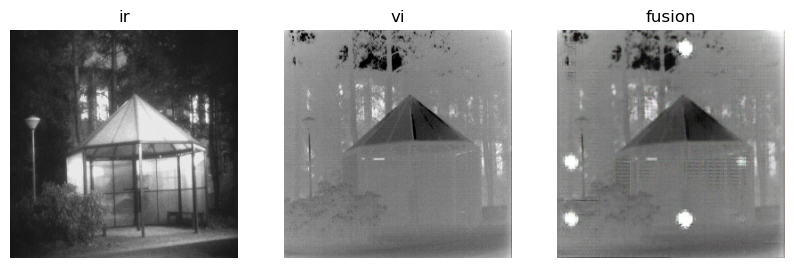

Epoch: 3103 D_epoch_loss: 0.6141350269317627 G_epoch_loss: 1.1838396787643433
Epoch: 3104 D_epoch_loss: 0.6050245761871338 G_epoch_loss: 1.093516230583191
Epoch: 3105 D_epoch_loss: 0.6576178073883057 G_epoch_loss: 0.9319774508476257
Epoch: 3106 D_epoch_loss: 0.6344801783561707 G_epoch_loss: 1.494472861289978
Epoch: 3107 D_epoch_loss: 0.6465657949447632 G_epoch_loss: 0.7997758984565735
Epoch: 3108 D_epoch_loss: 0.6794071793556213 G_epoch_loss: 1.4941803216934204
Epoch: 3109 D_epoch_loss: 0.6988011002540588 G_epoch_loss: 0.6949747204780579
Epoch: 3110 D_epoch_loss: 0.6290194988250732 G_epoch_loss: 1.6278636455535889
Epoch: 3111 D_epoch_loss: 0.6319484114646912 G_epoch_loss: 0.9009091854095459
Epoch: 3112 D_epoch_loss: 0.5823471546173096 G_epoch_loss: 1.1092793941497803
Epoch: 3113 D_epoch_loss: 0.6031656861305237 G_epoch_loss: 1.3168920278549194
Epoch: 3114 D_epoch_loss: 0.4835255742073059 G_epoch_loss: 1.2485458850860596
Epoch: 3115 D_epoch_loss: 0.3453558683395386 G_epoch_loss: 2.33782

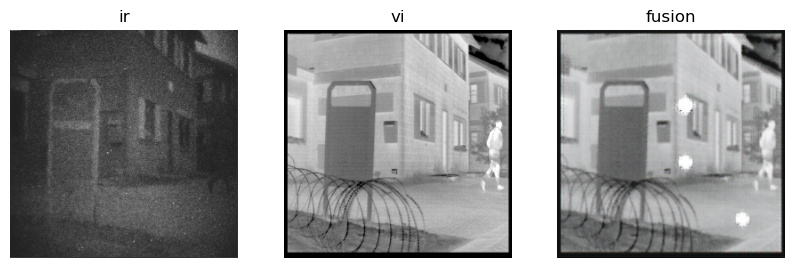

Epoch: 3150 D_epoch_loss: 0.40134862065315247 G_epoch_loss: 5.797540187835693
Epoch: 3151 D_epoch_loss: 0.14385852217674255 G_epoch_loss: 5.3336591720581055
Epoch: 3152 D_epoch_loss: 0.07675223797559738 G_epoch_loss: 4.35287618637085
Epoch: 3153 D_epoch_loss: 0.12123344838619232 G_epoch_loss: 2.596890449523926
Epoch: 3154 D_epoch_loss: 0.5510233044624329 G_epoch_loss: 0.9812509417533875
Epoch: 3155 D_epoch_loss: 0.3254517614841461 G_epoch_loss: 1.7492141723632812
Epoch: 3156 D_epoch_loss: 0.642894983291626 G_epoch_loss: 1.3705360889434814
Epoch: 3157 D_epoch_loss: 0.3149937391281128 G_epoch_loss: 2.354573965072632
Epoch: 3158 D_epoch_loss: 0.5827940106391907 G_epoch_loss: 1.1259127855300903
Epoch: 3159 D_epoch_loss: 0.2601076364517212 G_epoch_loss: 1.9047173261642456
Epoch: 3160 D_epoch_loss: 0.8224716186523438 G_epoch_loss: 0.848203182220459
Epoch: 3161 D_epoch_loss: 0.2735821306705475 G_epoch_loss: 2.1833748817443848
Epoch: 3162 D_epoch_loss: 0.465217649936676 G_epoch_loss: 1.1636790

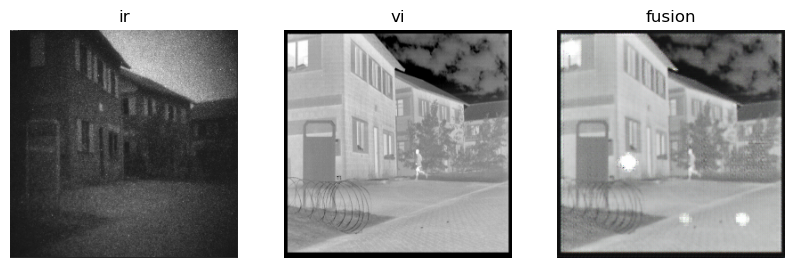

Epoch: 3197 D_epoch_loss: 0.331404447555542 G_epoch_loss: 2.3037807941436768
Epoch: 3198 D_epoch_loss: 0.3902255892753601 G_epoch_loss: 1.7254164218902588
Epoch: 3199 D_epoch_loss: 0.33693355321884155 G_epoch_loss: 1.514822006225586
Epoch: 3200 D_epoch_loss: 0.5523438453674316 G_epoch_loss: 0.8476172089576721
Epoch: 3201 D_epoch_loss: 0.6818317770957947 G_epoch_loss: 1.8564726114273071
Epoch: 3202 D_epoch_loss: 0.2341388761997223 G_epoch_loss: 2.8728067874908447
Epoch: 3203 D_epoch_loss: 0.3301910161972046 G_epoch_loss: 1.6714154481887817
Epoch: 3204 D_epoch_loss: 0.2707207500934601 G_epoch_loss: 3.211507558822632
Epoch: 3205 D_epoch_loss: 0.1771811991930008 G_epoch_loss: 2.877305269241333
Epoch: 3206 D_epoch_loss: 0.5239750146865845 G_epoch_loss: 1.2635778188705444
Epoch: 3207 D_epoch_loss: 0.3274376392364502 G_epoch_loss: 1.7228704690933228
Epoch: 3208 D_epoch_loss: 0.2447456419467926 G_epoch_loss: 2.5598344802856445
Epoch: 3209 D_epoch_loss: 0.2006567269563675 G_epoch_loss: 4.725926

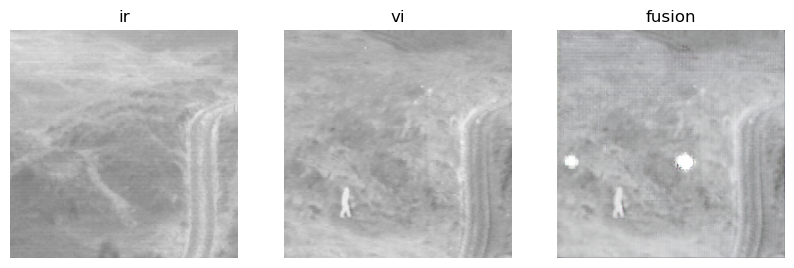

Epoch: 3244 D_epoch_loss: 0.40488898754119873 G_epoch_loss: 1.646769642829895
Epoch: 3245 D_epoch_loss: 0.6857006549835205 G_epoch_loss: 3.443573236465454
Epoch: 3246 D_epoch_loss: 0.2034543752670288 G_epoch_loss: 2.001227617263794
Epoch: 3247 D_epoch_loss: 0.5843599438667297 G_epoch_loss: 0.9056035280227661
Epoch: 3248 D_epoch_loss: 0.9824836254119873 G_epoch_loss: 0.6210001707077026
Epoch: 3249 D_epoch_loss: 0.33835795521736145 G_epoch_loss: 1.5843077898025513
Epoch: 3250 D_epoch_loss: 0.4440908133983612 G_epoch_loss: 1.3939132690429688
Epoch: 3251 D_epoch_loss: 0.66359543800354 G_epoch_loss: 1.1036787033081055
Epoch: 3252 D_epoch_loss: 0.5771940350532532 G_epoch_loss: 1.0530664920806885
Epoch: 3253 D_epoch_loss: 0.48855626583099365 G_epoch_loss: 1.210470199584961
Epoch: 3254 D_epoch_loss: 0.6163599491119385 G_epoch_loss: 1.3107202053070068
Epoch: 3255 D_epoch_loss: 0.6190618872642517 G_epoch_loss: 1.0643525123596191
Epoch: 3256 D_epoch_loss: 0.5603338479995728 G_epoch_loss: 1.228482

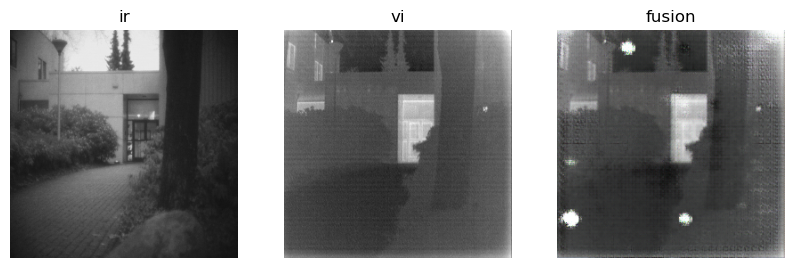

Epoch: 3291 D_epoch_loss: 0.5917877554893494 G_epoch_loss: 0.8877830505371094
Epoch: 3292 D_epoch_loss: 0.8787351250648499 G_epoch_loss: 1.2305399179458618
Epoch: 3293 D_epoch_loss: 0.6975419521331787 G_epoch_loss: 1.0738474130630493
Epoch: 3294 D_epoch_loss: 0.5864441394805908 G_epoch_loss: 1.0665857791900635
Epoch: 3295 D_epoch_loss: 0.6150437593460083 G_epoch_loss: 1.1871163845062256
Epoch: 3296 D_epoch_loss: 0.6316643953323364 G_epoch_loss: 1.246889352798462
Epoch: 3297 D_epoch_loss: 0.6113042831420898 G_epoch_loss: 1.0192474126815796
Epoch: 3298 D_epoch_loss: 0.649234414100647 G_epoch_loss: 1.002138614654541
Epoch: 3299 D_epoch_loss: 0.6754301190376282 G_epoch_loss: 0.9949731230735779
Epoch: 3300 D_epoch_loss: 0.6675382852554321 G_epoch_loss: 0.9641565680503845
Epoch: 3301 D_epoch_loss: 0.6134668588638306 G_epoch_loss: 1.0844240188598633
Epoch: 3302 D_epoch_loss: 0.6698071956634521 G_epoch_loss: 1.1123590469360352
Epoch: 3303 D_epoch_loss: 0.6803286671638489 G_epoch_loss: 0.936326

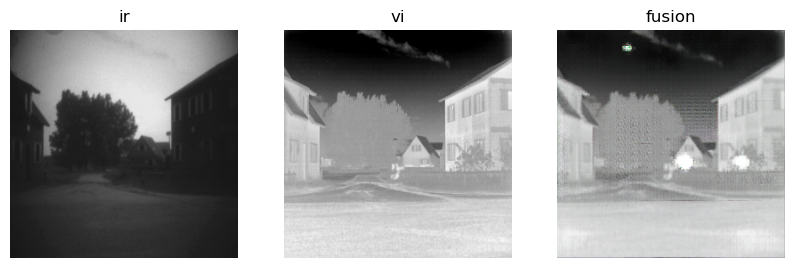

Epoch: 3338 D_epoch_loss: 1.788266897201538 G_epoch_loss: 2.440549373626709
Epoch: 3339 D_epoch_loss: 1.9920837879180908 G_epoch_loss: 5.24589729309082
Epoch: 3340 D_epoch_loss: 0.8078586459159851 G_epoch_loss: 3.2568447589874268
Epoch: 3341 D_epoch_loss: 1.4254618883132935 G_epoch_loss: 0.9737711548805237
Epoch: 3342 D_epoch_loss: 1.4355266094207764 G_epoch_loss: 1.5878088474273682
Epoch: 3343 D_epoch_loss: 1.5216100215911865 G_epoch_loss: 1.3270567655563354
Epoch: 3344 D_epoch_loss: 1.248076319694519 G_epoch_loss: 1.39932119846344
Epoch: 3345 D_epoch_loss: 1.1110950708389282 G_epoch_loss: 1.578075647354126
Epoch: 3346 D_epoch_loss: 1.0727331638336182 G_epoch_loss: 1.7080310583114624
Epoch: 3347 D_epoch_loss: 1.185319185256958 G_epoch_loss: 1.7508106231689453
Epoch: 3348 D_epoch_loss: 1.2538995742797852 G_epoch_loss: 1.5686655044555664
Epoch: 3349 D_epoch_loss: 1.404708743095398 G_epoch_loss: 1.5273996591567993
Epoch: 3350 D_epoch_loss: 1.1517431735992432 G_epoch_loss: 1.7599560022354

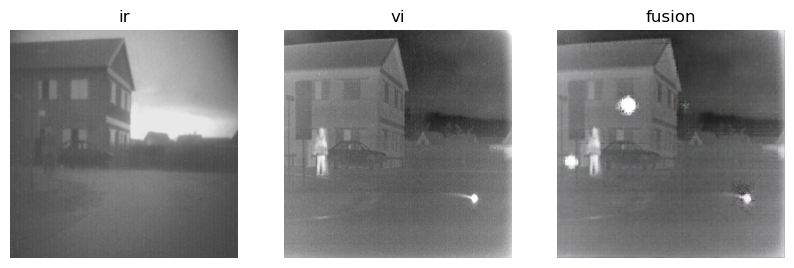

Epoch: 3385 D_epoch_loss: 1.5473520755767822 G_epoch_loss: 4.123727321624756
Epoch: 3386 D_epoch_loss: 1.1304612159729004 G_epoch_loss: 2.7916617393493652
Epoch: 3387 D_epoch_loss: 0.9594058990478516 G_epoch_loss: 2.5121407508850098
Epoch: 3388 D_epoch_loss: 1.517332911491394 G_epoch_loss: 2.8933568000793457
Epoch: 3389 D_epoch_loss: 0.9676612615585327 G_epoch_loss: 2.6238627433776855
Epoch: 3390 D_epoch_loss: 1.060190200805664 G_epoch_loss: 4.192455768585205
Epoch: 3391 D_epoch_loss: 0.6028643846511841 G_epoch_loss: 4.925596237182617
Epoch: 3392 D_epoch_loss: 0.6953043341636658 G_epoch_loss: 2.132471799850464
Epoch: 3393 D_epoch_loss: 0.5829671621322632 G_epoch_loss: 3.1742708683013916
Epoch: 3394 D_epoch_loss: 0.685172438621521 G_epoch_loss: 1.787068247795105
Epoch: 3395 D_epoch_loss: 0.6812613010406494 G_epoch_loss: 1.6822386980056763
Epoch: 3396 D_epoch_loss: 0.6644690036773682 G_epoch_loss: 3.761453151702881
Epoch: 3397 D_epoch_loss: 0.494393914937973 G_epoch_loss: 2.1807746887207

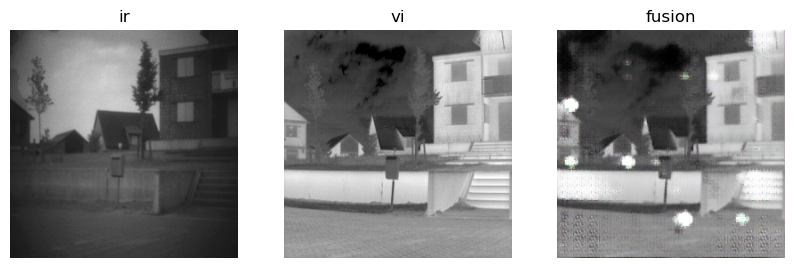

Epoch: 3432 D_epoch_loss: 0.42026400566101074 G_epoch_loss: 2.192326545715332
Epoch: 3433 D_epoch_loss: 0.9402458667755127 G_epoch_loss: 0.9502549171447754
Epoch: 3434 D_epoch_loss: 0.2395278662443161 G_epoch_loss: 3.0359132289886475
Epoch: 3435 D_epoch_loss: 0.6078324317932129 G_epoch_loss: 1.0383292436599731
Epoch: 3436 D_epoch_loss: 0.9012553095817566 G_epoch_loss: 1.7258883714675903
Epoch: 3437 D_epoch_loss: 0.28492334485054016 G_epoch_loss: 2.4854955673217773
Epoch: 3438 D_epoch_loss: 0.7715206742286682 G_epoch_loss: 0.8103157877922058
Epoch: 3439 D_epoch_loss: 0.5204492211341858 G_epoch_loss: 1.601789951324463
Epoch: 3440 D_epoch_loss: 0.4827578067779541 G_epoch_loss: 1.602001667022705
Epoch: 3441 D_epoch_loss: 0.7279603481292725 G_epoch_loss: 1.0052449703216553
Epoch: 3442 D_epoch_loss: 0.7921546697616577 G_epoch_loss: 1.1905198097229004
Epoch: 3443 D_epoch_loss: 0.6266502737998962 G_epoch_loss: 1.2526485919952393
Epoch: 3444 D_epoch_loss: 0.6374666094779968 G_epoch_loss: 1.4019

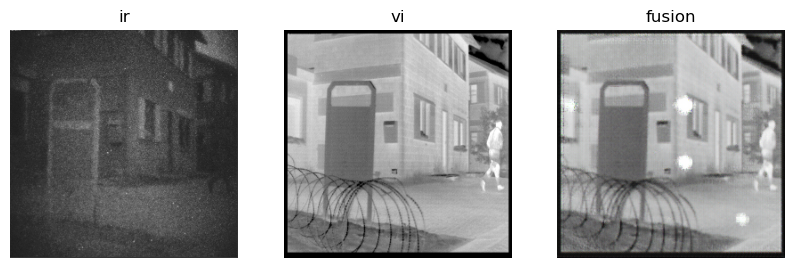

Epoch: 3479 D_epoch_loss: 0.5448575019836426 G_epoch_loss: 1.1852341890335083
Epoch: 3480 D_epoch_loss: 0.5222686529159546 G_epoch_loss: 1.1270091533660889
Epoch: 3481 D_epoch_loss: 0.5190654993057251 G_epoch_loss: 2.2897837162017822
Epoch: 3482 D_epoch_loss: 0.38305115699768066 G_epoch_loss: 2.7610065937042236
Epoch: 3483 D_epoch_loss: 0.30619746446609497 G_epoch_loss: 3.167703866958618
Epoch: 3484 D_epoch_loss: 0.5619294047355652 G_epoch_loss: 1.106493353843689
Epoch: 3485 D_epoch_loss: 0.24610839784145355 G_epoch_loss: 4.391692638397217
Epoch: 3486 D_epoch_loss: 0.42832785844802856 G_epoch_loss: 2.326789379119873
Epoch: 3487 D_epoch_loss: 0.29838240146636963 G_epoch_loss: 4.49822473526001
Epoch: 3488 D_epoch_loss: 0.2339801788330078 G_epoch_loss: 4.256640434265137
Epoch: 3489 D_epoch_loss: 0.17554181814193726 G_epoch_loss: 4.903532981872559
Epoch: 3490 D_epoch_loss: 0.2185499370098114 G_epoch_loss: 4.305888652801514
Epoch: 3491 D_epoch_loss: 0.19845256209373474 G_epoch_loss: 3.56801

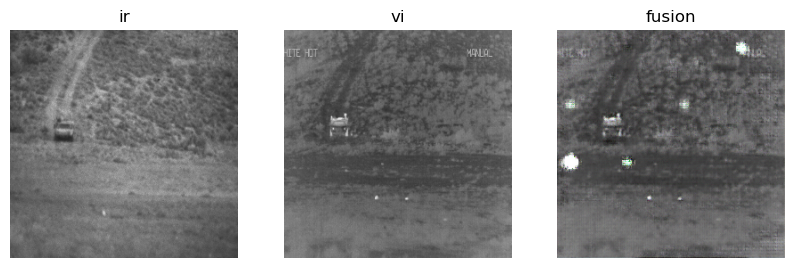

Epoch: 3526 D_epoch_loss: 0.1106342002749443 G_epoch_loss: 3.8837761878967285
Epoch: 3527 D_epoch_loss: 0.27699562907218933 G_epoch_loss: 1.648152232170105
Epoch: 3528 D_epoch_loss: 0.12587669491767883 G_epoch_loss: 2.915524959564209
Epoch: 3529 D_epoch_loss: 0.2753523290157318 G_epoch_loss: 4.815819263458252
Epoch: 3530 D_epoch_loss: 0.33227449655532837 G_epoch_loss: 3.9031617641448975
Epoch: 3531 D_epoch_loss: 0.34639495611190796 G_epoch_loss: 1.4529731273651123
Epoch: 3532 D_epoch_loss: 0.17869466543197632 G_epoch_loss: 2.9301750659942627
Epoch: 3533 D_epoch_loss: 0.6005878448486328 G_epoch_loss: 1.4454668760299683
Epoch: 3534 D_epoch_loss: 0.32017451524734497 G_epoch_loss: 1.4588098526000977
Epoch: 3535 D_epoch_loss: 0.2135046273469925 G_epoch_loss: 2.0581154823303223
Epoch: 3536 D_epoch_loss: 0.804934561252594 G_epoch_loss: 0.7179992198944092
Epoch: 3537 D_epoch_loss: 0.6430809497833252 G_epoch_loss: 2.13472056388855
Epoch: 3538 D_epoch_loss: 0.3544597327709198 G_epoch_loss: 1.530

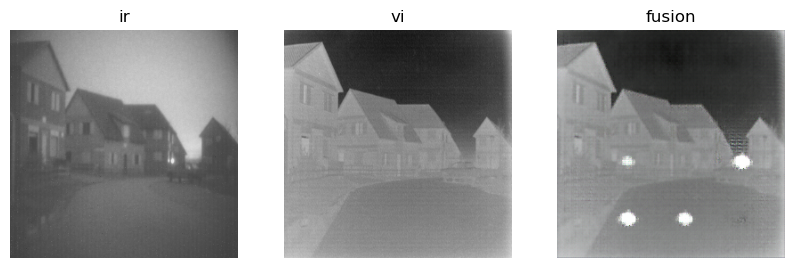

Epoch: 3573 D_epoch_loss: 0.4928179979324341 G_epoch_loss: 1.2524842023849487
Epoch: 3574 D_epoch_loss: 0.4376165568828583 G_epoch_loss: 2.287776231765747
Epoch: 3575 D_epoch_loss: 0.3171098828315735 G_epoch_loss: 1.6417593955993652
Epoch: 3576 D_epoch_loss: 0.2532523572444916 G_epoch_loss: 2.5096633434295654
Epoch: 3577 D_epoch_loss: 0.29913416504859924 G_epoch_loss: 2.1447906494140625
Epoch: 3578 D_epoch_loss: 0.7160375118255615 G_epoch_loss: 4.611495018005371
Epoch: 3579 D_epoch_loss: 1.6315726041793823 G_epoch_loss: 6.9320268630981445
Epoch: 3580 D_epoch_loss: 0.696883499622345 G_epoch_loss: 1.8091024160385132
Epoch: 3581 D_epoch_loss: 1.1606184244155884 G_epoch_loss: 1.2813705205917358
Epoch: 3582 D_epoch_loss: 0.4730040729045868 G_epoch_loss: 2.5836946964263916
Epoch: 3583 D_epoch_loss: 0.6011093854904175 G_epoch_loss: 4.0718207359313965
Epoch: 3584 D_epoch_loss: 0.6798381209373474 G_epoch_loss: 1.1611690521240234
Epoch: 3585 D_epoch_loss: 0.5720360279083252 G_epoch_loss: 2.36612

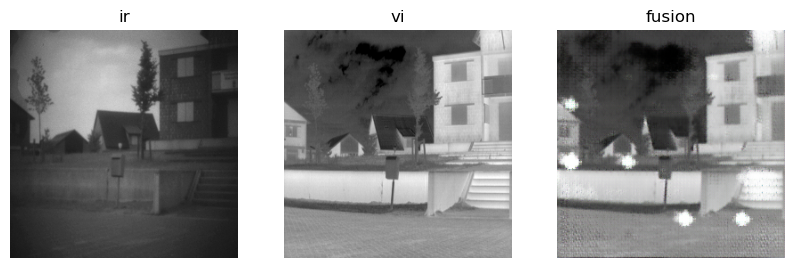

Epoch: 3620 D_epoch_loss: 0.8584593534469604 G_epoch_loss: 1.4718259572982788
Epoch: 3621 D_epoch_loss: 1.2153191566467285 G_epoch_loss: 1.3683546781539917
Epoch: 3622 D_epoch_loss: 1.2283132076263428 G_epoch_loss: 1.904443621635437
Epoch: 3623 D_epoch_loss: 1.500923991203308 G_epoch_loss: 2.045342206954956
Epoch: 3624 D_epoch_loss: 1.2836979627609253 G_epoch_loss: 2.1024487018585205
Epoch: 3625 D_epoch_loss: 0.9476929903030396 G_epoch_loss: 1.9190305471420288
Epoch: 3626 D_epoch_loss: 0.9586320519447327 G_epoch_loss: 4.15608549118042
Epoch: 3627 D_epoch_loss: 0.5932344794273376 G_epoch_loss: 2.617946147918701
Epoch: 3628 D_epoch_loss: 1.2164747714996338 G_epoch_loss: 0.7950702905654907
Epoch: 3629 D_epoch_loss: 1.861680269241333 G_epoch_loss: 1.9335246086120605
Epoch: 3630 D_epoch_loss: 0.5374153852462769 G_epoch_loss: 3.5848448276519775
Epoch: 3631 D_epoch_loss: 0.6769963502883911 G_epoch_loss: 1.3077396154403687
Epoch: 3632 D_epoch_loss: 0.8247989416122437 G_epoch_loss: 1.3656669855

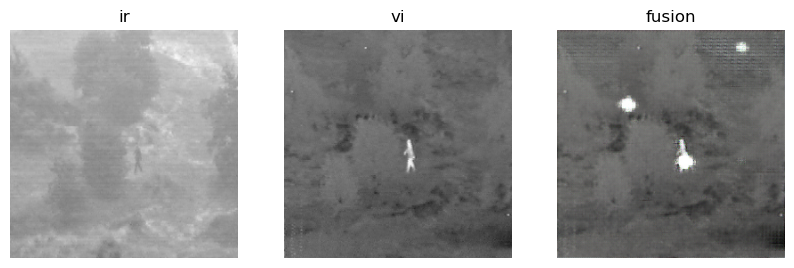

Epoch: 3667 D_epoch_loss: 0.7500536441802979 G_epoch_loss: 1.1037342548370361
Epoch: 3668 D_epoch_loss: 0.8253191709518433 G_epoch_loss: 1.0507774353027344
Epoch: 3669 D_epoch_loss: 0.7084301710128784 G_epoch_loss: 1.7080529928207397
Epoch: 3670 D_epoch_loss: 0.8428598046302795 G_epoch_loss: 0.6850200295448303
Epoch: 3671 D_epoch_loss: 0.7035300135612488 G_epoch_loss: 1.1763514280319214
Epoch: 3672 D_epoch_loss: 0.7390171885490417 G_epoch_loss: 1.3010082244873047
Epoch: 3673 D_epoch_loss: 0.6850405931472778 G_epoch_loss: 0.9540865421295166
Epoch: 3674 D_epoch_loss: 0.6434073448181152 G_epoch_loss: 1.1344480514526367
Epoch: 3675 D_epoch_loss: 0.6677939891815186 G_epoch_loss: 1.2173844575881958
Epoch: 3676 D_epoch_loss: 0.6559515595436096 G_epoch_loss: 1.0910862684249878
Epoch: 3677 D_epoch_loss: 0.633575975894928 G_epoch_loss: 1.2832632064819336
Epoch: 3678 D_epoch_loss: 0.5253719091415405 G_epoch_loss: 1.416116714477539
Epoch: 3679 D_epoch_loss: 0.4143711030483246 G_epoch_loss: 2.54843

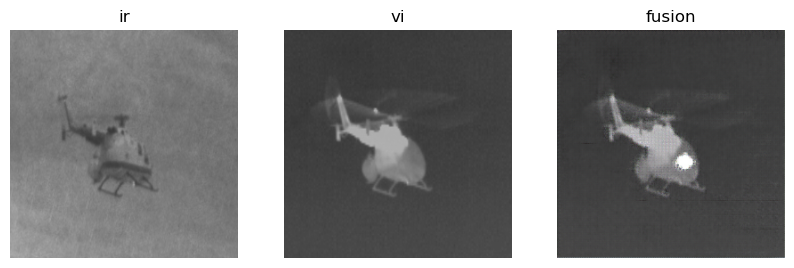

Epoch: 3714 D_epoch_loss: 0.1874903291463852 G_epoch_loss: 3.080141305923462
Epoch: 3715 D_epoch_loss: 0.2301347851753235 G_epoch_loss: 2.278707265853882
Epoch: 3716 D_epoch_loss: 0.2627140283584595 G_epoch_loss: 2.493602752685547
Epoch: 3717 D_epoch_loss: 0.26516127586364746 G_epoch_loss: 2.468503713607788
Epoch: 3718 D_epoch_loss: 0.37320244312286377 G_epoch_loss: 4.180024147033691
Epoch: 3719 D_epoch_loss: 1.259442687034607 G_epoch_loss: 5.256195545196533
Epoch: 3720 D_epoch_loss: 2.0082571506500244 G_epoch_loss: 0.9711921811103821
Epoch: 3721 D_epoch_loss: 2.5542783737182617 G_epoch_loss: 2.97963809967041
Epoch: 3722 D_epoch_loss: 1.8679133653640747 G_epoch_loss: 1.387770414352417
Epoch: 3723 D_epoch_loss: 1.6473166942596436 G_epoch_loss: 0.6555824875831604
Epoch: 3724 D_epoch_loss: 1.1548775434494019 G_epoch_loss: 1.3177956342697144
Epoch: 3725 D_epoch_loss: 1.5551470518112183 G_epoch_loss: 2.4961795806884766
Epoch: 3726 D_epoch_loss: 1.0825133323669434 G_epoch_loss: 1.80001509189

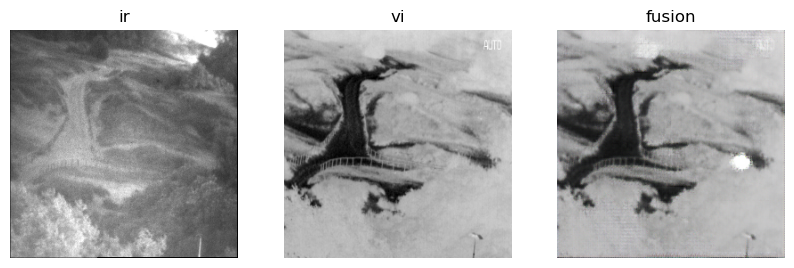

Epoch: 3761 D_epoch_loss: 0.683670699596405 G_epoch_loss: 0.9986891746520996
Epoch: 3762 D_epoch_loss: 0.7313769459724426 G_epoch_loss: 1.4065499305725098
Epoch: 3763 D_epoch_loss: 0.6673130989074707 G_epoch_loss: 0.8471719026565552
Epoch: 3764 D_epoch_loss: 0.5564813017845154 G_epoch_loss: 1.5432415008544922
Epoch: 3765 D_epoch_loss: 0.5886157155036926 G_epoch_loss: 1.9854462146759033
Epoch: 3766 D_epoch_loss: 0.17545439302921295 G_epoch_loss: 3.150291919708252
Epoch: 3767 D_epoch_loss: 0.5578707456588745 G_epoch_loss: 0.9694293141365051
Epoch: 3768 D_epoch_loss: 0.3279256224632263 G_epoch_loss: 3.6926581859588623
Epoch: 3769 D_epoch_loss: 0.12865714728832245 G_epoch_loss: 5.702978134155273
Epoch: 3770 D_epoch_loss: 0.10360292345285416 G_epoch_loss: 5.082030773162842
Epoch: 3771 D_epoch_loss: 0.1617201864719391 G_epoch_loss: 3.3587214946746826
Epoch: 3772 D_epoch_loss: 0.21740864217281342 G_epoch_loss: 2.0636038780212402
Epoch: 3773 D_epoch_loss: 0.5740270018577576 G_epoch_loss: 0.940

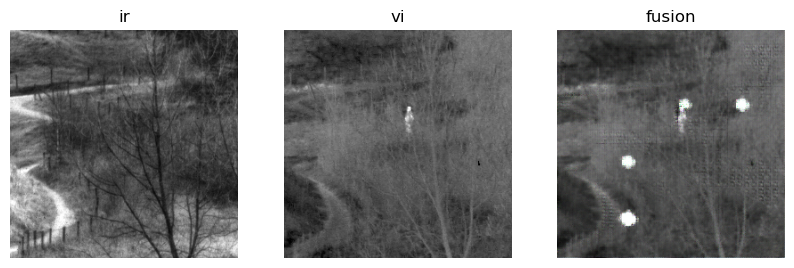

Epoch: 3808 D_epoch_loss: 0.5891599655151367 G_epoch_loss: 1.6392382383346558
Epoch: 3809 D_epoch_loss: 0.5840962529182434 G_epoch_loss: 1.3637148141860962
Epoch: 3810 D_epoch_loss: 0.5983791947364807 G_epoch_loss: 1.5571739673614502
Epoch: 3811 D_epoch_loss: 0.5382870435714722 G_epoch_loss: 1.4605106115341187
Epoch: 3812 D_epoch_loss: 0.6384914517402649 G_epoch_loss: 1.340886116027832
Epoch: 3813 D_epoch_loss: 0.5113549828529358 G_epoch_loss: 1.3593146800994873
Epoch: 3814 D_epoch_loss: 0.36454999446868896 G_epoch_loss: 3.402918815612793
Epoch: 3815 D_epoch_loss: 0.34528031945228577 G_epoch_loss: 1.5667601823806763
Epoch: 3816 D_epoch_loss: 0.6488605737686157 G_epoch_loss: 0.7564436793327332
Epoch: 3817 D_epoch_loss: 0.42493554949760437 G_epoch_loss: 2.2055399417877197
Epoch: 3818 D_epoch_loss: 0.3492578864097595 G_epoch_loss: 4.754936695098877
Epoch: 3819 D_epoch_loss: 0.3284808099269867 G_epoch_loss: 1.5821245908737183
Epoch: 3820 D_epoch_loss: 0.5040220022201538 G_epoch_loss: 1.159

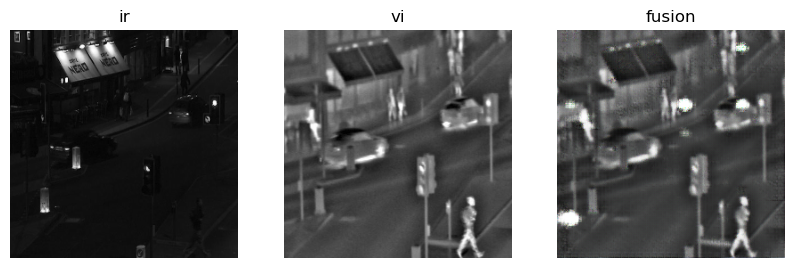

Epoch: 3855 D_epoch_loss: 0.875625729560852 G_epoch_loss: 3.3362014293670654
Epoch: 3856 D_epoch_loss: 0.5024105906486511 G_epoch_loss: 3.169699192047119
Epoch: 3857 D_epoch_loss: 0.5186367630958557 G_epoch_loss: 0.9392138719558716
Epoch: 3858 D_epoch_loss: 0.18550154566764832 G_epoch_loss: 2.3401734828948975
Epoch: 3859 D_epoch_loss: 0.40120455622673035 G_epoch_loss: 1.1467339992523193
Epoch: 3860 D_epoch_loss: 0.7026249170303345 G_epoch_loss: 0.7463786602020264
Epoch: 3861 D_epoch_loss: 0.9613919854164124 G_epoch_loss: 1.1405539512634277
Epoch: 3862 D_epoch_loss: 0.7171916365623474 G_epoch_loss: 0.9397351741790771
Epoch: 3863 D_epoch_loss: 0.4208384156227112 G_epoch_loss: 1.5888078212738037
Epoch: 3864 D_epoch_loss: 0.5482325553894043 G_epoch_loss: 1.0188870429992676
Epoch: 3865 D_epoch_loss: 0.6434816122055054 G_epoch_loss: 0.8911424875259399
Epoch: 3866 D_epoch_loss: 0.8154719471931458 G_epoch_loss: 1.0365586280822754
Epoch: 3867 D_epoch_loss: 0.5631642937660217 G_epoch_loss: 1.169

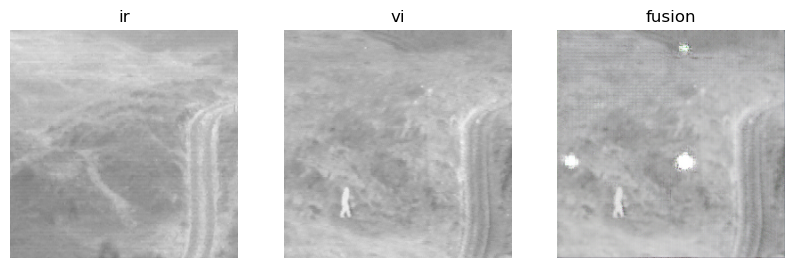

Epoch: 3902 D_epoch_loss: 0.3608192503452301 G_epoch_loss: 1.7693464756011963
Epoch: 3903 D_epoch_loss: 0.2061193436384201 G_epoch_loss: 4.751595973968506
Epoch: 3904 D_epoch_loss: 0.1468852162361145 G_epoch_loss: 2.6995339393615723
Epoch: 3905 D_epoch_loss: 0.15067210793495178 G_epoch_loss: 2.800485134124756
Epoch: 3906 D_epoch_loss: 0.09531949460506439 G_epoch_loss: 4.980999946594238
Epoch: 3907 D_epoch_loss: 0.12484348565340042 G_epoch_loss: 3.63797664642334
Epoch: 3908 D_epoch_loss: 0.32044920325279236 G_epoch_loss: 1.4447520971298218
Epoch: 3909 D_epoch_loss: 0.2191615253686905 G_epoch_loss: 2.0306763648986816
Epoch: 3910 D_epoch_loss: 0.2668024003505707 G_epoch_loss: 4.712287425994873
Epoch: 3911 D_epoch_loss: 0.11157491058111191 G_epoch_loss: 4.175530433654785
Epoch: 3912 D_epoch_loss: 0.150596484541893 G_epoch_loss: 2.8068532943725586
Epoch: 3913 D_epoch_loss: 0.46174687147140503 G_epoch_loss: 1.1338322162628174
Epoch: 3914 D_epoch_loss: 0.2388278841972351 G_epoch_loss: 2.18450

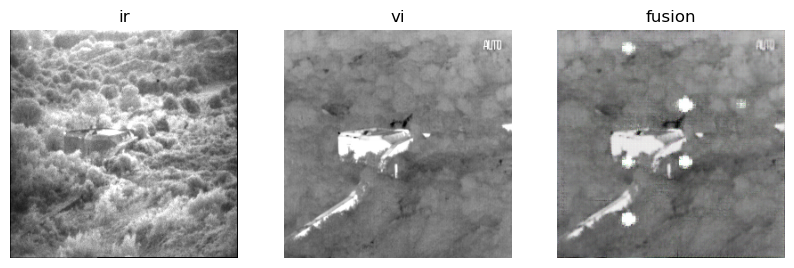

Epoch: 3949 D_epoch_loss: 0.6492462754249573 G_epoch_loss: 1.259942889213562
Epoch: 3950 D_epoch_loss: 0.6328296065330505 G_epoch_loss: 0.8012458682060242
Epoch: 3951 D_epoch_loss: 0.6472780108451843 G_epoch_loss: 1.0495197772979736
Epoch: 3952 D_epoch_loss: 0.6802805066108704 G_epoch_loss: 1.1926374435424805
Epoch: 3953 D_epoch_loss: 0.6167570948600769 G_epoch_loss: 0.9368236660957336
Epoch: 3954 D_epoch_loss: 0.576431393623352 G_epoch_loss: 1.0904169082641602
Epoch: 3955 D_epoch_loss: 0.6139704585075378 G_epoch_loss: 1.3553999662399292
Epoch: 3956 D_epoch_loss: 0.6580673456192017 G_epoch_loss: 0.8950621485710144
Epoch: 3957 D_epoch_loss: 0.6185044646263123 G_epoch_loss: 1.2421724796295166
Epoch: 3958 D_epoch_loss: 0.5976747870445251 G_epoch_loss: 0.90938800573349
Epoch: 3959 D_epoch_loss: 0.6128910779953003 G_epoch_loss: 1.2740769386291504
Epoch: 3960 D_epoch_loss: 0.5403799414634705 G_epoch_loss: 1.3308073282241821
Epoch: 3961 D_epoch_loss: 0.34346115589141846 G_epoch_loss: 2.539993

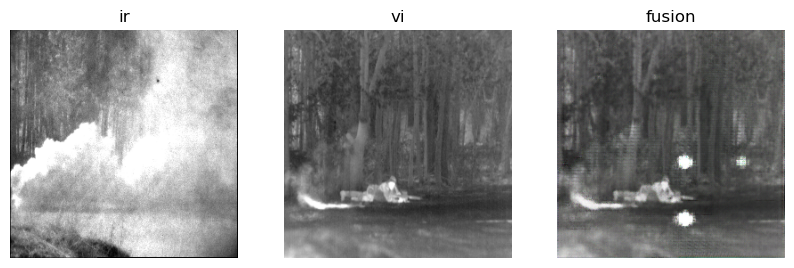

Epoch: 3996 D_epoch_loss: 0.5119726061820984 G_epoch_loss: 1.0718876123428345
Epoch: 3997 D_epoch_loss: 0.559280276298523 G_epoch_loss: 1.2090386152267456
Epoch: 3998 D_epoch_loss: 0.6801645755767822 G_epoch_loss: 1.384250521659851
Epoch: 3999 D_epoch_loss: 0.5454602837562561 G_epoch_loss: 1.1220568418502808
Epoch: 4000 D_epoch_loss: 0.7641904354095459 G_epoch_loss: 1.1338272094726562
Epoch: 4001 D_epoch_loss: 0.3387976288795471 G_epoch_loss: 1.7941974401474
Epoch: 4002 D_epoch_loss: 0.21327847242355347 G_epoch_loss: 4.489130973815918
Epoch: 4003 D_epoch_loss: 0.5579789876937866 G_epoch_loss: 0.8712430000305176
Epoch: 4004 D_epoch_loss: 0.20198696851730347 G_epoch_loss: 3.6091725826263428
Epoch: 4005 D_epoch_loss: 0.17385262250900269 G_epoch_loss: 4.259190559387207
Epoch: 4006 D_epoch_loss: 0.3561262786388397 G_epoch_loss: 1.4244788885116577
Epoch: 4007 D_epoch_loss: 0.2950546443462372 G_epoch_loss: 1.9324367046356201
Epoch: 4008 D_epoch_loss: 0.20405049622058868 G_epoch_loss: 4.306890

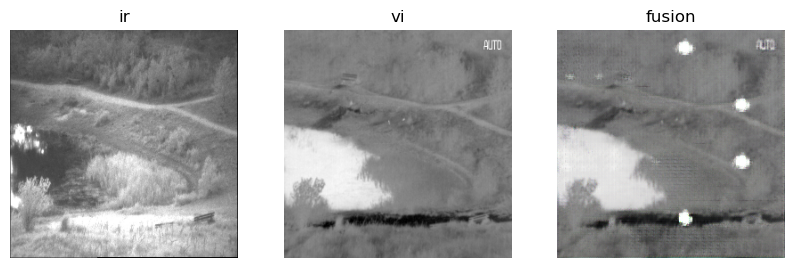

Epoch: 4043 D_epoch_loss: 0.23117803037166595 G_epoch_loss: 2.4968340396881104
Epoch: 4044 D_epoch_loss: 0.31031113862991333 G_epoch_loss: 1.6404361724853516
Epoch: 4045 D_epoch_loss: 0.22664344310760498 G_epoch_loss: 3.008784532546997
Epoch: 4046 D_epoch_loss: 0.22702425718307495 G_epoch_loss: 3.190114736557007
Epoch: 4047 D_epoch_loss: 0.1402367353439331 G_epoch_loss: 3.0373177528381348
Epoch: 4048 D_epoch_loss: 0.1968005895614624 G_epoch_loss: 2.244540214538574
Epoch: 4049 D_epoch_loss: 0.5033720135688782 G_epoch_loss: 0.951396644115448
Epoch: 4050 D_epoch_loss: 0.5569854378700256 G_epoch_loss: 2.427072048187256
Epoch: 4051 D_epoch_loss: 0.1390269696712494 G_epoch_loss: 4.899301052093506
Epoch: 4052 D_epoch_loss: 0.6888147592544556 G_epoch_loss: 0.7595946788787842
Epoch: 4053 D_epoch_loss: 0.22555948793888092 G_epoch_loss: 2.0326924324035645
Epoch: 4054 D_epoch_loss: 0.16175681352615356 G_epoch_loss: 5.41460657119751
Epoch: 4055 D_epoch_loss: 0.15234825015068054 G_epoch_loss: 4.6745

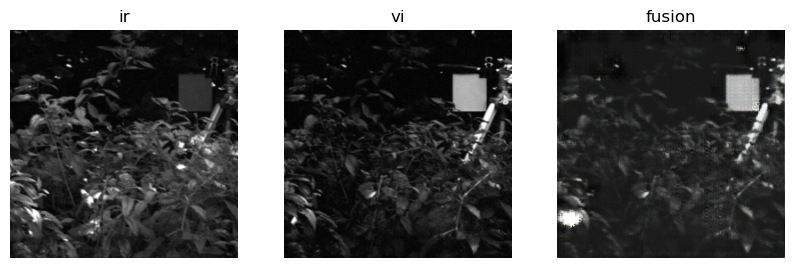

Epoch: 4090 D_epoch_loss: 0.17729352414608002 G_epoch_loss: 2.6690964698791504
Epoch: 4091 D_epoch_loss: 0.2066836655139923 G_epoch_loss: 3.1216564178466797
Epoch: 4092 D_epoch_loss: 0.39581355452537537 G_epoch_loss: 1.2575238943099976
Epoch: 4093 D_epoch_loss: 0.233888640999794 G_epoch_loss: 2.552406072616577
Epoch: 4094 D_epoch_loss: 0.1653718799352646 G_epoch_loss: 4.73261833190918
Epoch: 4095 D_epoch_loss: 0.1348278969526291 G_epoch_loss: 3.278639554977417
Epoch: 4096 D_epoch_loss: 0.35548725724220276 G_epoch_loss: 1.141126036643982
Epoch: 4097 D_epoch_loss: 0.19758863747119904 G_epoch_loss: 2.7315614223480225
Epoch: 4098 D_epoch_loss: 0.17951072752475739 G_epoch_loss: 5.434378623962402
Epoch: 4099 D_epoch_loss: 0.10281625390052795 G_epoch_loss: 3.832271099090576
Epoch: 4100 D_epoch_loss: 0.4231930375099182 G_epoch_loss: 1.0571247339248657
Epoch: 4101 D_epoch_loss: 0.20410819351673126 G_epoch_loss: 2.8861820697784424
Epoch: 4102 D_epoch_loss: 0.21974466741085052 G_epoch_loss: 3.133

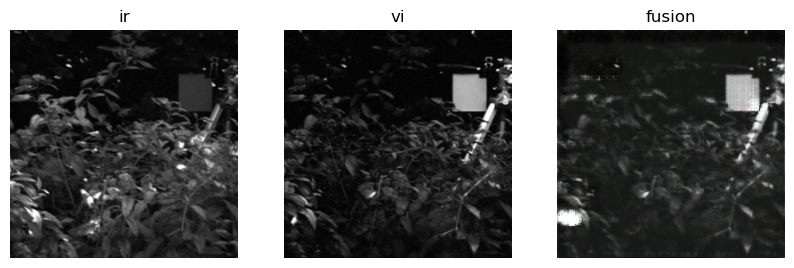

Epoch: 4137 D_epoch_loss: 0.4792550206184387 G_epoch_loss: 1.0656732320785522
Epoch: 4138 D_epoch_loss: 0.69049072265625 G_epoch_loss: 2.5905799865722656
Epoch: 4139 D_epoch_loss: 0.15753355622291565 G_epoch_loss: 5.257031440734863
Epoch: 4140 D_epoch_loss: 0.10626216232776642 G_epoch_loss: 4.107104778289795
Epoch: 4141 D_epoch_loss: 0.6845294833183289 G_epoch_loss: 0.6265949606895447
Epoch: 4142 D_epoch_loss: 0.38074401021003723 G_epoch_loss: 1.9198060035705566
Epoch: 4143 D_epoch_loss: 0.37485218048095703 G_epoch_loss: 1.4071305990219116
Epoch: 4144 D_epoch_loss: 0.3351224362850189 G_epoch_loss: 1.775765299797058
Epoch: 4145 D_epoch_loss: 0.39110592007637024 G_epoch_loss: 2.2294223308563232
Epoch: 4146 D_epoch_loss: 0.21869441866874695 G_epoch_loss: 2.2766730785369873
Epoch: 4147 D_epoch_loss: 0.12911710143089294 G_epoch_loss: 3.343749523162842
Epoch: 4148 D_epoch_loss: 0.10086484253406525 G_epoch_loss: 3.8433361053466797
Epoch: 4149 D_epoch_loss: 0.14035053551197052 G_epoch_loss: 2.

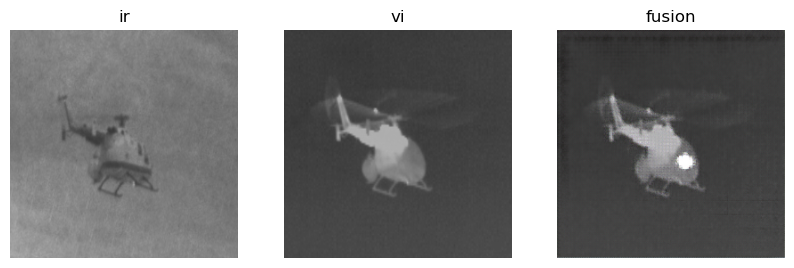

Epoch: 4184 D_epoch_loss: 0.06517814844846725 G_epoch_loss: 4.735602855682373
Epoch: 4185 D_epoch_loss: 0.16584254801273346 G_epoch_loss: 4.221339225769043
Epoch: 4186 D_epoch_loss: 0.05320759117603302 G_epoch_loss: 4.902493476867676
Epoch: 4187 D_epoch_loss: 0.09519057720899582 G_epoch_loss: 3.4821760654449463
Epoch: 4188 D_epoch_loss: 0.055996350944042206 G_epoch_loss: 4.531072616577148
Epoch: 4189 D_epoch_loss: 0.10290978103876114 G_epoch_loss: 2.981693744659424
Epoch: 4190 D_epoch_loss: 0.1182829737663269 G_epoch_loss: 2.4897327423095703
Epoch: 4191 D_epoch_loss: 0.10223844647407532 G_epoch_loss: 4.664027214050293
Epoch: 4192 D_epoch_loss: 0.14832110702991486 G_epoch_loss: 2.67558217048645
Epoch: 4193 D_epoch_loss: 0.1534884124994278 G_epoch_loss: 4.461577415466309
Epoch: 4194 D_epoch_loss: 0.23141281306743622 G_epoch_loss: 1.7287864685058594
Epoch: 4195 D_epoch_loss: 0.5575318932533264 G_epoch_loss: 2.7564964294433594
Epoch: 4196 D_epoch_loss: 1.6159217357635498 G_epoch_loss: 5.33

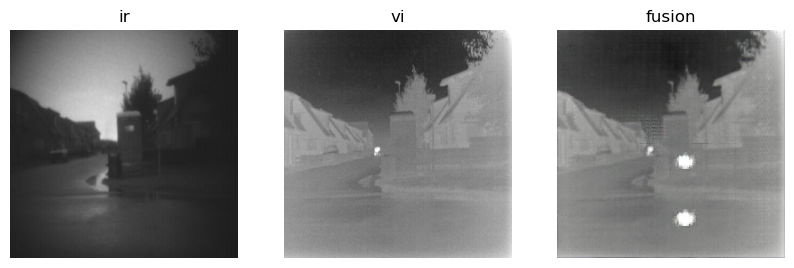

Epoch: 4231 D_epoch_loss: 0.825369656085968 G_epoch_loss: 0.4872540831565857
Epoch: 4232 D_epoch_loss: 0.8241450190544128 G_epoch_loss: 1.8844014406204224
Epoch: 4233 D_epoch_loss: 0.7153750658035278 G_epoch_loss: 0.6277075409889221
Epoch: 4234 D_epoch_loss: 0.6691739559173584 G_epoch_loss: 1.0156549215316772
Epoch: 4235 D_epoch_loss: 0.6910929679870605 G_epoch_loss: 1.3573846817016602
Epoch: 4236 D_epoch_loss: 0.6840803027153015 G_epoch_loss: 0.9444144368171692
Epoch: 4237 D_epoch_loss: 0.6471192836761475 G_epoch_loss: 0.9820393919944763
Epoch: 4238 D_epoch_loss: 0.7192666530609131 G_epoch_loss: 1.3223258256912231
Epoch: 4239 D_epoch_loss: 0.6267030835151672 G_epoch_loss: 0.8414663672447205
Epoch: 4240 D_epoch_loss: 0.6525280475616455 G_epoch_loss: 1.1649584770202637
Epoch: 4241 D_epoch_loss: 0.6340165138244629 G_epoch_loss: 1.0389935970306396
Epoch: 4242 D_epoch_loss: 0.6215540170669556 G_epoch_loss: 1.0277963876724243
Epoch: 4243 D_epoch_loss: 0.6165018081665039 G_epoch_loss: 1.0454

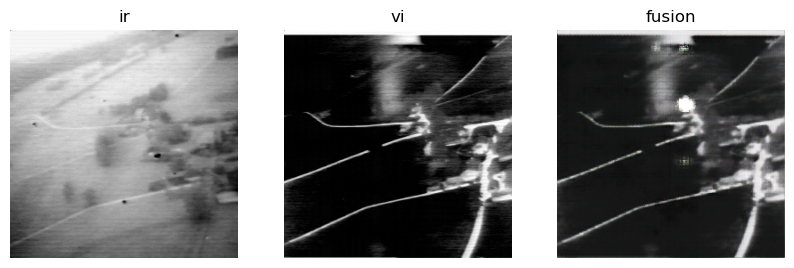

Epoch: 4278 D_epoch_loss: 0.6635667085647583 G_epoch_loss: 1.4791940450668335
Epoch: 4279 D_epoch_loss: 0.5930345058441162 G_epoch_loss: 0.9867649078369141
Epoch: 4280 D_epoch_loss: 0.5533326268196106 G_epoch_loss: 1.4449101686477661
Epoch: 4281 D_epoch_loss: 0.5136383771896362 G_epoch_loss: 1.146536946296692
Epoch: 4282 D_epoch_loss: 0.5122225284576416 G_epoch_loss: 1.5474570989608765
Epoch: 4283 D_epoch_loss: 0.45585009455680847 G_epoch_loss: 1.1840450763702393
Epoch: 4284 D_epoch_loss: 0.5766870975494385 G_epoch_loss: 2.3353159427642822
Epoch: 4285 D_epoch_loss: 0.5402812957763672 G_epoch_loss: 0.7835622429847717
Epoch: 4286 D_epoch_loss: 0.6880545616149902 G_epoch_loss: 1.262555718421936
Epoch: 4287 D_epoch_loss: 0.5548725128173828 G_epoch_loss: 1.3471084833145142
Epoch: 4288 D_epoch_loss: 0.2897965908050537 G_epoch_loss: 1.9484130144119263
Epoch: 4289 D_epoch_loss: 0.24133563041687012 G_epoch_loss: 2.8615546226501465
Epoch: 4290 D_epoch_loss: 0.34231501817703247 G_epoch_loss: 1.71

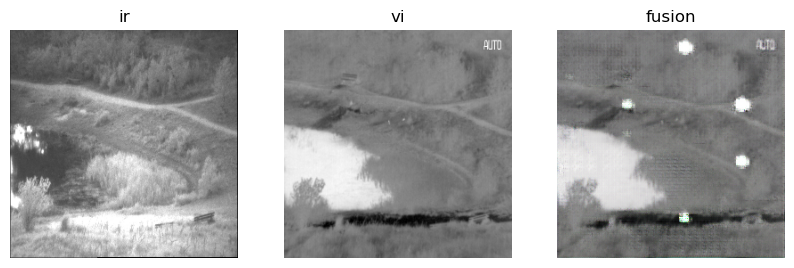

Epoch: 4325 D_epoch_loss: 0.7629789113998413 G_epoch_loss: 1.6849970817565918
Epoch: 4326 D_epoch_loss: 0.764595627784729 G_epoch_loss: 1.5907340049743652
Epoch: 4327 D_epoch_loss: 0.8588161468505859 G_epoch_loss: 1.3360905647277832
Epoch: 4328 D_epoch_loss: 0.9345794916152954 G_epoch_loss: 1.125770926475525
Epoch: 4329 D_epoch_loss: 0.8038738369941711 G_epoch_loss: 1.4426466226577759
Epoch: 4330 D_epoch_loss: 0.8863222002983093 G_epoch_loss: 1.2860395908355713
Epoch: 4331 D_epoch_loss: 0.78188157081604 G_epoch_loss: 1.4152429103851318
Epoch: 4332 D_epoch_loss: 0.8822306990623474 G_epoch_loss: 1.1552067995071411
Epoch: 4333 D_epoch_loss: 0.9988657832145691 G_epoch_loss: 1.4048113822937012
Epoch: 4334 D_epoch_loss: 1.018499493598938 G_epoch_loss: 1.1600943803787231
Epoch: 4335 D_epoch_loss: 1.0617934465408325 G_epoch_loss: 2.217258930206299
Epoch: 4336 D_epoch_loss: 0.866668164730072 G_epoch_loss: 1.05314302444458
Epoch: 4337 D_epoch_loss: 1.0033146142959595 G_epoch_loss: 1.940619587898

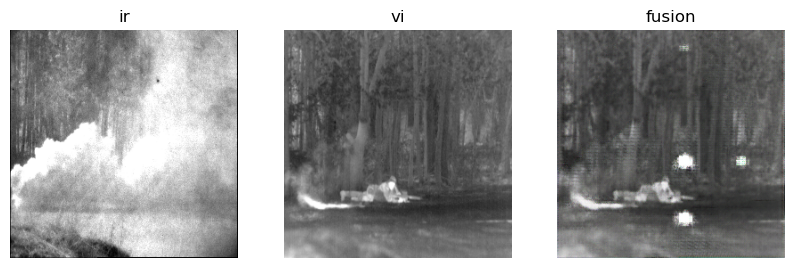

Epoch: 4372 D_epoch_loss: 0.8521475195884705 G_epoch_loss: 4.6909356117248535
Epoch: 4373 D_epoch_loss: 0.7882129549980164 G_epoch_loss: 2.4681806564331055
Epoch: 4374 D_epoch_loss: 0.5028464794158936 G_epoch_loss: 6.212741851806641
Epoch: 4375 D_epoch_loss: 0.4083690047264099 G_epoch_loss: 5.660815715789795
Epoch: 4376 D_epoch_loss: 0.41383570432662964 G_epoch_loss: 3.922006368637085
Epoch: 4377 D_epoch_loss: 0.8801759481430054 G_epoch_loss: 1.025428295135498
Epoch: 4378 D_epoch_loss: 0.9727867841720581 G_epoch_loss: 3.044658660888672
Epoch: 4379 D_epoch_loss: 0.5229665040969849 G_epoch_loss: 5.014594078063965
Epoch: 4380 D_epoch_loss: 0.5767337083816528 G_epoch_loss: 4.281798362731934
Epoch: 4381 D_epoch_loss: 0.4635730981826782 G_epoch_loss: 2.651486873626709
Epoch: 4382 D_epoch_loss: 0.6539971232414246 G_epoch_loss: 1.263100504875183
Epoch: 4383 D_epoch_loss: 0.9461090564727783 G_epoch_loss: 0.887562096118927
Epoch: 4384 D_epoch_loss: 0.9703067541122437 G_epoch_loss: 2.150001525878

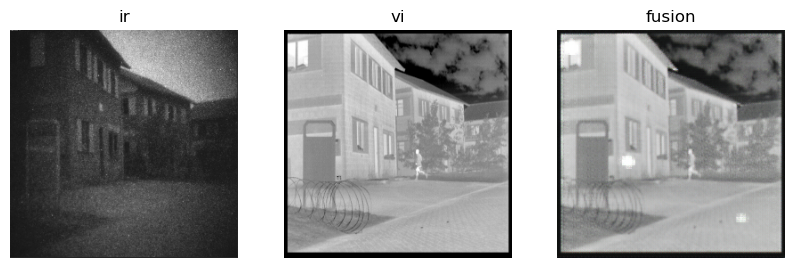

Epoch: 4419 D_epoch_loss: 0.21392574906349182 G_epoch_loss: 6.378713607788086
Epoch: 4420 D_epoch_loss: 0.3083556592464447 G_epoch_loss: 5.27457857131958
Epoch: 4421 D_epoch_loss: 0.23006366193294525 G_epoch_loss: 4.5770063400268555
Epoch: 4422 D_epoch_loss: 0.2322358638048172 G_epoch_loss: 3.0233216285705566
Epoch: 4423 D_epoch_loss: 0.38760071992874146 G_epoch_loss: 2.2240898609161377
Epoch: 4424 D_epoch_loss: 0.35416367650032043 G_epoch_loss: 2.335165023803711
Epoch: 4425 D_epoch_loss: 0.36856141686439514 G_epoch_loss: 2.996718406677246
Epoch: 4426 D_epoch_loss: 0.2769814729690552 G_epoch_loss: 3.2882347106933594
Epoch: 4427 D_epoch_loss: 0.3192509412765503 G_epoch_loss: 2.6390151977539062
Epoch: 4428 D_epoch_loss: 0.26929572224617004 G_epoch_loss: 5.191974639892578
Epoch: 4429 D_epoch_loss: 0.241634339094162 G_epoch_loss: 4.891360759735107
Epoch: 4430 D_epoch_loss: 0.2834364175796509 G_epoch_loss: 2.9191882610321045
Epoch: 4431 D_epoch_loss: 0.5547971129417419 G_epoch_loss: 1.15483

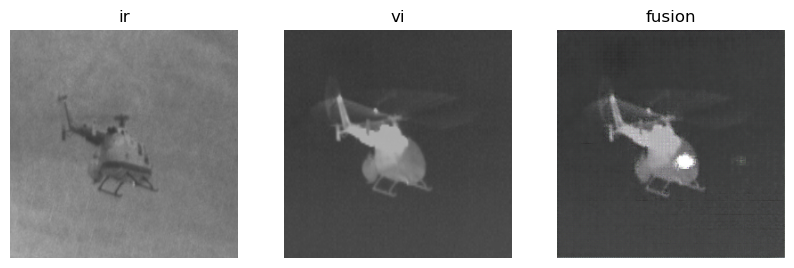

Epoch: 4466 D_epoch_loss: 0.7287498712539673 G_epoch_loss: 0.8905202150344849
Epoch: 4467 D_epoch_loss: 0.28299611806869507 G_epoch_loss: 1.9766180515289307
Epoch: 4468 D_epoch_loss: 0.44922932982444763 G_epoch_loss: 1.082984209060669
Epoch: 4469 D_epoch_loss: 0.5771182775497437 G_epoch_loss: 1.2283693552017212
Epoch: 4470 D_epoch_loss: 0.8694640398025513 G_epoch_loss: 1.5560762882232666
Epoch: 4471 D_epoch_loss: 0.7146483659744263 G_epoch_loss: 0.9518020749092102
Epoch: 4472 D_epoch_loss: 0.4611525535583496 G_epoch_loss: 1.577986240386963
Epoch: 4473 D_epoch_loss: 0.6251455545425415 G_epoch_loss: 0.9561682939529419
Epoch: 4474 D_epoch_loss: 0.7534925937652588 G_epoch_loss: 1.3964667320251465
Epoch: 4475 D_epoch_loss: 0.6943468451499939 G_epoch_loss: 0.9134219884872437
Epoch: 4476 D_epoch_loss: 0.5801005363464355 G_epoch_loss: 1.3537838459014893
Epoch: 4477 D_epoch_loss: 0.6632395386695862 G_epoch_loss: 1.3096011877059937
Epoch: 4478 D_epoch_loss: 0.6500686407089233 G_epoch_loss: 0.963

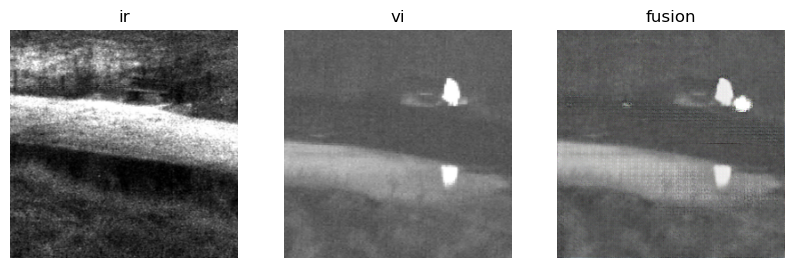

Epoch: 4513 D_epoch_loss: 0.13702481985092163 G_epoch_loss: 3.0188751220703125
Epoch: 4514 D_epoch_loss: 0.20469245314598083 G_epoch_loss: 2.340794801712036
Epoch: 4515 D_epoch_loss: 0.1553872525691986 G_epoch_loss: 3.760674238204956
Epoch: 4516 D_epoch_loss: 0.32070234417915344 G_epoch_loss: 1.4434523582458496
Epoch: 4517 D_epoch_loss: 0.21966004371643066 G_epoch_loss: 4.323440074920654
Epoch: 4518 D_epoch_loss: 0.1504160612821579 G_epoch_loss: 3.3051109313964844
Epoch: 4519 D_epoch_loss: 0.1868947446346283 G_epoch_loss: 2.6039345264434814
Epoch: 4520 D_epoch_loss: 0.10279408097267151 G_epoch_loss: 4.48563814163208
Epoch: 4521 D_epoch_loss: 0.44221025705337524 G_epoch_loss: 1.1481420993804932
Epoch: 4522 D_epoch_loss: 0.2463439702987671 G_epoch_loss: 3.8638460636138916
Epoch: 4523 D_epoch_loss: 0.1165812611579895 G_epoch_loss: 6.338351726531982
Epoch: 4524 D_epoch_loss: 0.20537368953227997 G_epoch_loss: 5.560417652130127
Epoch: 4525 D_epoch_loss: 0.13301007449626923 G_epoch_loss: 3.07

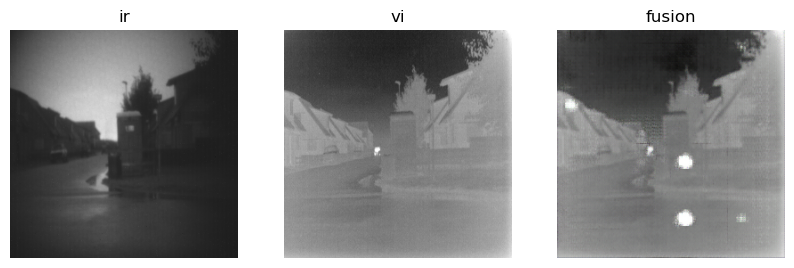

Epoch: 4560 D_epoch_loss: 0.7293813824653625 G_epoch_loss: 0.616864025592804
Epoch: 4561 D_epoch_loss: 0.4812118411064148 G_epoch_loss: 2.5408496856689453
Epoch: 4562 D_epoch_loss: 0.5269487500190735 G_epoch_loss: 1.0678906440734863
Epoch: 4563 D_epoch_loss: 0.2819885313510895 G_epoch_loss: 2.485088586807251
Epoch: 4564 D_epoch_loss: 0.3320502042770386 G_epoch_loss: 1.7771509885787964
Epoch: 4565 D_epoch_loss: 0.23199862241744995 G_epoch_loss: 2.5571889877319336
Epoch: 4566 D_epoch_loss: 0.1825350522994995 G_epoch_loss: 2.4199841022491455
Epoch: 4567 D_epoch_loss: 0.20594100654125214 G_epoch_loss: 2.155379295349121
Epoch: 4568 D_epoch_loss: 0.1537497192621231 G_epoch_loss: 3.3271374702453613
Epoch: 4569 D_epoch_loss: 0.17970213294029236 G_epoch_loss: 2.520195722579956
Epoch: 4570 D_epoch_loss: 0.12922237813472748 G_epoch_loss: 3.8300912380218506
Epoch: 4571 D_epoch_loss: 0.4347604513168335 G_epoch_loss: 1.2653985023498535
Epoch: 4572 D_epoch_loss: 0.5038449168205261 G_epoch_loss: 2.944

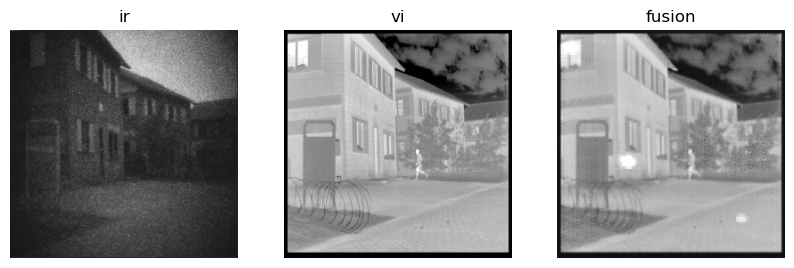

Epoch: 4607 D_epoch_loss: 0.1940404772758484 G_epoch_loss: 2.189269781112671
Epoch: 4608 D_epoch_loss: 0.14200404286384583 G_epoch_loss: 5.663951396942139
Epoch: 4609 D_epoch_loss: 0.12415341287851334 G_epoch_loss: 2.9428884983062744
Epoch: 4610 D_epoch_loss: 0.13815277814865112 G_epoch_loss: 4.782198905944824
Epoch: 4611 D_epoch_loss: 0.10990864783525467 G_epoch_loss: 3.544063091278076
Epoch: 4612 D_epoch_loss: 0.42142120003700256 G_epoch_loss: 1.0839768648147583
Epoch: 4613 D_epoch_loss: 1.3940215110778809 G_epoch_loss: 4.612470626831055
Epoch: 4614 D_epoch_loss: 1.0655415058135986 G_epoch_loss: 4.454624652862549
Epoch: 4615 D_epoch_loss: 1.252428412437439 G_epoch_loss: 0.44678837060928345
Epoch: 4616 D_epoch_loss: 0.7619900107383728 G_epoch_loss: 0.7779046893119812
Epoch: 4617 D_epoch_loss: 0.4621458649635315 G_epoch_loss: 1.1289870738983154
Epoch: 4618 D_epoch_loss: 0.5137699842453003 G_epoch_loss: 1.3547474145889282
Epoch: 4619 D_epoch_loss: 0.6327441334724426 G_epoch_loss: 1.5068

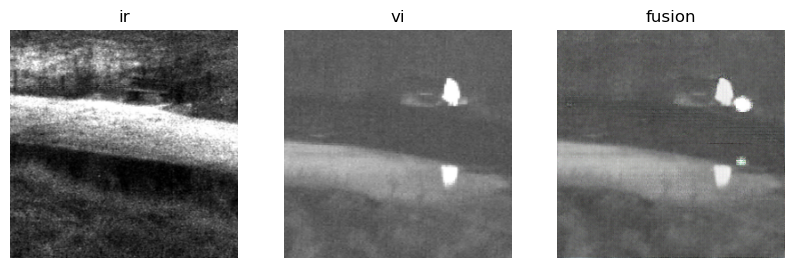

Epoch: 4654 D_epoch_loss: 1.0010018348693848 G_epoch_loss: 0.7489469051361084
Epoch: 4655 D_epoch_loss: 0.8155406713485718 G_epoch_loss: 1.6400395631790161
Epoch: 4656 D_epoch_loss: 0.8242239952087402 G_epoch_loss: 1.1788115501403809
Epoch: 4657 D_epoch_loss: 0.8331652283668518 G_epoch_loss: 1.1480742692947388
Epoch: 4658 D_epoch_loss: 0.8389469385147095 G_epoch_loss: 1.6534245014190674
Epoch: 4659 D_epoch_loss: 0.8649367094039917 G_epoch_loss: 0.853999137878418
Epoch: 4660 D_epoch_loss: 0.8482606410980225 G_epoch_loss: 1.6912760734558105
Epoch: 4661 D_epoch_loss: 0.7513866424560547 G_epoch_loss: 1.106525182723999
Epoch: 4662 D_epoch_loss: 0.7593688368797302 G_epoch_loss: 1.2642556428909302
Epoch: 4663 D_epoch_loss: 0.8014006614685059 G_epoch_loss: 1.3340016603469849
Epoch: 4664 D_epoch_loss: 0.9645287990570068 G_epoch_loss: 1.2663898468017578
Epoch: 4665 D_epoch_loss: 0.8297872543334961 G_epoch_loss: 1.588123083114624
Epoch: 4666 D_epoch_loss: 0.8137837648391724 G_epoch_loss: 1.375057

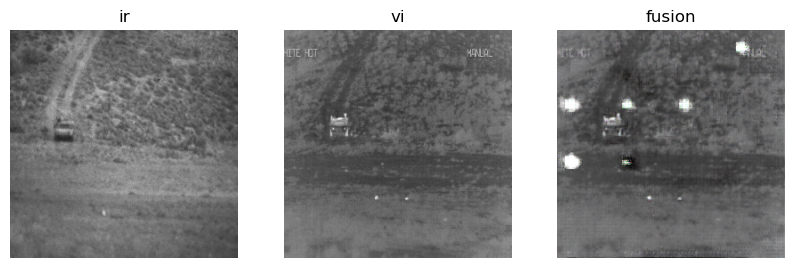

Epoch: 4701 D_epoch_loss: 0.9211914539337158 G_epoch_loss: 1.9827784299850464
Epoch: 4702 D_epoch_loss: 0.8610203266143799 G_epoch_loss: 1.0134567022323608
Epoch: 4703 D_epoch_loss: 0.8185087442398071 G_epoch_loss: 1.4154237508773804
Epoch: 4704 D_epoch_loss: 0.8507720828056335 G_epoch_loss: 1.4345855712890625
Epoch: 4705 D_epoch_loss: 0.8598803281784058 G_epoch_loss: 1.2468186616897583
Epoch: 4706 D_epoch_loss: 0.8518968820571899 G_epoch_loss: 1.3436061143875122
Epoch: 4707 D_epoch_loss: 0.928334653377533 G_epoch_loss: 1.3160892724990845
Epoch: 4708 D_epoch_loss: 0.9244704842567444 G_epoch_loss: 0.7859313488006592
Epoch: 4709 D_epoch_loss: 1.1134145259857178 G_epoch_loss: 2.1456403732299805
Epoch: 4710 D_epoch_loss: 0.49252671003341675 G_epoch_loss: 1.8091295957565308
Epoch: 4711 D_epoch_loss: 0.7978060245513916 G_epoch_loss: 0.9076108336448669
Epoch: 4712 D_epoch_loss: 1.0053991079330444 G_epoch_loss: 1.578856348991394
Epoch: 4713 D_epoch_loss: 0.5610001683235168 G_epoch_loss: 1.6042

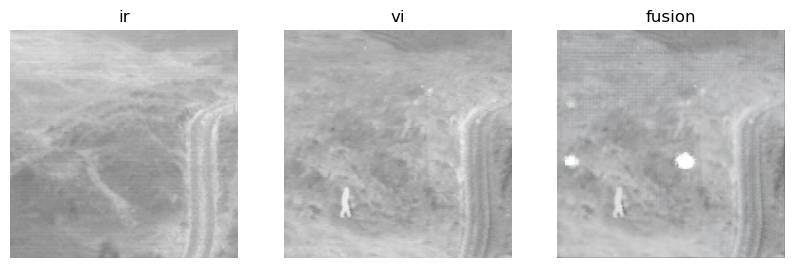

Epoch: 4748 D_epoch_loss: 0.4453631043434143 G_epoch_loss: 1.6558234691619873
Epoch: 4749 D_epoch_loss: 0.6056432127952576 G_epoch_loss: 1.106636881828308
Epoch: 4750 D_epoch_loss: 0.4193421006202698 G_epoch_loss: 1.948095679283142
Epoch: 4751 D_epoch_loss: 0.6001998782157898 G_epoch_loss: 1.1374872922897339
Epoch: 4752 D_epoch_loss: 0.5768249034881592 G_epoch_loss: 1.711981177330017
Epoch: 4753 D_epoch_loss: 0.37581536173820496 G_epoch_loss: 1.6476047039031982
Epoch: 4754 D_epoch_loss: 0.406630277633667 G_epoch_loss: 3.4965097904205322
Epoch: 4755 D_epoch_loss: 0.18486425280570984 G_epoch_loss: 2.716421127319336
Epoch: 4756 D_epoch_loss: 0.5887408256530762 G_epoch_loss: 0.83784019947052
Epoch: 4757 D_epoch_loss: 0.9038150906562805 G_epoch_loss: 1.5643401145935059
Epoch: 4758 D_epoch_loss: 0.27522408962249756 G_epoch_loss: 2.5624587535858154
Epoch: 4759 D_epoch_loss: 0.5526918172836304 G_epoch_loss: 1.2008671760559082
Epoch: 4760 D_epoch_loss: 0.5548847317695618 G_epoch_loss: 1.0139060

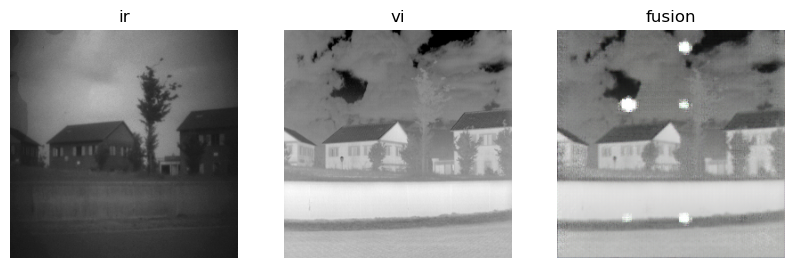

Epoch: 4795 D_epoch_loss: 0.26455312967300415 G_epoch_loss: 2.0863564014434814
Epoch: 4796 D_epoch_loss: 0.28008490800857544 G_epoch_loss: 4.375153541564941
Epoch: 4797 D_epoch_loss: 0.42893198132514954 G_epoch_loss: 1.4550620317459106
Epoch: 4798 D_epoch_loss: 0.5850464701652527 G_epoch_loss: 2.758030414581299
Epoch: 4799 D_epoch_loss: 0.22565212845802307 G_epoch_loss: 6.123885631561279
Epoch: 4800 D_epoch_loss: 0.5790122747421265 G_epoch_loss: 5.9651689529418945
Epoch: 4801 D_epoch_loss: 0.18498770892620087 G_epoch_loss: 2.7026774883270264
Epoch: 4802 D_epoch_loss: 0.6510565280914307 G_epoch_loss: 0.9106968641281128
Epoch: 4803 D_epoch_loss: 0.3511798679828644 G_epoch_loss: 2.1211111545562744
Epoch: 4804 D_epoch_loss: 0.5012979507446289 G_epoch_loss: 1.8475573062896729
Epoch: 4805 D_epoch_loss: 0.3163619339466095 G_epoch_loss: 1.65611732006073
Epoch: 4806 D_epoch_loss: 0.649168074131012 G_epoch_loss: 1.124459147453308
Epoch: 4807 D_epoch_loss: 0.42601072788238525 G_epoch_loss: 1.7436

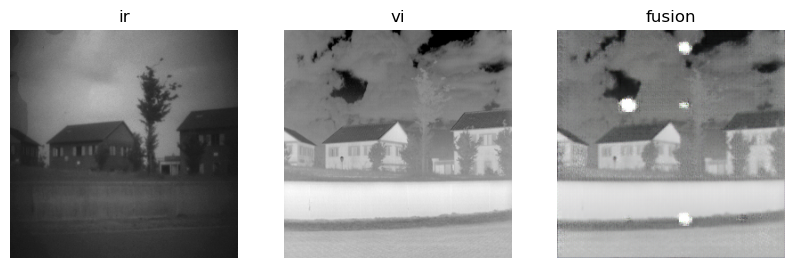

Epoch: 4842 D_epoch_loss: 0.09890563040971756 G_epoch_loss: 5.915216445922852
Epoch: 4843 D_epoch_loss: 0.09211967885494232 G_epoch_loss: 4.782607555389404
Epoch: 4844 D_epoch_loss: 0.14674624800682068 G_epoch_loss: 2.663987636566162
Epoch: 4845 D_epoch_loss: 0.2996196746826172 G_epoch_loss: 1.2965049743652344
Epoch: 4846 D_epoch_loss: 0.19035819172859192 G_epoch_loss: 2.2884774208068848
Epoch: 4847 D_epoch_loss: 0.20937825739383698 G_epoch_loss: 4.901063442230225
Epoch: 4848 D_epoch_loss: 0.2565230131149292 G_epoch_loss: 1.8166656494140625
Epoch: 4849 D_epoch_loss: 0.1991046667098999 G_epoch_loss: 2.57121205329895
Epoch: 4850 D_epoch_loss: 0.1848265379667282 G_epoch_loss: 2.7505640983581543
Epoch: 4851 D_epoch_loss: 0.10139957070350647 G_epoch_loss: 5.575796604156494
Epoch: 4852 D_epoch_loss: 0.10952483117580414 G_epoch_loss: 3.5475289821624756
Epoch: 4853 D_epoch_loss: 0.21882468461990356 G_epoch_loss: 2.0659804344177246
Epoch: 4854 D_epoch_loss: 0.39659616351127625 G_epoch_loss: 1.1

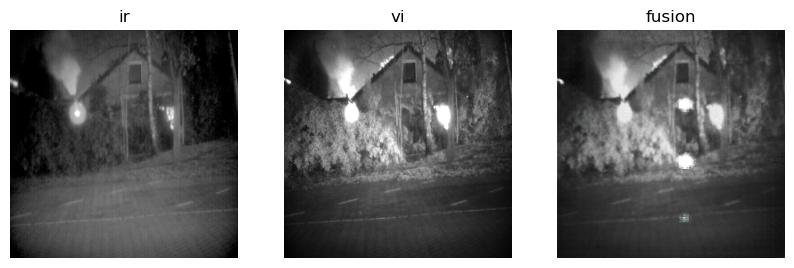

Epoch: 4889 D_epoch_loss: 0.6110196113586426 G_epoch_loss: 0.8271262645721436
Epoch: 4890 D_epoch_loss: 0.6244264841079712 G_epoch_loss: 2.0187265872955322
Epoch: 4891 D_epoch_loss: 0.7544539570808411 G_epoch_loss: 0.6081913709640503
Epoch: 4892 D_epoch_loss: 0.4712759256362915 G_epoch_loss: 1.5646892786026
Epoch: 4893 D_epoch_loss: 0.5938645005226135 G_epoch_loss: 1.836882472038269
Epoch: 4894 D_epoch_loss: 0.3687857985496521 G_epoch_loss: 1.5328937768936157
Epoch: 4895 D_epoch_loss: 0.2080317884683609 G_epoch_loss: 3.344691038131714
Epoch: 4896 D_epoch_loss: 0.6009889245033264 G_epoch_loss: 0.8086365461349487
Epoch: 4897 D_epoch_loss: 0.5639638304710388 G_epoch_loss: 3.559748649597168
Epoch: 4898 D_epoch_loss: 0.09977215528488159 G_epoch_loss: 5.08398962020874
Epoch: 4899 D_epoch_loss: 0.1398969441652298 G_epoch_loss: 2.981760263442993
Epoch: 4900 D_epoch_loss: 0.5152034759521484 G_epoch_loss: 0.9386810064315796
Epoch: 4901 D_epoch_loss: 0.3051875829696655 G_epoch_loss: 1.62441885471

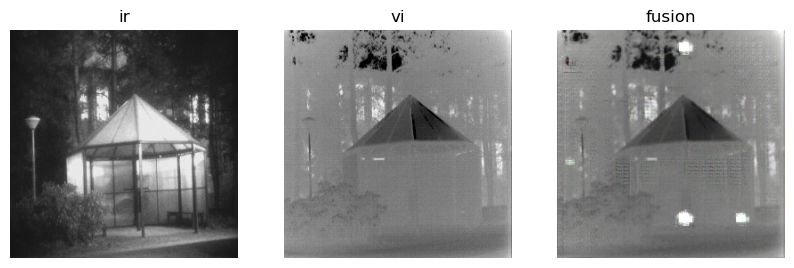

Epoch: 4936 D_epoch_loss: 0.23765252530574799 G_epoch_loss: 1.868803858757019
Epoch: 4937 D_epoch_loss: 0.26125988364219666 G_epoch_loss: 1.7842750549316406
Epoch: 4938 D_epoch_loss: 0.30155065655708313 G_epoch_loss: 1.4958738088607788
Epoch: 4939 D_epoch_loss: 0.8950266242027283 G_epoch_loss: 5.3563642501831055
Epoch: 4940 D_epoch_loss: 0.279607892036438 G_epoch_loss: 4.385020732879639
Epoch: 4941 D_epoch_loss: 0.5962559580802917 G_epoch_loss: 0.7756191492080688
Epoch: 4942 D_epoch_loss: 0.41787129640579224 G_epoch_loss: 1.7007163763046265
Epoch: 4943 D_epoch_loss: 0.2894660532474518 G_epoch_loss: 1.702497124671936
Epoch: 4944 D_epoch_loss: 0.5371794700622559 G_epoch_loss: 1.077309489250183
Epoch: 4945 D_epoch_loss: 0.9776811599731445 G_epoch_loss: 1.6734349727630615
Epoch: 4946 D_epoch_loss: 0.2721646726131439 G_epoch_loss: 1.9874091148376465
Epoch: 4947 D_epoch_loss: 0.6355693340301514 G_epoch_loss: 0.9072580933570862
Epoch: 4948 D_epoch_loss: 0.9071575403213501 G_epoch_loss: 1.2264

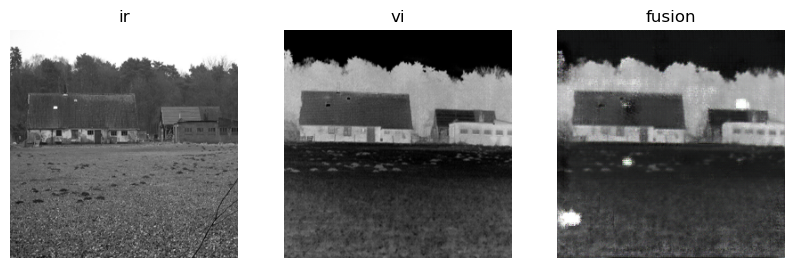

Epoch: 4983 D_epoch_loss: 0.17243872582912445 G_epoch_loss: 2.297611951828003
Epoch: 4984 D_epoch_loss: 0.1274024099111557 G_epoch_loss: 2.80678653717041
Epoch: 4985 D_epoch_loss: 0.1393335610628128 G_epoch_loss: 3.2256391048431396
Epoch: 4986 D_epoch_loss: 0.10493539273738861 G_epoch_loss: 4.056565284729004
Epoch: 4987 D_epoch_loss: 0.1137043684720993 G_epoch_loss: 3.326195001602173
Epoch: 4988 D_epoch_loss: 0.1847655475139618 G_epoch_loss: 2.1692259311676025
Epoch: 4989 D_epoch_loss: 0.15482324361801147 G_epoch_loss: 2.8153674602508545
Epoch: 4990 D_epoch_loss: 0.10382327437400818 G_epoch_loss: 5.035763740539551
Epoch: 4991 D_epoch_loss: 0.09533503651618958 G_epoch_loss: 4.288011074066162
Epoch: 4992 D_epoch_loss: 0.10705199837684631 G_epoch_loss: 3.5397748947143555
Epoch: 4993 D_epoch_loss: 0.09272646903991699 G_epoch_loss: 3.4010767936706543
Epoch: 4994 D_epoch_loss: 0.31060636043548584 G_epoch_loss: 1.3044153451919556
Epoch: 4995 D_epoch_loss: 0.1681245118379593 G_epoch_loss: 4.49

In [21]:
D_loss = []                          # 记录训练过程中判别器loss变化
G_loss = []                          # 记录训练过程中生成器loss变化
res = []
#开始训练
for epoch in range(5000):
    D_epoch_loss=0
    G_epoch_loss=0
    #           vi_img,ir_img
    for step, (real_A, real_B) in enumerate(train_dl):
        real_A = real_A.to(device)
        real_B = real_B.to(device)
        
        # GAN 训练
        gen_optimizer.zero_grad()
        
        # identity loss
        same_B = gen_AB(real_A , real_B)
        identity_B_loss = l1loss_fn(same_B, real_B)
        same_A = gen_BA(real_A , real_B)
        identity_A_loss = l1loss_fn(same_A, real_A)
        
        # GAN loss
        fake_B = gen_AB(real_A,real_B)# 由可见生红外
        D_pred_fake_B = dis_B(real_A,fake_B)
        gan_loss_AB = bceloss_fn(D_pred_fake_B,torch.ones_like(D_pred_fake_B, device=device))
        
        fake_A = gen_BA(real_A,real_B)# 由红外生可见
        D_pred_fake_A = dis_A(fake_A,real_B)
        gan_loss_BA = bceloss_fn(D_pred_fake_A,torch.ones_like(D_pred_fake_A, device=device))
        
        # cycle consistanse loss
        recovered_A = gen_BA(fake_A,fake_B)
        cycle_loss_ABA = l1loss_fn(recovered_A, real_A)
        
        recovered_B = gen_AB(fake_A,fake_B)
        cycle_loss_BAB = l1loss_fn(recovered_B, real_B)
        
        # total_loss
        g_loss = (identity_B_loss + identity_A_loss + gan_loss_AB + gan_loss_BA + cycle_loss_ABA + cycle_loss_BAB)
        
        g_loss.backward()
        gen_optimizer.step()
        
        # dis_A 训练
        dis_A_optimizer.zero_grad()
        dis_A_real_output = dis_A(real_A,real_B)# 判别器输入真实图片
        dis_A_real_loss = bceloss_fn(dis_A_real_output, torch.ones_like(dis_A_real_output, device=device))
        
        dis_A_fake_output = dis_A(fake_A.detach(),fake_B.detach())# 判别器输入生成图片
        dis_A_fake_loss = bceloss_fn(dis_A_fake_output, torch.zeros_like(dis_A_fake_output, device=device))
        
        dis_A_loss = (dis_A_real_loss + dis_A_fake_loss)*0.5
        
        dis_A_loss.backward()
        dis_A_optimizer.step()
        
        
        # dis_B 训练
        dis_B_optimizer.zero_grad()
        dis_B_real_output = dis_B(real_A,real_B)              # 判别器输入真实图片
        dis_B_real_loss = bceloss_fn(dis_B_real_output,torch.ones_like(dis_B_real_output, device=device))
        
        dis_B_fake_output = dis_B(fake_A.detach(),fake_B.detach())              # 判别器输入生成图片
        dis_B_fake_loss = bceloss_fn(dis_B_fake_output,torch.zeros_like(dis_B_fake_output, device=device))
        
        dis_B_loss = (dis_B_real_loss + dis_B_fake_loss)*0.5
        
        dis_B_loss.backward()
        dis_B_optimizer.step()
    
        # 打印 loss 变化
        with torch.no_grad():
            D_epoch_loss += (dis_A_loss + dis_B_loss).item()
            G_epoch_loss += g_loss.item()
    with torch.no_grad():        
        D_epoch_loss /= (step+1)
        G_epoch_loss /= (step+1)
        D_loss.append(D_epoch_loss)
        G_loss.append(G_epoch_loss)
        # 训练完一个Epoch，打印提示并绘制生成的图片
        print("Epoch:", epoch, "D_epoch_loss:", D_epoch_loss, "G_epoch_loss:", G_epoch_loss)
        if epoch%47==0:
            ress = genarate_images(gen_BA,real_A,real_B)
            res.append(ress)

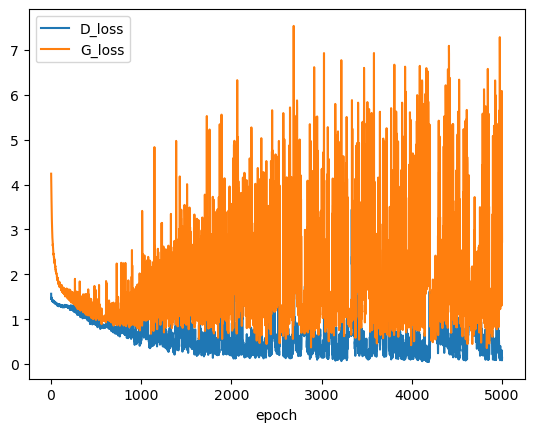

In [22]:
plt.plot(range(1, len(D_loss)+1), D_loss, label='D_loss')
plt.plot(range(1, len(D_loss)+1), G_loss, label='G_loss')
plt.xlabel('epoch')
plt.legend()
plt.show()

In [23]:
import pandas as pd
data = pd.DataFrame()
data['res'] = res
data['Gloss'] = G_loss[len(res)]
data['Dloss'] = D_loss[len(res)]

In [24]:
data.to_excel('excel/04.xlsx')

In [26]:
# 模型参数保存
torch.save(gen_AB.state_dict(), 'w/model_04.pth')